In [1]:
PROJECT_PATH = "/content/drive/MyDrive/Data Analytics for Business/Progetto"

In [2]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import glob
import cv2
from google.colab.patches import cv2_imshow
from keras.models import Model, Sequential
from keras.layers import Dense, Flatten, Conv2D, MaxPooling2D, BatchNormalization
import os
import seaborn as sns
import keras
import pickle
import csv
from matplotlib import image as mp_image

os.environ['TF_CPP_MIN_LOG_LEVEL'] = '3'

from sklearn.metrics import classification_report,confusion_matrix,roc_auc_score, roc_curve,accuracy_score,recall_score
from sklearn.feature_selection import VarianceThreshold,SelectKBest, f_classif
from sklearn.model_selection import train_test_split
from sklearn.utils import class_weight

IMPORT DEL DATASET

In [3]:
from google.colab import drive
drive.mount('/content/drive')

# attualmente il percorso del file zip è /content/drive/MyDrive/Data Analytics for Business/Progetto/archive.zip

Mounted at /content/drive


# Import del dataset di immagini e utils
Estrazione del dataset dal file zip

In [4]:
SIZE = 224  #Resize images
DIM = 3
RECREATE_DATASET = False

In [5]:
import zipfile

'''
# Get the directory containing the zip file
zip_file_path = '/content/drive/MyDrive/Data Analytics for Business/Progetto/archive.zip'
zip_dir = os.path.dirname(zip_file_path)

# Create the destination folder path
dataset_dir = os.path.join(zip_dir, 'dataset')

# Create the destination folder if it doesn't exist
os.makedirs(dataset_dir, exist_ok=True)

# Open the zip file and extract
with zipfile.ZipFile(zip_file_path, 'r') as zip_ref:
    zip_ref.extractall(dataset_dir)
'''

"\n# Get the directory containing the zip file\nzip_file_path = '/content/drive/MyDrive/Data Analytics for Business/Progetto/archive.zip'\nzip_dir = os.path.dirname(zip_file_path)\n\n# Create the destination folder path\ndataset_dir = os.path.join(zip_dir, 'dataset')\n\n# Create the destination folder if it doesn't exist\nos.makedirs(dataset_dir, exist_ok=True)\n\n# Open the zip file and extract\nwith zipfile.ZipFile(zip_file_path, 'r') as zip_ref:\n    zip_ref.extractall(dataset_dir)\n"

In [6]:
def crealista(lista):
  lista=[]
  for i in range(202599):
    i=i+1
    lista.append(f"{i:06d}.jpg")
  return lista

image_files=[]
image_files = crealista(image_files)


In [7]:
len(image_files)

202599

In [8]:
print(image_files[0], image_files[-1])

000001.jpg 202599.jpg


SUDDIVISIONE DELLE IMMAGINI IN VARIE SUBFOLDER PER FACILITARE L'ACCESSO ALLE IMMAGINI DA GOOGLE DRIVE

In [9]:
'''
import os
import shutil

# Define source and destination directories
source_dir = "/content/drive/MyDrive/Data Analytics for Business/Progetto/dataset/img_align_celeba/img_align_celeba"
destination_dir = "/content/drive/MyDrive/Data Analytics for Business/Progetto/dataset/img_align_celeba"
max_files_per_folder = 9000

# Initialize variables for folder numbering and file counter
folder_number = 1
file_counter = 0
current_folder_name = "{:06d}-{:06d}".format(folder_number * max_files_per_folder - max_files_per_folder + 1, folder_number * max_files_per_folder)
current_folder_path = os.path.join(destination_dir, current_folder_name)

# Create the first subfolder
os.makedirs(current_folder_path, exist_ok=True)

# Iterate through image files and move them to subfolders
for i, image_file in enumerate(image_files):
    source_file_path = os.path.join(source_dir, image_file)

    # Check if we need to create a new subfolder
    if file_counter == max_files_per_folder:
      folder_number += 1
      file_counter = 0
      current_folder_name = "{:06d}-{:06d}".format(folder_number * max_files_per_folder - max_files_per_folder + 1, min(folder_number * max_files_per_folder, len(image_files)))
      current_folder_path = os.path.join(destination_dir, current_folder_name)
      os.makedirs(current_folder_path, exist_ok=True)

    destination_file_path = os.path.join(current_folder_path, image_file)
    shutil.move(source_file_path, destination_file_path)
    file_counter +=1
'''


'\nimport os\nimport shutil\n\n# Define source and destination directories\nsource_dir = "/content/drive/MyDrive/Data Analytics for Business/Progetto/dataset/img_align_celeba/img_align_celeba"\ndestination_dir = "/content/drive/MyDrive/Data Analytics for Business/Progetto/dataset/img_align_celeba"\nmax_files_per_folder = 9000\n\n# Initialize variables for folder numbering and file counter\nfolder_number = 1\nfile_counter = 0\ncurrent_folder_name = "{:06d}-{:06d}".format(folder_number * max_files_per_folder - max_files_per_folder + 1, folder_number * max_files_per_folder)\ncurrent_folder_path = os.path.join(destination_dir, current_folder_name)\n\n# Create the first subfolder\nos.makedirs(current_folder_path, exist_ok=True)\n\n# Iterate through image files and move them to subfolders\nfor i, image_file in enumerate(image_files):\n    source_file_path = os.path.join(source_dir, image_file)\n\n    # Check if we need to create a new subfolder\n    if file_counter == max_files_per_folder:\n

In [10]:
img_folders_path="/content/drive/MyDrive/Data Analytics for Business/Progetto/dataset/img_align_celeba"
print(os.listdir(img_folders_path))

['img_align_celeba', '000001-009000', '009001-018000', '018001-027000', '027001-036000', '036001-045000', '045001-054000', '054001-063000', '063001-072000', '072001-081000', '081001-090000', '090001-099000', '099001-108000', '108001-117000', '117001-126000', '126001-135000', '135001-144000', '144001-153000', '153001-162000', '162001-171000', '171001-180000', '180001-189000', '189001-198000', '198001-202599']


In [11]:
def get_image_by_number(image_number):
    """Restituisce il percorso dell'immagine dato il suo numero, cercandola nelle cartelle."""
    for folder_name in sorted(os.listdir(img_folders_path)):
        folder_path = os.path.join(img_folders_path, folder_name)

        if not os.path.isdir(folder_path):
            continue

        parts = folder_name.split('-')
        if len(parts) != 2 or not all(part.isdigit() for part in parts):
            # Salta nomi cartella non validi
            continue

        start, end = map(int, parts)
        if start <= image_number <= end:
            image_filename = f"{image_number:06d}.jpg"
            image_path = os.path.join(folder_path, image_filename)
            return image_path if os.path.exists(image_path) else None

    return None  # Non trovato

In [12]:
def print_image(image_number):
    """Mostra l'immagine dato il suo numero."""
    image_path = get_image_by_number(image_number)

    if image_path and os.path.exists(image_path):
        img = cv2.imread(image_path)
        if img is not None:
            # Use matplotlib to display the image instead of cv2_imshow and waitKey
            plt.imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))  # Convert BGR to RGB for matplotlib
            plt.show()
        else:
            print(f"Errore: Immagine non caricabile da {image_path}")
    else:
        print(f"Errore: Immagine non trovata per il numero {image_number}")

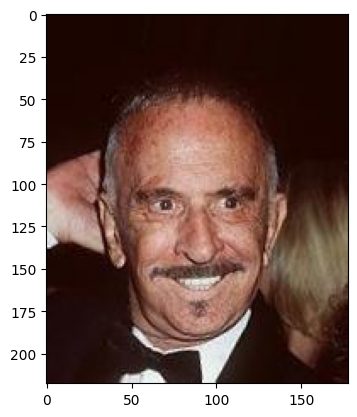

In [13]:
print_image(209)

## Preprocessing CSV

In [14]:
'''
Inserire nella variabile PATHCSV il path del csv sul proprio drive
'''
PATHCSV="/content/drive/MyDrive/Data Analytics for Business/Progetto/dataset/list_attr_celeba.csv"
attr_prima= pd.read_csv(PATHCSV)

In [15]:
attr_prima.head()

,image_id,5_o_Clock_Shadow,Arched_Eyebrows,Attractive,Bags_Under_Eyes,Bald,Bangs,Big_Lips,Big_Nose,Black_Hair,...,Sideburns,Smiling,Straight_Hair,Wavy_Hair,Wearing_Earrings,Wearing_Hat,Wearing_Lipstick,Wearing_Necklace,Wearing_Necktie,Young
0,000001.jpg,-1,1,1,-1,-1,-1,-1,-1,-1,...,-1,1,1,-1,1,-1,1,-1,-1,1
1,000002.jpg,-1,-1,-1,1,-1,-1,-1,1,-1,...,-1,1,-1,-1,-1,-1,-1,-1,-1,1
2,000003.jpg,-1,-1,-1,-1,-1,-1,1,-1,-1,...,-1,-1,-1,1,-1,-1,-1,-1,-1,1
3,000004.jpg,-1,-1,1,-1,-1,-1,-1,-1,-1,...,-1,-1,1,-1,1,-1,1,1,-1,1
4,000005.jpg,-1,1,1,-1,-1,-1,1,-1,-1,...,-1,-1,-1,-1,-1,-1,1,-1,-1,1


In [16]:
attr_prima.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 202599 entries, 0 to 202598
Data columns (total 41 columns):
 #   Column               Non-Null Count   Dtype 
---  ------               --------------   ----- 
 0   image_id             202599 non-null  object
 1   5_o_Clock_Shadow     202599 non-null  int64 
 2   Arched_Eyebrows      202599 non-null  int64 
 3   Attractive           202599 non-null  int64 
 4   Bags_Under_Eyes      202599 non-null  int64 
 5   Bald                 202599 non-null  int64 
 6   Bangs                202599 non-null  int64 
 7   Big_Lips             202599 non-null  int64 
 8   Big_Nose             202599 non-null  int64 
 9   Black_Hair           202599 non-null  int64 
 10  Blond_Hair           202599 non-null  int64 
 11  Blurry               202599 non-null  int64 
 12  Brown_Hair           202599 non-null  int64 
 13  Bushy_Eyebrows       202599 non-null  int64 
 14  Chubby               202599 non-null  int64 
 15  Double_Chin          202599 non-nu

Tramite l'attributo `.info()` possiamo notare che non vi sono valori null per nessuna delle feature all'interno del dataframe

Il csv contiene 40 feature le quali sono tutte binarie, ma i cui formati sono in type int64, dove -1 sta per 0 ovvero valore binario neagativo e 1 sta per 1 valore binario positivo.

Bisogna convertire queste feature sostituendo con -1 il valore 0

In [17]:
def transform_to_zero(column, dataset):
  dataset[column]=dataset[column].replace(-1,0)

attr_original_df=attr_prima.copy()

for column in attr_original_df.columns:
  transform_to_zero(column, attr_original_df)

In [18]:
attr_original_df

,image_id,5_o_Clock_Shadow,Arched_Eyebrows,Attractive,Bags_Under_Eyes,Bald,Bangs,Big_Lips,Big_Nose,Black_Hair,...,Sideburns,Smiling,Straight_Hair,Wavy_Hair,Wearing_Earrings,Wearing_Hat,Wearing_Lipstick,Wearing_Necklace,Wearing_Necktie,Young
0,000001.jpg,0,1,1,0,0,0,0,0,0,...,0,1,1,0,1,0,1,0,0,1
1,000002.jpg,0,0,0,1,0,0,0,1,0,...,0,1,0,0,0,0,0,0,0,1
2,000003.jpg,0,0,0,0,0,0,1,0,0,...,0,0,0,1,0,0,0,0,0,1
3,000004.jpg,0,0,1,0,0,0,0,0,0,...,0,0,1,0,1,0,1,1,0,1
4,000005.jpg,0,1,1,0,0,0,1,0,0,...,0,0,0,0,0,0,1,0,0,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
202594,202595.jpg,0,0,1,0,0,0,1,0,0,...,0,0,0,0,0,0,1,0,0,1
202595,202596.jpg,0,0,0,0,0,1,1,0,0,...,0,1,1,0,0,0,0,0,0,1
202596,202597.jpg,0,0,0,0,0,0,0,0,1,...,0,1,0,0,0,0,0,0,0,1
202597,202598.jpg,0,1,1,0,0,0,1,0,1,...,0,1,0,1,1,0,1,0,0,1


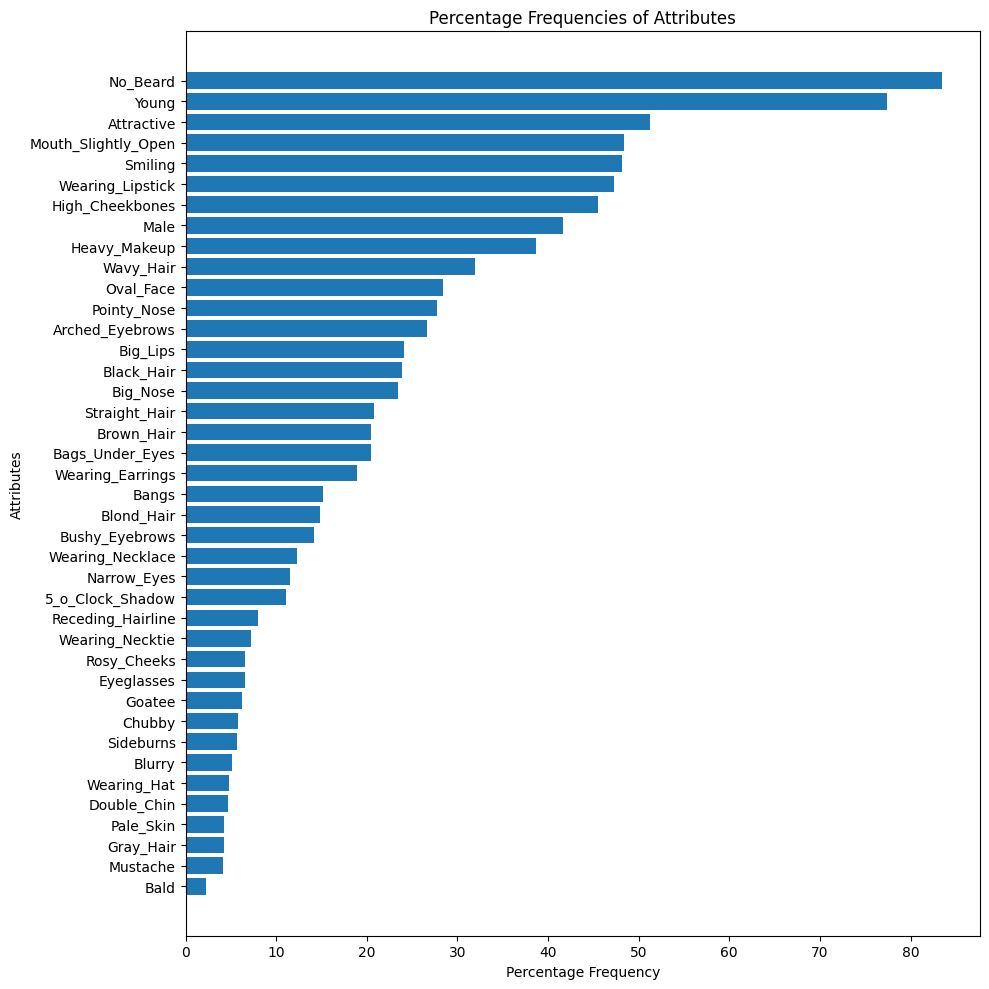

In [19]:
attribute_frequencies = attr_original_df.drop(columns=['image_id']).sum() / len(attr_original_df) * 100

# Sort in descending order
attribute_frequencies = attribute_frequencies.sort_values(ascending=False)

# Create the horizontal bar chart
plt.figure(figsize=(10, 10))  # Adjust figure size for better readability
plt.barh(attribute_frequencies.index, attribute_frequencies.values)
plt.xlabel("Percentage Frequency")
plt.ylabel("Attributes")
plt.title("Percentage Frequencies of Attributes")
plt.gca().invert_yaxis()  # Invert y-axis for descending order
plt.tight_layout() # Adjust layout to prevent labels from overlapping
plt.show()

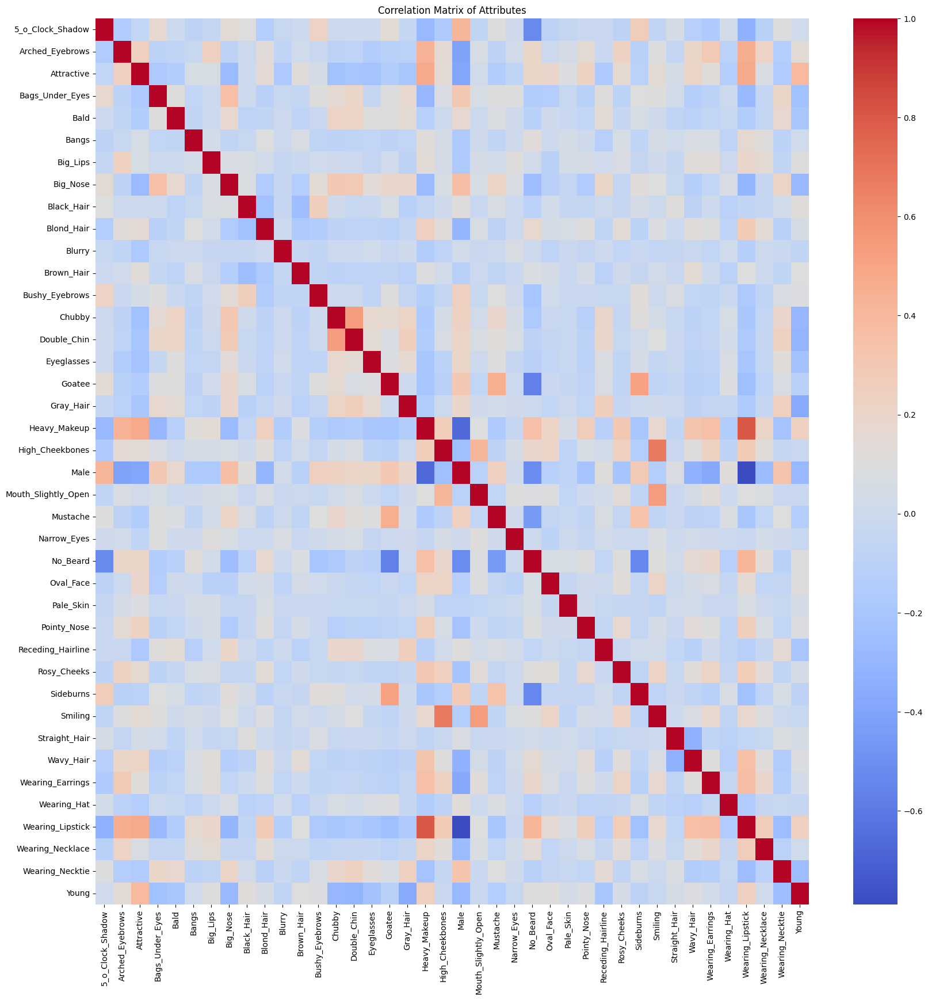

In [20]:
attr_corr = attr_original_df.drop('image_id', axis=1)

correlation_matrix = attr_corr.corr()

plt.figure(figsize=(20, 20))
sns.heatmap(correlation_matrix, annot=False, cmap='coolwarm', fmt=".2f")
plt.title("Correlation Matrix of Attributes")
plt.show()


In [21]:
attr_original_df.head()

,image_id,5_o_Clock_Shadow,Arched_Eyebrows,Attractive,Bags_Under_Eyes,Bald,Bangs,Big_Lips,Big_Nose,Black_Hair,...,Sideburns,Smiling,Straight_Hair,Wavy_Hair,Wearing_Earrings,Wearing_Hat,Wearing_Lipstick,Wearing_Necklace,Wearing_Necktie,Young
0,000001.jpg,0,1,1,0,0,0,0,0,0,...,0,1,1,0,1,0,1,0,0,1
1,000002.jpg,0,0,0,1,0,0,0,1,0,...,0,1,0,0,0,0,0,0,0,1
2,000003.jpg,0,0,0,0,0,0,1,0,0,...,0,0,0,1,0,0,0,0,0,1
3,000004.jpg,0,0,1,0,0,0,0,0,0,...,0,0,1,0,1,0,1,1,0,1
4,000005.jpg,0,1,1,0,0,0,1,0,0,...,0,0,0,0,0,0,1,0,0,1


In [22]:
attr_original_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 202599 entries, 0 to 202598
Data columns (total 41 columns):
 #   Column               Non-Null Count   Dtype 
---  ------               --------------   ----- 
 0   image_id             202599 non-null  object
 1   5_o_Clock_Shadow     202599 non-null  int64 
 2   Arched_Eyebrows      202599 non-null  int64 
 3   Attractive           202599 non-null  int64 
 4   Bags_Under_Eyes      202599 non-null  int64 
 5   Bald                 202599 non-null  int64 
 6   Bangs                202599 non-null  int64 
 7   Big_Lips             202599 non-null  int64 
 8   Big_Nose             202599 non-null  int64 
 9   Black_Hair           202599 non-null  int64 
 10  Blond_Hair           202599 non-null  int64 
 11  Blurry               202599 non-null  int64 
 12  Brown_Hair           202599 non-null  int64 
 13  Bushy_Eyebrows       202599 non-null  int64 
 14  Chubby               202599 non-null  int64 
 15  Double_Chin          202599 non-nu

#Approccio baseline
Questo consiste nel primo approccio adottato nel progetto.

## Feature Selection

Per feature binarie la varianza viene calcolata come $p(1-p)$ dove $p$ è la proporzione di uno dei due elementi.
Un valore vicino a 0.25 indica un bilanciamento nella feature, un valore prossimo a 0 indica uno sbilanciamento nella feature

In [23]:
variance_by_feature = attr_original_df.drop('image_id', axis=1).var()

variance_by_feature.sort_values(ascending=False)


,0
Attractive,0.249845
Mouth_Slightly_Open,0.249727
Smiling,0.249680
Wearing_Lipstick,0.249241
High_Cheekbones,0.247979
Male,0.243071
Heavy_Makeup,0.237215
Wavy_Hair,0.217445
Oval_Face,0.203407
Pointy_Nose,0.200470


In [24]:
if 'image_id' not in attr_original_df.columns:
    raise ValueError("La colonna 'image_id' non è presente nel DataFrame originale!")
image_id_column = attr_original_df['image_id']

# DataFrame contenente solo le feature per la selezione
df_features_only = attr_original_df.drop('image_id', axis=1)
original_feature_names = df_features_only.columns.tolist()

print(f"DataFrame originale delle feature (prime 5 righe):\n{df_features_only.head()}")
print(f"Numero totale di feature originali: {len(original_feature_names)}")
# variance_by_feature = df_features_only.var().sort_values(ascending=False) # Già visto
print("-" * 40)


# --- PASSO 1: RIMOZIONE FEATURE A BASSA VARIANZA ---
print("\n--- PASSO 1: Rimozione Feature a Bassa Varianza ---")
threshold_variance = 0.05 * (1 - 0.05)
print(f"Soglia di varianza scelta: {threshold_variance:.4f}")

selector_variance = VarianceThreshold(threshold=threshold_variance)
selector_variance.fit(df_features_only)
features_kept_mask_variance = selector_variance.get_support()
feature_names_after_variance_thresh = df_features_only.columns[features_kept_mask_variance].tolist()

print(f"\nNumero di feature dopo VarianceThreshold: {len(feature_names_after_variance_thresh)}")
df_attr_variance_selected = df_features_only[feature_names_after_variance_thresh]
print(f"Shape del DataFrame dopo VarianceThreshold: {df_attr_variance_selected.shape}")
print("-" * 40)


# --- PASSO 2: ANALISI E RIMOZIONE CORRELAZIONE ---
print("\n--- PASSO 2: Analisi e Rimozione Correlazione (Opzionale) ---")
APPLY_CORRELATION_FILTER = True
correlation_threshold = 0.90

df_attr_selected_features = df_attr_variance_selected # Inizializza con il risultato del passo precedente

if APPLY_CORRELATION_FILTER and not df_attr_variance_selected.empty:
    print(f"Applicazione filtro correlazione con soglia: > {correlation_threshold}")
    corr_matrix = df_attr_variance_selected.corr().abs()
    upper_triangle = corr_matrix.where(np.triu(np.ones(corr_matrix.shape), k=1).astype(bool))
    columns_to_drop_corr = set()
    for column in upper_triangle.columns:
        if column in columns_to_drop_corr:
            continue
        highly_correlated_with_column = upper_triangle[upper_triangle[column] > correlation_threshold].index
        if not highly_correlated_with_column.empty:
            # Per semplicità, scartiamo le feature che appaiono come indice
            # (cioè la "seconda" feature della coppia correlata)
            columns_to_drop_corr.update(highly_correlated_with_column.tolist())

    feature_names_after_corr = [feat for feat in df_attr_variance_selected.columns if feat not in columns_to_drop_corr]
    df_attr_selected_features = df_attr_variance_selected[feature_names_after_corr] # Aggiorna il DataFrame

    print(f"\nNumero di feature dopo filtro correlazione: {len(feature_names_after_corr)}")
    print(f"Feature scartate da filtro correlazione: {list(columns_to_drop_corr)}")
    print(f"Shape del DataFrame dopo filtro correlazione: {df_attr_selected_features.shape}")

elif df_attr_variance_selected.empty:
    print("Filtro correlazione saltato: nessuna feature rimasta dopo VarianceThreshold.")
else:
    print("Filtro correlazione saltato come da configurazione.")

print("-" * 40)


# --- PASSO 3: CREAZIONE DEL DATAFRAME FINALE 'attr' ---
print("\n--- PASSO 3: Creazione del DataFrame Finale 'attr' ---")


if image_id_column.index.equals(df_attr_selected_features.index):
    attr = pd.concat([image_id_column, df_attr_selected_features], axis=1)
else:
    print("Attenzione: Indici non allineati tra image_id e feature selezionate. Prova a resettare gli indici.")

    print("Assumo indici allineati e concateno.")
    attr = pd.concat([image_id_column, df_attr_selected_features], axis=1)


print("\nDataFrame finale 'attr' (prime 5 righe):")
print(attr.head())
print(f"Shape del DataFrame finale 'attr': {attr.shape}")
print(f"Colonne in 'attr': {attr.columns.tolist()}")


DataFrame originale delle feature (prime 5 righe):
   5_o_Clock_Shadow  Arched_Eyebrows  Attractive  Bags_Under_Eyes  Bald  \
0                 0                1           1                0     0   
1                 0                0           0                1     0   
2                 0                0           0                0     0   
3                 0                0           1                0     0   
4                 0                1           1                0     0   

   Bangs  Big_Lips  Big_Nose  Black_Hair  Blond_Hair  ...  Sideburns  Smiling  \
0      0         0         0           0           0  ...          0        1   
1      0         0         1           0           0  ...          0        1   
2      0         1         0           0           0  ...          0        0   
3      0         0         0           0           0  ...          0        0   
4      0         1         0           0           0  ...          0        0   

   Straight

In [25]:
attr.head()

,image_id,5_o_Clock_Shadow,Arched_Eyebrows,Attractive,Bags_Under_Eyes,Bangs,Big_Lips,Big_Nose,Black_Hair,Blond_Hair,...,Rosy_Cheeks,Sideburns,Smiling,Straight_Hair,Wavy_Hair,Wearing_Earrings,Wearing_Lipstick,Wearing_Necklace,Wearing_Necktie,Young
0,000001.jpg,0,1,1,0,0,0,0,0,0,...,0,0,1,1,0,1,1,0,0,1
1,000002.jpg,0,0,0,1,0,0,1,0,0,...,0,0,1,0,0,0,0,0,0,1
2,000003.jpg,0,0,0,0,0,1,0,0,0,...,0,0,0,0,1,0,0,0,0,1
3,000004.jpg,0,0,1,0,0,0,0,0,0,...,0,0,0,1,0,1,1,1,0,1
4,000005.jpg,0,1,1,0,0,1,0,0,0,...,0,0,0,0,0,0,1,0,0,1


## Clustering
Creazione di cluster a partire da:

*  Immagini: Per il clustering basato sulle immagini questo approccio utilizza degli embedding generati in locale tramite un modello pre-addestrato chiamato FaceNet
*  File csv: per il clustering basato sul csv questo approccio utilizza il dataset originale insieme ad alcune tecniche di dimensionality reduction come PCA, su cui sono stati effettuati diversi esperimenti


In [26]:
PLOT_SCATTER_GRAPHS = True #Variabile globale per decidere se generare i grafici e calcolare silhouette score
VISUALIZE_SAMPLE_ONLY = True #Variabile globale per visualizzare solo un campione negli scattere plot, per questioni computazionali

### Clustering su immagini

In [27]:
# print(os.listdir(img_path))

In [28]:
''''
def preprocess_img(img):
    return img

def save_embeddings(embeddings, image_ids):
    np.save(os.path.join(PROJECT_PATH, "embeddings.npy"), embeddings)
    np.save(os.path.join(PROJECT_PATH, "filenames.npy"), image_ids)

def load_embeddings():
    embeddings = np.load(os.path.join(PROJECT_PATH, "embeddings.npy"))
    filenames = np.load(os.path.join(PROJECT_PATH, "filenames.npy"))
    return embeddings, filenames

def build_embedding_dataset(img_path, size, preprocessing=True):
    dataset = []
    image_ids = []

    for img_name in os.listdir(img_path):
        img_path = os.path.join(img_path, img_name)
        img = cv2.imread(img_path, cv2.IMREAD_COLOR)

        if img is not None:
            img = cv2.resize(img, (size, size), interpolation=cv2.INTER_LINEAR)
            if preprocessing:
                img = preprocess_img(img)
            img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
            dataset.append(img)
            filenames.append(img_name.split('.')[0])  # prende solo l'image_id senza estensione

    return np.array(dataset), np.array(filenames)

def check_and_create_embeddings(recreate, preprocessing):
    if recreate == True:
        embeddings, filenames = build_embedding_dataset(img_path, SIZE, preprocessing=preprocessing)
        save_embeddings(embeddings, filenames)
    else:
        embeddings, filenames = load_embeddings()

    return embeddings, filenames
'''


'\'\ndef preprocess_img(img):\n    return img\n\ndef save_embeddings(embeddings, image_ids):\n    np.save(os.path.join(PROJECT_PATH, "embeddings.npy"), embeddings)\n    np.save(os.path.join(PROJECT_PATH, "filenames.npy"), image_ids)\n\ndef load_embeddings():\n    embeddings = np.load(os.path.join(PROJECT_PATH, "embeddings.npy"))\n    filenames = np.load(os.path.join(PROJECT_PATH, "filenames.npy"))\n    return embeddings, filenames\n\ndef build_embedding_dataset(img_path, size, preprocessing=True):\n    dataset = []\n    image_ids = []\n\n    for img_name in os.listdir(img_path):\n        img_path = os.path.join(img_path, img_name)\n        img = cv2.imread(img_path, cv2.IMREAD_COLOR)\n\n        if img is not None:\n            img = cv2.resize(img, (size, size), interpolation=cv2.INTER_LINEAR)\n            if preprocessing:\n                img = preprocess_img(img)\n            img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)\n            dataset.append(img)\n            filenames.append(im

In [29]:
#check_and_create_embeddings(RECREATE_DATASET, True)

In [30]:
import kagglehub

# Download latest version
path = kagglehub.model_download("faiqueali/facenet-tensorflow/tensorFlow2/default")

print("Path to model files:", path)


  0%|          | 0.00/987k [00:00<?, ?B/s]



  0%|          | 0.00/6.90M [00:00<?, ?B/s]




  0%|          | 0.00/87.3M [00:00<?, ?B/s]





100%|██████████| 54.0/54.0 [00:00<00:00, 72.8kB/s]






100%|██████████| 31.3k/31.3k [00:00<00:00, 1.10MB/s]

100%|██████████| 987k/987k [00:01<00:00, 751kB/s]


 14%|█▍        | 1.00M/6.90M [00:01<00:07, 781kB/s]


  1%|          | 1.00M/87.3M [00:01<01:55, 785kB/s]

 29%|██▉       | 2.00M/6.90M [00:01<00:03, 1.52MB/s]


  2%|▏         | 2.00M/87.3M [00:01<00:58, 1.53MB/s]

 43%|████▎     | 3.00M/6.90M [00:01<00:01, 2.41MB/s]


  3%|▎         | 3.00M/87.3M [00:01<00:36, 2.43MB/s]

 72%|███████▏  | 5.00M/6.90M [00:01<00:00, 4.45MB/s]


  6%|▌         | 5.00M/87.3M [00:01<00:19, 4.48MB/s]

100%|██████████| 6.90M/6.90M [00:01<00:00, 3.66MB/s]



  8%|▊         | 7.00M/87.3M [00:01<00:12, 6.86MB/s]


 10%|█         | 9.00M/87.3M [00:02<00:09, 8.82MB/s]


 13%|█▎        | 11.0M/87.3M [00:02<00:07, 11.1MB/s]


 15%|█▍        | 13.0M/87.3M [00:02<00:06, 12.2MB/s]


 17%|█▋        | 15.0M/87.3M [00:02<00:05, 13.8MB/s]


 19%|█▉        | 17.0M/87.3M [00:02<00:04, 15.1MB/s]


 22%|██▏       | 19.0M/87.3M [00:02<00:04, 16.1MB/s]


 24%|██▍      

Path to model files: /root/.cache/kagglehub/models/faiqueali/facenet-tensorflow/tensorFlow2/default/2


In [31]:
import tensorflow as tf

from tqdm import tqdm
from keras.layers import TFSMLayer  # IMPORTANTE: caricare modello .pb SavedModel

# --- CONFIGURAZIONE ---
CREATE_DATASET = False  # <<< Cambia qui se vuoi rigenerare o solo caricare
PROJECT_PATH = "/content/drive/MyDrive/Data Analytics for Business/Progetto"
SAVE_PATH = PROJECT_PATH
IMG_FOLDERS_PATH = os.path.join(PROJECT_PATH, 'dataset/img_align_celeba')

# Percorso al modello scaricato da kagglehub (ATTENZIONE: cartella, non file)
FACENET_MODEL_PATH = path

# --- Funzione di accesso immagini dal numero ---
def get_image_by_number(image_number):
    for folder_name in sorted(os.listdir(IMG_FOLDERS_PATH)):
        folder_path = os.path.join(IMG_FOLDERS_PATH, folder_name)
        if not os.path.isdir(folder_path):
            continue
        parts = folder_name.split('-')
        if len(parts) != 2 or not all(part.isdigit() for part in parts):
            continue
        start, end = map(int, parts)
        if start <= image_number <= end:
            image_filename = f"{image_number:06d}.jpg"
            image_path = os.path.join(folder_path, image_filename)
            return image_path if os.path.exists(image_path) else None
    return None

# --- Funzione di preprocessing immagine per FaceNet ---
def preprocess_image_for_facenet(img_path):
    img = cv2.imread(img_path)
    if img is None:
        return None
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    img = cv2.resize(img, (160, 160))  # FaceNet aspetta immagini 160x160
    img = img.astype(np.float32)
    mean, std = img.mean(), img.std()
    img = (img - mean) / (std + 1e-6)  # Standardizzazione zero-mean, unit-variance
    return img


# --- Funzione per Generare gli Embeddings (CON DEBUG) ---
def generate_embeddings(model, image_numbers, save_path, batch_size=32):
    embeddings = []
    filenames = []

    if not os.path.exists(save_path):
        os.makedirs(save_path, exist_ok=True)

    batch_imgs = []
    batch_names = []

    for image_number in tqdm(image_numbers, desc="Generating embeddings"):
        img_path = get_image_by_number(image_number)
        if img_path is None:
            # print(f"Skipping image {image_number}: Path not found.") # Decommenta se vuoi vedere gli skip
            continue

        img = preprocess_image_for_facenet(img_path)
        if img is None:
            # print(f"Skipping image {image_number}: Preprocessing failed.") # Decommenta se vuoi vedere gli skip
            continue

        batch_imgs.append(img)
        batch_names.append(f"{image_number:06d}.jpg")

        # Processa il batch quando è pieno
        if len(batch_imgs) == batch_size:
            batch_np = np.array(batch_imgs)
            batch_tensor = tf.convert_to_tensor(batch_np, dtype=tf.float32)

            # ---- DEBUG: Stampa l'output del modello ----
            try:
                model_output = model(batch_tensor, training=False)
                print("\n--- DEBUG: Output del Modello (batch pieno) ---")
                print(f"Tipo dell'output: {type(model_output)}")
                print("Output:", model_output)
                if isinstance(model_output, dict):
                     print("Chiavi disponibili:", model_output.keys())
                print("---------------------------------------------\n")
            except Exception as e:
                 print(f"\n--- DEBUG: Errore durante la chiamata al modello (batch pieno): {e} ---\n")
                 model_output = None # Imposta a None per evitare errori successivi
            # ------------------------------------------

            # Ora prova ad accedere alla chiave (o all'output diretto)
            try:
                if isinstance(model_output, dict) and 'embeddings' in model_output:
                     batch_emb = model_output['embeddings'].numpy()
                elif isinstance(model_output, tf.Tensor): # Se l'output è direttamente un tensore
                     batch_emb = model_output.numpy()
                elif isinstance(model_output, dict) and len(model_output) == 1: # Se è un dict con una sola chiave
                     # Prova a prendere il valore dell'unica chiave
                     first_key = list(model_output.keys())[0]
                     print(f"--- DEBUG: Trovata una sola chiave '{first_key}', provo ad usarla per gli embeddings ---")
                     batch_emb = model_output[first_key].numpy()
                else:
                     print("--- DEBUG: Struttura output non riconosciuta o chiave 'embeddings' mancante. Salto questo batch. ---")
                     batch_emb = [] # Salta questo batch se non sappiamo come estrarre

            except Exception as e:
                print(f"--- DEBUG: Errore nell'estrazione degli embeddings (batch pieno): {e} ---")
                batch_emb = []

            if len(batch_emb) > 0:
                embeddings.extend(batch_emb)
                filenames.extend(batch_names)

            # Resetta il batch
            batch_imgs = []
            batch_names = []

    # Processa l'ultimo batch rimanente (se esiste)
    if batch_imgs:
        batch_np = np.array(batch_imgs)
        batch_tensor = tf.convert_to_tensor(batch_np, dtype=tf.float32)
         # ---- DEBUG: Stampa l'output del modello ----
        try:
            model_output = model(batch_tensor, training=False)
            print("\n--- DEBUG: Output del Modello (ultimo batch) ---")
            print(f"Tipo dell'output: {type(model_output)}")
            print("Output:", model_output)
            if isinstance(model_output, dict):
                print("Chiavi disponibili:", model_output.keys())
            print("-------------------------------------------\n")
        except Exception as e:
             print(f"\n--- DEBUG: Errore durante la chiamata al modello (ultimo batch): {e} ---\n")
             model_output = None
        # ------------------------------------------

        try:
            if isinstance(model_output, dict) and 'embeddings' in model_output:
                 batch_emb = model_output['embeddings'].numpy()
            elif isinstance(model_output, tf.Tensor):
                 batch_emb = model_output.numpy()
            elif isinstance(model_output, dict) and len(model_output) == 1:
                 first_key = list(model_output.keys())[0]
                 print(f"--- DEBUG: Trovata una sola chiave '{first_key}' nell'ultimo batch, provo ad usarla ---")
                 batch_emb = model_output[first_key].numpy()
            else:
                 print("--- DEBUG: Struttura output non riconosciuta o chiave 'embeddings' mancante nell'ultimo batch. ---")
                 batch_emb = []

        except Exception as e:
            print(f"--- DEBUG: Errore nell'estrazione degli embeddings (ultimo batch): {e} ---")
            batch_emb = []

        if len(batch_emb) > 0:
            embeddings.extend(batch_emb)
            filenames.extend(batch_names)

    # Conversione finale e salvataggio
    if not embeddings: # Se la lista è vuota (nessun embedding estratto)
         print("ATTENZIONE: Nessun embedding è stato generato correttamente.")
         return np.array([]), np.array([])

    embeddings = np.array(embeddings)
    filenames = np.array(filenames)

    # Assicurati che il numero di embeddings corrisponda ai nomi file PRIMA di salvare
    if embeddings.shape[0] != filenames.shape[0]:
         print(f"ERRORE CRITICO INTERNO: Mismatch tra shape embeddings ({embeddings.shape[0]}) e filenames ({filenames.shape[0]}) prima del salvataggio!")
         # Potresti voler gestire questo errore in modo diverso, es. non salvando
         return np.array([]), np.array([]) # Restituisce array vuoti per indicare fallimento

    np.save(os.path.join(save_path, "face_embeddings.npy"), embeddings)
    np.save(os.path.join(save_path, "face_filenames.npy"), filenames)

    print(f"✅ Salvati embeddings: {embeddings.shape} e filenames: {filenames.shape}")
    return embeddings, filenames


In [32]:
# --- Codice principale ---

if CREATE_DATASET:
    print("Caricamento modello FaceNet...")
    facenet_model = TFSMLayer(FACENET_MODEL_PATH, call_endpoint="serving_default")  # <<< TFSMLayer per SavedModel
    print("Modello FaceNet caricato.")

    # Genera lista numeri immagini
    image_numbers = np.arange(1, 202600)  # immagini da 000001.jpg a 202599.jpg
    embeddings, filenames = generate_embeddings(facenet_model, image_numbers, SAVE_PATH)
else:
    print("Caricamento embeddings già esistenti...")
    embeddings = np.load(os.path.join(SAVE_PATH, "face_embeddings.npy"))
    filenames = np.load(os.path.join(SAVE_PATH, "face_filenames.npy"))
    print(f"Embeddings caricati: {embeddings.shape}, Filenames caricati: {filenames.shape}")


Caricamento embeddings già esistenti...
Embeddings caricati: (202599, 128), Filenames caricati: (202599,)


In [33]:
print(filenames[0])

000001.jpg


#### Clustering senza pre-processamento del file embeddings

In [34]:
import collections
import random
from sklearn.cluster import KMeans
from sklearn.manifold import TSNE
from sklearn.decomposition import PCA
from sklearn.metrics import silhouette_score
from PIL import Image



def load_data(embeddings_path, names_path):
    """Loads embeddings and image names from .npy files."""
    print(f"Caricamento embeddings da: {embeddings_path}")
    try:
        embeddings = np.load(embeddings_path)
        print(f"Embeddings caricati. Shape: {embeddings.shape}")
        if len(embeddings.shape) != 2 or embeddings.shape[1] != 128: # Basic check
             print(f"Attenzione: Atteso array 2D con 128 colonne, shape attuale {embeddings.shape}")
        if embeddings.shape[0] == 0:
            raise ValueError("File embeddings vuoto.")
    except FileNotFoundError:
        print(f"Errore: File embeddings non trovato a {embeddings_path}")
        return None, None
    except Exception as e:
        print(f"Errore caricamento embeddings: {e}")
        return None, None

    print(f"Caricamento nomi immagini da: {names_path}")
    try:
        image_names = np.load(names_path, allow_pickle=True)
        print(f"Nomi immagini caricati. Numero: {len(image_names)}")
        if len(image_names) == 0:
             raise ValueError("File nomi vuoto.")
    except FileNotFoundError:
        print(f"Errore: File nomi non trovato a {names_path}")
        return None, None
    except Exception as e:
        print(f"Errore caricamento nomi: {e}")
        return None, None


    if embeddings.shape[0] != len(image_names):
        print(f"Errore Critico: Numero embeddings ({embeddings.shape[0]}) != numero nomi ({len(image_names)})")
        return None, None

    return embeddings, image_names

def perform_kmeans(embeddings, k, random_state, n_init='auto'):
    """Performs K-Means clustering."""
    print(f"\nEsecuzione di K-Means con k={k}...")
    if embeddings.shape[0] < k:
        print(f"Attenzione: Numero campioni ({embeddings.shape[0]}) < k ({k}). Adatto k a {embeddings.shape[0]}.")
        k = embeddings.shape[0]

    kmeans = KMeans(n_clusters=k, random_state=random_state, n_init=n_init)
    cluster_labels = kmeans.fit_predict(embeddings)
    print("Clustering completato.")
    return cluster_labels, k # Return potentially adjusted k

def save_cluster_assignments(image_names, cluster_labels, assignments_path):
    """Saves image names and their corresponding cluster labels to a .npy file."""
    try:
        # Ensure output directory exists
        os.makedirs(os.path.dirname(assignments_path), exist_ok=True)
        # Create 2D array [name, label]
        combined_assignments = np.column_stack((image_names, cluster_labels.astype(str))) # Save labels as strings for compatibility if mixing types
        np.save(assignments_path, combined_assignments)
        print(f"Assegnazioni cluster (nome + label) salvate in: {assignments_path}")
        return True
    except Exception as e:
        print(f"Errore durante il salvataggio delle assegnazioni cluster: {e}")
        return False

def load_cluster_assignments(assignments_path, image_names_current_order):
    """Loads cluster assignments and reconstructs labels and map based on current image name order."""
    print(f"\nCARICAMENTO assegnazioni cluster esistenti da: {assignments_path}")
    try:
        loaded_assignments = np.load(assignments_path, allow_pickle=True) # Names might be objects
        print(f"Assegnazioni caricate. Shape: {loaded_assignments.shape}")

        if loaded_assignments.shape[0] != len(image_names_current_order):
            print(f"Errore: Numero assegnazioni caricate ({loaded_assignments.shape[0]}) != numero embeddings attuali ({len(image_names_current_order)})")
            return None, None, None # Indicate error

        # Create a map from the loaded data
        name_to_label_map = {row[0]: int(row[1]) for row in loaded_assignments}

        # Reconstruct labels in the *current* order of image_names
        cluster_labels = np.array([name_to_label_map.get(name, -1) for name in image_names_current_order])

        # Verify if any names were missing in the loaded assignments
        missing_count = np.sum(cluster_labels == -1)
        if missing_count > 0:
            print(f"Attenzione: {missing_count} nomi immagine correnti non trovati nelle assegnazioni caricate. Lo score potrebbe essere inaccurato.")
            # Decide how to handle: continue, error out, or assign to a default cluster?
            # Current approach: Keep label -1, they will be ignored in counts/sampling.

        print("Etichette cluster (1D int) ricostruite nell'ordine corretto.")

        # Reconstruct cluster_to_names map
        print("Ricostruzione mappa cluster -> nomi...")
        cluster_to_names = collections.defaultdict(list)
        for i, label in enumerate(cluster_labels):
            if label != -1: # Only include valid labels
                cluster_to_names[label].append(image_names_current_order[i])
        print("Mappa cluster -> nomi ricostruita.")

        return cluster_labels, cluster_to_names, collections.Counter(cluster_labels[cluster_labels != -1])

    except FileNotFoundError:
        print(f"Errore: File assegnazioni cluster non trovato ({assignments_path})")
        return None, None, None
    except Exception as e:
        print(f"Errore durante il caricamento delle assegnazioni cluster: {e}")
        return None, None, None


def process_and_save_cluster_results(cluster_labels, image_names, k, output_dir,
                                     print_samples=True, num_samples_print=5,
                                     save_lists=True):
    """Processes clustering results: builds map, counts, prints samples, saves ID lists."""

    if cluster_labels is None:
        print("Errore: Etichette cluster non disponibili per processare i risultati.")
        return None, None

    print("\nAnalisi e salvataggio risultati cluster:")

    # 1. Reconstruct cluster_to_names map (if not already available)
    cluster_to_names = collections.defaultdict(list)
    valid_labels = cluster_labels[cluster_labels != -1] # Exclude potential -1 labels
    valid_image_names = image_names[cluster_labels != -1]
    for i, label in enumerate(valid_labels):
         cluster_to_names[label].append(valid_image_names[i])

    # 2. Count elements per cluster
    cluster_counts = collections.Counter(valid_labels)
    print(f"Numero di elementi per cluster (validi): {sorted(cluster_counts.items())}")

    # 3. Ensure output directory exists if saving lists
    if save_lists:
        try:
            os.makedirs(output_dir, exist_ok=True)
            print(f"Directory di output per liste cluster: {output_dir}")
        except OSError as e:
            print(f"Errore creazione directory {output_dir}: {e}. Salvataggio liste disabilitato.")
            save_lists = False # Disable saving if directory fails

    # 4. Print sample names and save ID lists per cluster
    for cluster_id in range(k): # Iterate up to the original k value
        names_in_cluster = cluster_to_names.get(cluster_id, []) # Use .get for safety
        print(f"\n--- Cluster {cluster_id} ({len(names_in_cluster)} elementi) ---")

        if not names_in_cluster:
            print(" (Cluster vuoto o con solo etichette non valide)")
            continue

        # Print sample names
        if print_samples:
            num_to_print = min(num_samples_print, len(names_in_cluster))
            print(f" Nomi file campione (originali):")
            samples_to_print = random.sample(names_in_cluster, num_to_print) if len(names_in_cluster) > num_to_print else names_in_cluster
            for i in range(num_to_print):
                print(f" - {samples_to_print[i]}")

        # Save numeric IDs to .txt file
        if save_lists and output_dir:
            output_filename = os.path.join(output_dir, f'cluster_{cluster_id}_ids.txt')
            try:
                with open(output_filename, 'w', encoding='utf-8') as f:
                    img_count = 0
                    for img_full_name in names_in_cluster:
                        try:
                            base_name = os.path.basename(str(img_full_name))
                            image_number_str = os.path.splitext(base_name)[0]
                            image_number = int(image_number_str)
                            f.write(str(image_number) + '\n')
                            img_count += 1
                        except ValueError:
                             print(f"  Attenzione: Impossibile estrarre numero da '{img_full_name}', saltato nella lista.")
                        except Exception as e_write:
                             print(f"  Errore scrittura ID per '{img_full_name}': {e_write}")
                    print(f" Lista {img_count} ID numerici salvata in: {output_filename}")
            except Exception as e:
                print(f" Errore salvataggio file cluster {cluster_id}: {e}")

    return cluster_to_names, cluster_counts


def calculate_silhouette(embeddings, cluster_labels, sample_size=None, random_state=None):
    """Calculates the Silhouette Score, optionally on a sample."""
    if cluster_labels is None or embeddings is None:
        print("\nSilhouette Score: Dati insufficienti.")
        return None

    print("\nCalcolo Silhouette Score...")

    valid_indices = np.where(cluster_labels != -1)[0] # Indices with valid labels
    if len(valid_indices) < 2:
        print(" Non abbastanza campioni con etichette valide per calcolare lo score.")
        return None

    embeddings_valid = embeddings[valid_indices]
    labels_valid = cluster_labels[valid_indices]

    # --- Sampling ---
    if sample_size is not None and len(labels_valid) > sample_size:
        if sample_size < 2:
             print(f" Dimensione campione ({sample_size}) troppo piccola, uso tutti i {len(labels_valid)} punti validi.")
             indices_to_use = np.arange(len(labels_valid))
        else:
             print(f" Campionamento di {sample_size} punti su {len(labels_valid)} validi per Silhouette Score...")
             rng = np.random.default_rng(random_state)
             indices_to_use = rng.choice(len(labels_valid), size=sample_size, replace=False)
    else:
        print(f" Utilizzo di tutti i {len(labels_valid)} punti validi per Silhouette Score.")
        indices_to_use = np.arange(len(labels_valid)) # Use all valid points

    if len(indices_to_use) < 2:
         print(" Non abbastanza campioni selezionati (<2) per calcolare lo score.")
         return None

    embeddings_sample = embeddings_valid[indices_to_use]
    labels_sample = labels_valid[indices_to_use]
    num_samples_used = len(labels_sample)

    # --- Score Calculation ---
    try:
        # Check for sufficient unique clusters in the sample
        unique_labels_in_sample = np.unique(labels_sample)
        if len(unique_labels_in_sample) < 2:
            print(f"Errore Silhouette: Solo {len(unique_labels_in_sample)} cluster unico/i presente/i nel campione ({num_samples_used} punti). Impossibile calcolare.")
            return None
        elif len(unique_labels_in_sample) > num_samples_used:
             print(f"Errore Silhouette: Più cluster unici ({len(unique_labels_in_sample)}) che campioni ({num_samples_used}). Qualcosa è errato.")
             return None # Should not happen with correct sampling

        silhouette_avg = silhouette_score(embeddings_sample, labels_sample)
        print(f"Silhouette Score (su {num_samples_used} punti): {silhouette_avg:.4f}")
        return silhouette_avg
    except ValueError as ve:
        print(f"Errore nel calcolo Silhouette Score: {ve}.")
        return None
    except Exception as e:
        print(f"Errore generico nel calcolo Silhouette Score: {e}")
        return None


def reduce_dimensions(embeddings, cluster_labels, method='tsne', sample_size=None, random_state=None, perplexity=30):
    """Reduces embedding dimensions using t-SNE or PCA, optionally on a sample."""
    if cluster_labels is None or embeddings is None:
        print(f"\nRiduzione Dimensionale ({method.upper()}): Dati insufficienti.")
        return None, None

    print(f"\nPreparazione visualizzazione scatter plot usando {method.upper()}...")

    valid_indices = np.where(cluster_labels != -1)[0]
    if len(valid_indices) < 2:
        print(" Non abbastanza campioni con etichette valide per la riduzione dimensionale.")
        return None, None

    embeddings_valid = embeddings[valid_indices]
    labels_valid = cluster_labels[valid_indices]
    num_valid = len(labels_valid)

    # --- Sampling ---
    if sample_size is not None and num_valid > sample_size:
        if sample_size < 2:
            print(f" Dimensione campione ({sample_size}) troppo piccola, uso tutti i {num_valid} punti validi.")
            indices_to_use = np.arange(num_valid)
        else:
            print(f" Campionamento di {sample_size} punti su {num_valid} validi per {method.upper()}...")
            rng = np.random.default_rng(random_state)
            indices_to_use = rng.choice(num_valid, size=sample_size, replace=False)
    else:
        print(f" Utilizzo di tutti i {num_valid} punti validi per {method.upper()}.")
        indices_to_use = np.arange(num_valid) # Use all valid points

    if len(indices_to_use) < 2:
         print(" Non abbastanza campioni selezionati (<2) per la riduzione dimensionale.")
         return None, None

    data_to_reduce = embeddings_valid[indices_to_use]
    labels_for_plot = labels_valid[indices_to_use]
    num_samples_used = len(labels_for_plot)
    plot_title_suffix = f'(Campione di {num_samples_used} punti)'

    # --- Dimensionality Reduction ---
    embeddings_2d = None
    try:
        if method == 'tsne':
            # Adjust perplexity if needed
            effective_perplexity = min(perplexity, num_samples_used - 1)
            if effective_perplexity <= 0:
                 print(f" Errore t-SNE: Numero campioni ({num_samples_used}) troppo piccolo per la perplessità ({perplexity}).")
                 return None, None # Cannot run t-SNE
            if effective_perplexity != perplexity:
                 print(f" Attenzione t-SNE: Perplessità adattata a {effective_perplexity} causa numero campioni ({num_samples_used}).")

            print(f"Esecuzione t-SNE su {num_samples_used} punti (perplessità={effective_perplexity})...")
            reducer = TSNE(n_components=2, random_state=random_state, perplexity=effective_perplexity, n_iter=300) # Faster default iter
            embeddings_2d = reducer.fit_transform(data_to_reduce)
        elif method == 'pca':
            print(f"Esecuzione PCA su {num_samples_used} punti...")
            reducer = PCA(n_components=2, random_state=random_state)
            embeddings_2d = reducer.fit_transform(data_to_reduce)
        else:
            print(f"Errore: Metodo di visualizzazione '{method}' non supportato (usare 'tsne' o 'pca').")
            return None, None

        print("Riduzione dimensionale completata.")
        return embeddings_2d, labels_for_plot, plot_title_suffix

    except Exception as e:
        print(f"Errore durante la riduzione dimensionale ({method.upper()}): {e}")
        return None, None, None


def plot_clusters(embeddings_2d, labels, k, method_name, title_suffix="", output_dir=None):
    """Generates and saves/shows a scatter plot of the 2D embeddings."""
    if embeddings_2d is None or labels is None:
        print("Plotting scatter: Dati 2D o etichette non disponibili.")
        return

    print("Plotting scatter embeddings...")
    try:
        plt.figure(figsize=(12, 10))
        unique_labels_plot = np.unique(labels) # Labels in the actual plotted data
        num_unique_clusters_plot = len(unique_labels_plot)

        # Use a consistent colormap based on the original k
        # Viridis is good for sequential data, but for distinct clusters, a qualitative map might be better if k is small
        # Let's use 'viridis' for now, but consider 'tab10' or 'tab20' if k is suitable.
        cmap = plt.cm.get_cmap('viridis', k)

        scatter = plt.scatter(embeddings_2d[:, 0], embeddings_2d[:, 1], c=labels, cmap=cmap, s=10, alpha=0.7) # Smaller points for dense plots

        # --- Correct Legend ---
        handles = []
        legend_labels = []
        # Create handles only for clusters present in the plot, using the overall colormap
        for label_value in sorted(unique_labels_plot):
             # Calculate color based on the original k range
             normalized_value = label_value / (k - 1) if k > 1 else 0.5
             color = cmap(normalized_value)
             handle = plt.Line2D([0], [0], marker='o', color='w', label=f'Cluster {label_value}',
                                 markerfacecolor=color, markersize=10)
             handles.append(handle)
             legend_labels.append(f'Cluster {label_value}')

        if num_unique_clusters_plot <= 20: # Only show legend if not too many clusters
            plt.legend(handles=handles, labels=legend_labels, title="Clusters")
        else:
            print(f"Troppi cluster ({num_unique_clusters_plot}) nel campione per mostrare legenda.")

        plt.title(f'Visualizzazione Cluster Embeddings (k={k}, PCA_Components={components}) via {method_name.upper()} {title_suffix}')
        plt.xlabel(f'{method_name.upper()} Componente 1')
        plt.ylabel(f'{method_name.upper()} Componente 2')
        plt.grid(True, linestyle='--', alpha=0.5)
        plt.tight_layout()#rect=[0, 0.03, 1, 0.95]) # Adjust if title overlaps axis

        # --- Save Plot ---
        if output_dir:
            try:
                os.makedirs(output_dir, exist_ok=True) # Ensure dir exists
                plot_filename = f'cluster_visualization_{method_name}_k{k}.png'
                scatter_plot_save_path = os.path.join(output_dir, plot_filename)
                plt.savefig(scatter_plot_save_path, dpi=300, bbox_inches='tight')
                print(f"Scatter plot salvato in: {scatter_plot_save_path}")
            except Exception as e_save:
                print(f"Errore durante il salvataggio dello scatter plot: {e_save}")

        plt.show()

    except Exception as e_plot:
        print(f"Errore durante la visualizzazione dello scatter plot: {e_plot}")


def visualize_image_samples(cluster_to_names, k, num_samples_show, get_image_func):
    """Displays a grid of sample images for each cluster."""
    if not cluster_to_names:
        print("\nVisualizzazione Campioni Immagini: Mappa cluster -> nomi non disponibile.")
        return
    if not callable(get_image_func):
        print("\nVisualizzazione Campioni Immagini: Funzione 'get_image_func' non valida.")
        return

    print("\n--- Visualizzazione Campioni Immagini per Cluster ---")

    if num_samples_show <= 0:
        print(" Visualizzazione campioni disabilitata (num_samples_show=0).")
        return

    grid_size = int(np.ceil(np.sqrt(num_samples_show)))
    figsize_val = max(5, grid_size * 2.0) # Adjust figure size dynamically

    for cluster_id in range(k):
        names_in_cluster = cluster_to_names.get(cluster_id, [])
        print(f"\nCluster {cluster_id} ({len(names_in_cluster)} totali):")

        if not names_in_cluster:
            print(" (Vuoto o nessuna immagine valida)")
            continue

        num_to_actually_show = min(num_samples_show, len(names_in_cluster))
        if num_to_actually_show == 0:
            continue

        sample_names_to_show = random.sample(names_in_cluster, num_to_actually_show)

        fig, axes = plt.subplots(grid_size, grid_size, figsize=(figsize_val, figsize_val))
        # Flatten axes array for easy iteration, handle single image case
        if grid_size > 1:
            axes = axes.flatten()
        else:
            axes = [axes] # Make it iterable

        print(f" Mostro {num_to_actually_show} campioni casuali...")
        img_idx = 0
        for img_name in sample_names_to_show:
            ax = axes[img_idx]
            try:
                # 1. Extract image number
                image_number_str = os.path.splitext(str(img_name))[0]
                image_number = int(image_number_str)

                # 2. Get image path using the provided function
                img_path = get_image_func(image_number)

                # 3. Load and display image
                if img_path and os.path.exists(img_path):
                    try:
                        img = Image.open(img_path)
                        ax.imshow(np.array(img))
                        ax.set_title(f"{str(img_name)}", fontsize=8)
                    except Exception as e_img:
                        # Error loading the image file itself
                        ax.text(0.5, 0.5, 'Load Err', ha='center', va='center', fontsize=8)
                        ax.set_title(f"{str(img_name)}", fontsize=8)
                        print(f"  Errore caricamento immagine {img_name} ({img_path}): {e_img}")
                else:
                    # get_image_func returned None or path doesn't exist
                    ax.text(0.5, 0.5, 'Not Found', ha='center', va='center', fontsize=8)
                    ax.set_title(f"{str(img_name)}", fontsize=8)
                    if not img_path:
                         print(f"  Immagine {img_name} (numero {image_number}) non trovata da get_image_func.")
                    else:
                         print(f"  Percorso immagine {img_path} per {img_name} non esiste.")

            except ValueError:
                # Error converting name to number
                ax.text(0.5, 0.5, 'Name Err', ha='center', va='center', fontsize=8)
                ax.set_title(f"{str(img_name)}", fontsize=8)
                print(f"  Attenzione: Impossibile estrarre numero da '{img_name}'.")
            except Exception as e_proc:
                # Any other error during processing this sample
                ax.text(0.5, 0.5, 'Error', ha='center', va='center', fontsize=8)
                ax.set_title(f"{str(img_name)}", fontsize=8)
                print(f"  Errore processando campione '{img_name}': {e_proc}")

            ax.axis('off')
            img_idx += 1

        # Hide unused subplots
        for j in range(img_idx, len(axes)):
            axes[j].axis('off')

        plt.suptitle(f'Campioni Cluster {cluster_id}', fontsize=14)
        # Adjust layout tightly around images
        plt.tight_layout(rect=[0, 0.03, 1, 0.95]) # Leave space for suptitle
        plt.show()

Caricamento embeddings da: /content/drive/MyDrive/Data Analytics for Business/Progetto/face_embeddings.npy
Embeddings caricati. Shape: (202599, 128)
Caricamento nomi immagini da: /content/drive/MyDrive/Data Analytics for Business/Progetto/face_filenames.npy
Nomi immagini caricati. Numero: 202599

CARICAMENTO assegnazioni cluster esistenti da: /content/drive/MyDrive/Data Analytics for Business/Progetto/clusters_output_refactored/image_cluster_assignments.npy
Assegnazioni caricate. Shape: (202599, 2)
Etichette cluster (1D int) ricostruite nell'ordine corretto.
Ricostruzione mappa cluster -> nomi...
Mappa cluster -> nomi ricostruita.

Risultati cluster (mappa nomi, conteggi, liste ID) caricati o già processati.
 Cluster 0 (59750 elem.) Campioni caricati: [np.str_('031641.jpg'), np.str_('002433.jpg'), np.str_('150417.jpg'), np.str_('105835.jpg'), np.str_('058092.jpg')]
 Cluster 1 (24885 elem.) Campioni caricati: [np.str_('139617.jpg'), np.str_('004537.jpg'), np.str_('096480.jpg'), np.str_(

/usr/local/lib/python3.11/dist-packages/sklearn/manifold/_t_sne.py:1164: FutureWarning: 'n_iter' was renamed to 'max_iter' in version 1.5 and will be removed in 1.7.
  warnings.warn(


Riduzione dimensionale completata.
Plotting scatter embeddings...
Errore durante la visualizzazione dello scatter plot: name 'components' is not defined

--- Visualizzazione Campioni Immagini per Cluster ---

Cluster 0 (59750 totali):
 Mostro 9 campioni casuali...


<ipython-input-34-6154877ae3a3>:334: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = plt.cm.get_cmap('viridis', k)


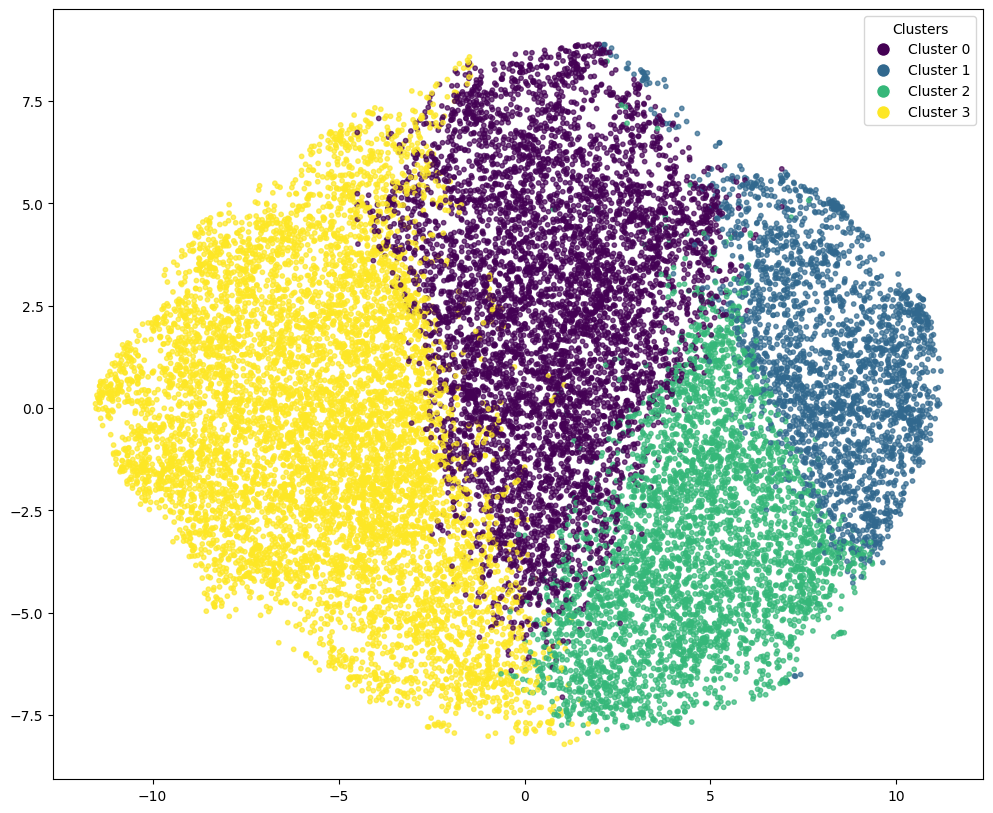

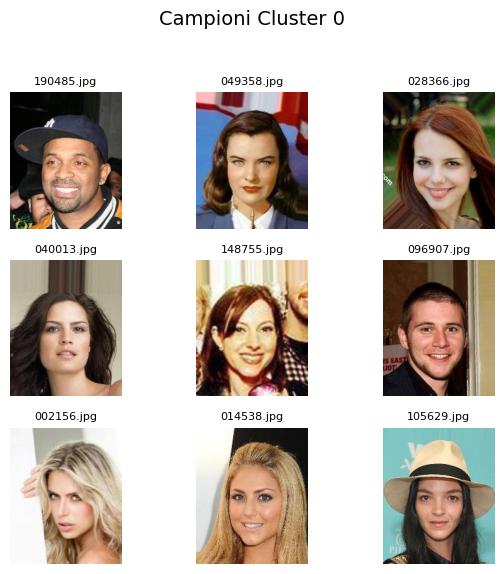


Cluster 1 (24885 totali):
 Mostro 9 campioni casuali...


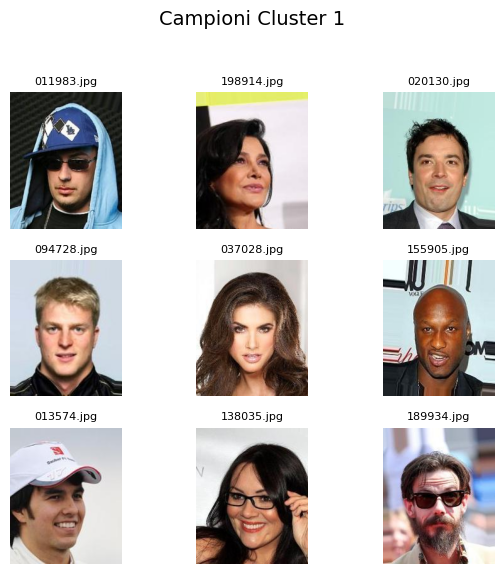


Cluster 2 (39391 totali):
 Mostro 9 campioni casuali...


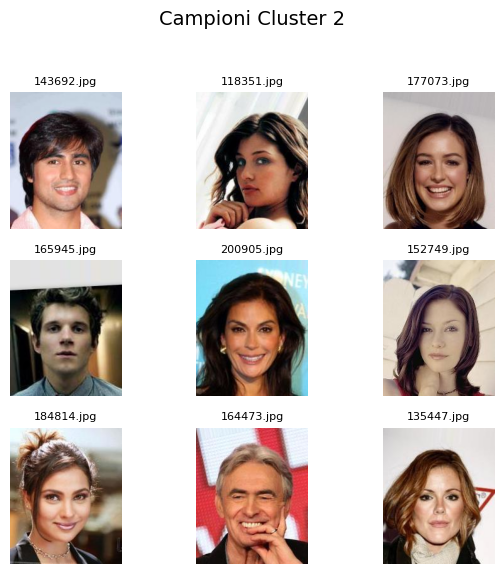


Cluster 3 (78573 totali):
 Mostro 9 campioni casuali...


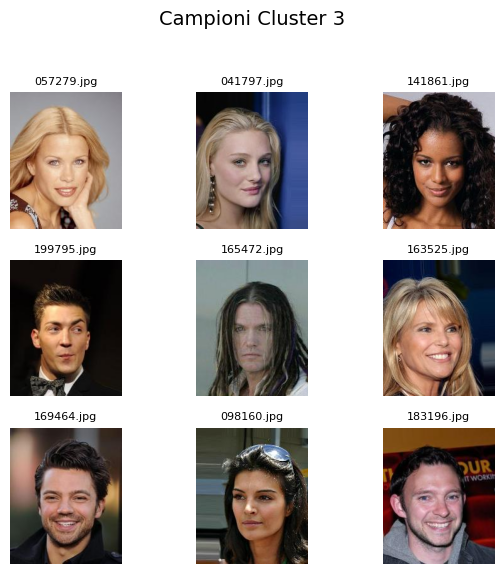


Script terminato.


In [35]:
if __name__ == "__main__":

    # --- 1. DEFINE CONFIGURATION ---

    PROJECT_PATH = "/content/drive/MyDrive/Data Analytics for Business/Progetto" # Modify as needed
    SAVE_PATH = PROJECT_PATH # Often the same
    OUTPUT_LIST_DIR = os.path.join(PROJECT_PATH, 'clusters_output_refactored') # Directory for outputs
    EMBEDDINGS_NPY_FILE_PATH = os.path.join(SAVE_PATH, 'face_embeddings.npy') # Path to your embeddings
    NAMES_NPY_FILE_PATH = os.path.join(SAVE_PATH, 'face_filenames.npy') # Path to your filenames
    CLUSTER_ASSIGNMENTS_NPY_FILE_PATH = os.path.join(OUTPUT_LIST_DIR, 'image_cluster_assignments.npy') # Path for assignments

    K = 4 # Desired number of clusters
    RANDOM_STATE = 42
    RECOMPUTE_CLUSTERS = False # False: Load if exists, True: Always re-run K-Means
    SAVE_CLUSTER_FILE_LISTS = True
    PRINT_SAMPLE_NAMES = True
    NUM_SAMPLE_NAMES_TO_PRINT = 5

    VISUALIZATION_METHOD = 'tsne' # 'tsne' or 'pca'
    VISUALIZE_SAMPLE_ONLY = True # Use sampling for plot/silhouette?
    SAMPLE_SIZE_VIS = 20000      # Sample size if VISUALIZE_SAMPLE_ONLY is True
    VISUALIZE_IMAGE_SAMPLES = True # Show grid of image samples?
    NUM_SAMPLES_TO_SHOW = 9      # Number of images per cluster grid


    # --- 2. LOAD DATA ---
    embeddings, image_names = load_data(EMBEDDINGS_NPY_FILE_PATH, NAMES_NPY_FILE_PATH)

    cluster_labels = None
    cluster_to_names = None
    cluster_counts = None

    if embeddings is not None and image_names is not None:

        # --- 3. PERFORM OR LOAD CLUSTERING ---
        if RECOMPUTE_CLUSTERS or not os.path.exists(CLUSTER_ASSIGNMENTS_NPY_FILE_PATH):
            if RECOMPUTE_CLUSTERS:
                 print("\nForzando riesecuzione K-Means...")
            else:
                 print(f"\nFile assegnazioni cluster non trovato ({CLUSTER_ASSIGNMENTS_NPY_FILE_PATH}). Esecuzione K-Means...")

            cluster_labels_computed, K = perform_kmeans(embeddings, K, RANDOM_STATE) # K might be adjusted
            if cluster_labels_computed is not None:
                 # Save the newly computed assignments
                 saved_ok = save_cluster_assignments(image_names, cluster_labels_computed, CLUSTER_ASSIGNMENTS_NPY_FILE_PATH)
                 if saved_ok:
                      cluster_labels = cluster_labels_computed # Use the computed labels
                 else:
                      print("Errore nel salvataggio, clustering potrebbe non essere utilizzabile.")
                      # Decide how to proceed, maybe exit?
            else:
                 print("K-Means fallito, impossibile procedere.")
        else:
            # Load existing assignments
            cluster_labels_loaded, cluster_to_names_loaded, cluster_counts_loaded = load_cluster_assignments(CLUSTER_ASSIGNMENTS_NPY_FILE_PATH, image_names)
            if cluster_labels_loaded is not None:
                cluster_labels = cluster_labels_loaded
                # cluster_to_names and cluster_counts are already reconstructed by the load function
                cluster_to_names = cluster_to_names_loaded
                cluster_counts = cluster_counts_loaded
                # Update K based on loaded labels if necessary (e.g., find max label + 1)
                if cluster_labels is not None and len(cluster_labels) > 0:
                    actual_k = np.max(cluster_labels[cluster_labels != -1]) + 1 if np.any(cluster_labels != -1) else 0
                    if actual_k != K:
                         print(f"Attenzione: Il numero di cluster K={K} differisce dai cluster caricati (max label={actual_k-1}). Userò k={actual_k} dai dati caricati.")
                         K = actual_k # Use the actual number of clusters found in the file

        # --- 4. PROCESS RESULTS (if clustering succeeded/loaded) ---
        if cluster_labels is not None:
             # If assignments were just computed, cluster_to_names/counts need to be generated
             if cluster_to_names is None or cluster_counts is None:
                 cluster_to_names, cluster_counts = process_and_save_cluster_results(
                     cluster_labels, image_names, K, OUTPUT_LIST_DIR,
                     print_samples=PRINT_SAMPLE_NAMES, num_samples_print=NUM_SAMPLE_NAMES_TO_PRINT,
                     save_lists=SAVE_CLUSTER_FILE_LISTS
                 )
             else:
                  # If loaded, results were already processed, maybe just print confirmation
                  print("\nRisultati cluster (mappa nomi, conteggi, liste ID) caricati o già processati.")
                  if PRINT_SAMPLE_NAMES: # Optionally re-print sample names even when loading
                       for cid in range(K):
                            names_in_c = cluster_to_names.get(cid, [])
                            if names_in_c:
                                 num_p = min(NUM_SAMPLE_NAMES_TO_PRINT, len(names_in_c))
                                 samples_p = random.sample(names_in_c, num_p)
                                 print(f" Cluster {cid} ({len(names_in_c)} elem.) Campioni caricati: {samples_p[:num_p]}")

             if PLOT_SCATTER_GRAPHS:
                print("\n--- Generazione Scatter Plot Abilitata ---")
                sample_size_rd = SAMPLE_SIZE_VIS if VISUALIZE_SAMPLE_ONLY else None
                embeddings_2d, labels_for_plot, plot_title_suffix = reduce_dimensions(
                    embeddings, cluster_labels,
                    method=VISUALIZATION_METHOD,
                    sample_size=sample_size_rd,
                    random_state=RANDOM_STATE
                )

                if embeddings_2d is not None:
                    plot_clusters(
                        embeddings_2d, labels_for_plot, K,
                        method_name=VISUALIZATION_METHOD,
                        title_suffix=plot_title_suffix,
                        output_dir=OUTPUT_LIST_DIR
                    )
                else:
                    print("Visualizzazione scatter plot saltata a causa di errori nella riduzione dimensionale (anche se abilitata).")
             else:
              print("\n--- Generazione Scatter Plot Disabilitata (PLOT_SCATTER_GRAPHS = False) ---")


             # --- 7. VISUALIZE IMAGE SAMPLES ---
             if VISUALIZE_IMAGE_SAMPLES and cluster_to_names is not None:
                 visualize_image_samples(
                     cluster_to_names, K, NUM_SAMPLES_TO_SHOW, get_image_by_number
                 )
             else:
                  print("\nVisualizzazione campioni immagini disabilitata o dati non disponibili.")

        else:
            print("\nClustering non eseguito o fallito. Impossibile procedere con analisi e visualizzazione.")

    else:
        print("\nCaricamento dati fallito. Impossibile procedere.")

    print("\nScript terminato.")


Come già visibile dal grafico realizzato tramite tsne, le coppie di punti corrispondenti ad ogni immagine formano una nube densa e non divisibile, quindi mi aspetto di ottenere un valore di silhouette score molto basso.

Potrebbe essere utile ridurre il vettore .npy da 128 dimensioni normalizzare le feature, a dimensioni diverse tramite PCA, cercando con l'elbow method il numero di feature migliori, infatti ci potrebbero essere delle feature nel dataset che sono poco significative.

#### Check per verificare che l'embedding non sia già stato normalizzato con qualche tecnica


In [36]:
def load_embeddings_safe(embeddings_path):
    """
    Loads embeddings from a .npy file safely.

    Args:
        embeddings_path (str): Path to the .npy file.

    Returns:
        numpy.ndarray or None: Loaded embeddings, or None if loading fails.
    """
    if not os.path.exists(embeddings_path):
        print(f"Errore: File embeddings non trovato a '{embeddings_path}'")
        return None
    try:
        embeddings = np.load(embeddings_path)
        if not isinstance(embeddings, np.ndarray):
            print(f"Errore: Il file '{embeddings_path}' non contiene un array NumPy valido.")
            return None
        if embeddings.ndim != 2:
            print(f"Errore: Atteso array 2D, ma ottenuto array con {embeddings.ndim} dimensioni.")
            return None
        if embeddings.shape[0] == 0:
            print("Errore: Il file embeddings è vuoto.")
            return None
        print(f"Embeddings caricati da '{embeddings_path}'. Shape: {embeddings.shape}")
        return embeddings
    except Exception as e:
        print(f"Errore durante il caricamento degli embeddings da '{embeddings_path}': {e}")
        return None

def check_l2_normalization(embeddings, tolerance=1e-5):
    """
    Checks if embeddings appear to be L2 normalized (unit vectors).

    Args:
        embeddings (np.ndarray): The 2D embedding array (samples x features).
        tolerance (float): Allowed deviation from 1.0 for the norms.

    Returns:
        tuple: (bool, str) - (True if likely normalized, description string)
    """
    if embeddings is None or embeddings.shape[0] == 0:
        return False, "Dati non validi per il controllo L2."

    try:
        # Calculate L2 norm for each row (embedding vector)
        norms = np.linalg.norm(embeddings, axis=1)

        min_norm = np.min(norms)
        max_norm = np.max(norms)

        # Check if all norms are close to 1
        is_normalized = np.allclose(norms, 1.0, atol=tolerance)
        # Alternative check using min/max:
        # is_normalized = (abs(min_norm - 1.0) < tolerance) and (abs(max_norm - 1.0) < tolerance)


        result_str = (f"Controllo L2 Normalization (tolleranza={tolerance}):\n"
                      f"  - Norma L2 minima trovata: {min_norm:.6f}\n"
                      f"  - Norma L2 massima trovata: {max_norm:.6f}\n"
                      f"  - Conclusione: {'Probabilmente L2 normalizzato.' if is_normalized else 'Non sembra L2 normalizzato.'}")
        return is_normalized, result_str

    except Exception as e:
        return False, f"Errore durante il controllo L2: {e}"

def check_zscore_standardization(embeddings, mean_tolerance=1e-5, std_tolerance=1e-5):
    """
    Checks if embeddings appear to be Z-score standardized (mean~0, std~1 per feature).

    Args:
        embeddings (np.ndarray): The 2D embedding array (samples x features).
        mean_tolerance (float): Allowed deviation from 0.0 for feature means.
        std_tolerance (float): Allowed deviation from 1.0 for feature std devs.

    Returns:
        tuple: (bool, str) - (True if likely standardized, description string)
    """
    if embeddings is None or embeddings.shape[0] < 2: # Need at least 2 samples for std dev
         return False, "Dati non validi o insufficienti (<2 campioni) per il controllo Z-Score."

    try:
        # Calculate mean and standard deviation for each column (feature)
        means = np.mean(embeddings, axis=0)
        stds = np.std(embeddings, axis=0)

        # Handle cases where std dev might be zero (e.g., constant feature)
        # These features definitely aren't z-score normalized (std should be 1)
        if np.any(stds < 1e-9): # Check for very small std devs
            print("  Attenzione: Trovate feature con deviazione standard quasi zero.")

        min_mean = np.min(means)
        max_mean = np.max(means)
        min_std = np.min(stds)
        max_std = np.max(stds)

        # Check if all means are close to 0 AND all std devs are close to 1
        means_ok = np.allclose(means, 0.0, atol=mean_tolerance)
        stds_ok = np.allclose(stds, 1.0, atol=std_tolerance)
        # Alternative using min/max:
        # means_ok = (abs(min_mean) < mean_tolerance) and (abs(max_mean) < mean_tolerance)
        # stds_ok = (abs(min_std - 1.0) < std_tolerance) and (abs(max_std - 1.0) < std_tolerance)

        is_standardized = means_ok and stds_ok

        result_str = (f"Controllo Z-Score Standardization (tolleranza media={mean_tolerance}, std={std_tolerance}):\n"
                      f"  - Media minima trovata (per feature): {min_mean:.6f}\n"
                      f"  - Media massima trovata (per feature): {max_mean:.6f}\n"
                      f"  - Dev. Std. minima trovata (per feature): {min_std:.6f}\n"
                      f"  - Dev. Std. massima trovata (per feature): {max_std:.6f}\n"
                      f"  - Conclusione: {'Probabilmente Z-Score standardizzato.' if is_standardized else 'Non sembra Z-Score standardizzato.'}")
        return is_standardized, result_str

    except Exception as e:
        return False, f"Errore durante il controllo Z-Score: {e}"

In [37]:
# --- MAIN EXECUTION ---
if __name__ == "__main__":
    # --- Configuration ---

    EMBEDDINGS_FILE_PATH = "/content/drive/MyDrive/Data Analytics for Business/Progetto/face_embeddings.npy"


    L2_TOLERANCE = 1e-5
    ZSCORE_MEAN_TOLERANCE = 1e-5
    ZSCORE_STD_TOLERANCE = 1e-5
    # --- End Configuration ---

    print(f"Avvio script di verifica normalizzazione per: {EMBEDDINGS_FILE_PATH}")

    # 1. Load embeddings
    embeddings_data = load_embeddings_safe(EMBEDDINGS_FILE_PATH)

    if embeddings_data is not None:
        print("-" * 30)
        # 2. Check L2 Normalization
        is_l2, l2_desc = check_l2_normalization(embeddings_data, L2_TOLERANCE)
        print(l2_desc)

        print("-" * 30)
        # 3. Check Z-Score Standardization
        is_zscore, zscore_desc = check_zscore_standardization(embeddings_data, ZSCORE_MEAN_TOLERANCE, ZSCORE_STD_TOLERANCE)
        print(zscore_desc)
        print("-" * 30)

        # Nota finale
        print("\nNota: Questi controlli verificano se i dati *assomigliano* a dati normalizzati/standardizzati.")
        print("Potrebbero esserci casi limite o dati che soddisfano casualmente i criteri.")
    else:
        print("\nImpossibile eseguire i controlli a causa di errori nel caricamento.")

    print("\nScript di verifica terminato.")

Avvio script di verifica normalizzazione per: /content/drive/MyDrive/Data Analytics for Business/Progetto/face_embeddings.npy
Embeddings caricati da '/content/drive/MyDrive/Data Analytics for Business/Progetto/face_embeddings.npy'. Shape: (202599, 128)
------------------------------
Controllo L2 Normalization (tolleranza=1e-05):
  - Norma L2 minima trovata: 6.692236
  - Norma L2 massima trovata: 40.365921
  - Conclusione: Non sembra L2 normalizzato.
------------------------------
Controllo Z-Score Standardization (tolleranza media=1e-05, std=1e-05):
  - Media minima trovata (per feature): -2.810116
  - Media massima trovata (per feature): 3.418185
  - Dev. Std. minima trovata (per feature): 0.312952
  - Dev. Std. massima trovata (per feature): 1.183123
  - Conclusione: Non sembra Z-Score standardizzato.
------------------------------

Nota: Questi controlli verificano se i dati *assomigliano* a dati normalizzati/standardizzati.
Potrebbero esserci casi limite o dati che soddisfano casua

#### Normalizzazione z-score del file face_embeddings

In [38]:
from sklearn.preprocessing import StandardScaler

scaler = StandardScaler()
embeddings_zscore = scaler.fit_transform(embeddings)


In [39]:
print(embeddings_zscore)

[[ 1.0610946  -0.01867324  0.13063951 ...  0.95643055  0.2774537
  -0.9093775 ]
 [-0.08689326 -0.4104414   0.11368494 ... -0.7355398  -1.0476518
   1.0814788 ]
 [-0.14972696  0.03608685  0.01138929 ...  0.64747363  1.2624606
   0.40571803]
 ...
 [-0.8777539  -0.16150445 -0.71175665 ... -0.93529755 -1.2075984
   0.6026133 ]
 [-0.87580854 -0.70701385  0.88544047 ... -0.10161856  0.4651364
  -0.8246688 ]
 [-0.4709003   0.21094257 -0.07819865 ...  1.0048136   1.5653573
  -1.263064  ]]


In [40]:
print(f'La media del vettore embeddings_zscore è {np.mean(embeddings_zscore)}')
print(f'La deviazione standard del vettore embeddings_zscore è {np.std(embeddings_zscore)}')

La media del vettore embeddings_zscore è -1.0855983473279096e-10
La deviazione standard del vettore embeddings_zscore è 0.9999992251396179


In [41]:
# 1. Standardizzazione (il tuo codice originale è CORRETTO)
scaler = StandardScaler()
embeddings_zscore = scaler.fit_transform(embeddings) # Standardizza le COLONNE

print("Standardizzazione eseguita.")
print(f"Shape dell'output: {embeddings_zscore.shape}")
print("-" * 30)

# 2. Verifica CORRETTA (colonna per colonna, axis=0)
print("VERIFICA (per colonna):")

# Calcola la media di ciascuna colonna
media_colonne = np.mean(embeddings_zscore, axis=0)
# Calcola la deviazione standard di ciascuna colonna
std_colonne = np.std(embeddings_zscore, axis=0)

print(f"Shape delle medie per colonna: {media_colonne.shape}") # Sarà (N_features,)
print(f"Shape delle dev. std. per colonna: {std_colonne.shape}") # Sarà (N_features,)

# Controlla i range delle medie e delle deviazioni standard delle colonne
print(f"Media minima tra le colonne: {np.min(media_colonne):.4e}")
print(f"Media massima tra le colonne: {np.max(media_colonne):.4e}")
print(f"Dev. Std. minima tra le colonne: {np.min(std_colonne):.6f}")
print(f"Dev. Std. massima tra le colonne: {np.max(std_colonne):.6f}")

Standardizzazione eseguita.
Shape dell'output: (202599, 128)
------------------------------
VERIFICA (per colonna):
Shape delle medie per colonna: (128,)
Shape delle dev. std. per colonna: (128,)
Media minima tra le colonne: -3.5761e-08
Media massima tra le colonne: 5.4190e-08
Dev. Std. minima tra le colonne: 0.999967
Dev. Std. massima tra le colonne: 0.999985


#### Utils for PCA on images

Effettuiamo una riduzione della dimensionalità tramite un'analisi delle componenti principali

In [42]:
# --- Funzione per Analisi PCA ---
def perform_pca_analysis(data, n_components=None):
    # ... (codice identico a prima) ...
    if data is None or data.ndim != 2 or data.shape[1] == 0:
        print("Errore: Dati di input non validi per PCA.")
        return None
    print(f"Esecuzione di PCA su dati con shape: {data.shape}")
    pca = PCA(n_components=n_components)
    try:
        pca.fit(data)
        print(f"PCA eseguita. Numero di componenti calcolati: {pca.n_components_}")
        return pca
    except Exception as e:
        print(f"Errore durante l'esecuzione di PCA.fit: {e}")
        return None

# --- Funzione per Grafico Varianza Cumulativa (INVARIATA, ma potremmo rinominarla) ---
def plot_cumulative_explained_variance(pca, highlight_threshold=0.95): # Rinominata per chiarezza
    """
    Plots the CUMULATIVE explained variance ratio from a fitted PCA object.
    """

    if pca is None or not hasattr(pca, 'explained_variance_ratio_'):
        print("Errore: Oggetto PCA non valido o non fittato per varianza cumulativa.")
        return None
    explained_variance_ratio = pca.explained_variance_ratio_
    cumulative_variance_ratio = np.cumsum(explained_variance_ratio)
    n_components_total = len(explained_variance_ratio)
    plt.figure(figsize=(20, 6))
    plt.plot(range(1, n_components_total + 1), cumulative_variance_ratio, marker='.', linestyle='-', label='Varianza Cumulativa Spiegata')
    n_components_threshold = None
    try:
        n_components_threshold = np.argmax(cumulative_variance_ratio >= highlight_threshold) + 1
        threshold_variance = cumulative_variance_ratio[n_components_threshold - 1]
        plt.axhline(y=highlight_threshold, color='r', linestyle='--', label=f'{highlight_threshold*100:.0f}% Varianza Spiegata')
        plt.axvline(x=n_components_threshold, color='g', linestyle=':', label=f'{n_components_threshold} Componenti per {highlight_threshold*100:.0f}% var.')
        plt.plot(n_components_threshold, threshold_variance, 'go', markersize=8)
        print(f"Numero di componenti per spiegare almeno {highlight_threshold*100:.0f}% della varianza cumulativa: {n_components_threshold} (varianza effettiva: {threshold_variance:.4f})")
    except Exception as e:
        print(f"Errore nel calcolo/plot della soglia cumulativa {highlight_threshold}: {e}")
    plt.xlabel('Numero di Componenti Principali')
    plt.ylabel('Varianza Cumulativa Spiegata')
    plt.title('Grafico Varianza Cumulativa Spiegata per PCA')
    plt.grid(True, linestyle=':')
    if n_components_total > 50:
         plt.xlim(0, min(n_components_total + 1, 150))
    else:
         plt.xlim(0, n_components_total + 1)
    plt.ylim(0, 1.05)
    plt.legend(loc='best') # 'center right' might overlap with curve start
    plt.show()
    return n_components_threshold


# --- Funzione per Scree Plot Classico ---
def plot_scree_variance(pca, max_components_to_plot=50):
    """
    Plots the classic Scree Plot (individual explained variance per component).

    Args:
        pca (sklearn.decomposition.PCA): The fitted PCA object.
        max_components_to_plot (int): Maximum number of components to show on x-axis
                                      to keep the plot readable if there are many.
    """
    if pca is None or not hasattr(pca, 'explained_variance_ratio_'):
        print("Errore: Oggetto PCA non valido o non fittato per Scree Plot.")
        return

    individual_variance_ratio = pca.explained_variance_ratio_
    n_components_total = len(individual_variance_ratio)
    components_range = range(1, n_components_total + 1)

    plt.figure(figsize=(20, 6))
    plt.plot(components_range, individual_variance_ratio, marker='o', linestyle='-', color='b')

    plt.xlabel('Numero Componente Principale')
    plt.ylabel('Varianza Spiegata (Individuale)')
    plt.title('Scree Plot')
    plt.xticks(components_range) # Ensure integer ticks for component numbers if few components
    plt.grid(True, linestyle=':')

    # Limit x-axis if too many components, focus on the 'elbow' part
    plot_limit = min(n_components_total, max_components_to_plot)
    plt.xlim(0.5, plot_limit + 0.5)

    plt.show()


# --- Funzione per Applicare Trasformazione PCA ---
def apply_pca_transform(data, n_components_optimal):
    if data is None or data.ndim != 2:
        print("Errore: Dati di input non validi per la trasformazione PCA.")
        return None
    if not isinstance(n_components_optimal, int) or n_components_optimal <= 0 or n_components_optimal > data.shape[1]:
        print(f"Errore: Numero di componenti ottimale ({n_components_optimal}) non valido.")
        return None
    print(f"\nApplicazione della trasformazione PCA per mantenere {n_components_optimal} componenti...")
    pca_final = PCA(n_components=n_components_optimal)
    try:
        transformed_data = pca_final.fit_transform(data)
        print(f"Trasformazione completata. Nuova shape dei dati: {transformed_data.shape}")
        print(f"Varianza totale spiegata da {n_components_optimal} componenti: {np.sum(pca_final.explained_variance_ratio_):.4f}")
        return transformed_data
    except Exception as e:
        print(f"Errore durante l'applicazione della trasformazione PCA: {e}")
        return None

Verifica: 'embeddings_zscore' trovato.
------------------------------
Esecuzione di PCA su dati con shape: (202599, 128)
PCA eseguita. Numero di componenti calcolati: 128
------------------------------
Generazione Scree Plot Classico (varianza individuale per componente)...


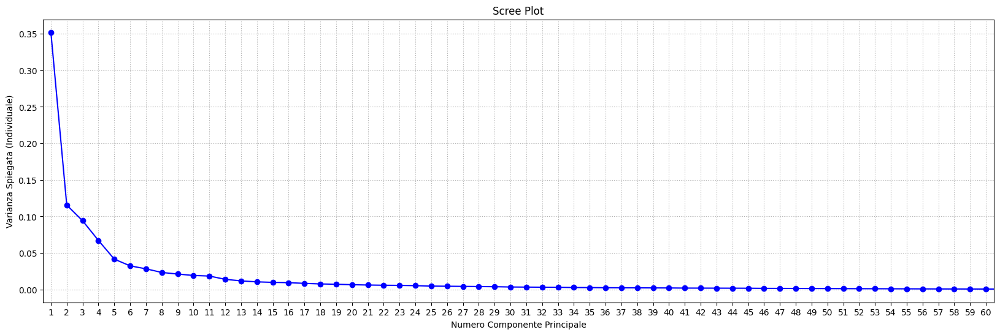

------------------------------
Generazione Grafico Varianza Cumulativa Spiegata...
Numero di componenti per spiegare almeno 95% della varianza cumulativa: 32 (varianza effettiva: 0.9529)


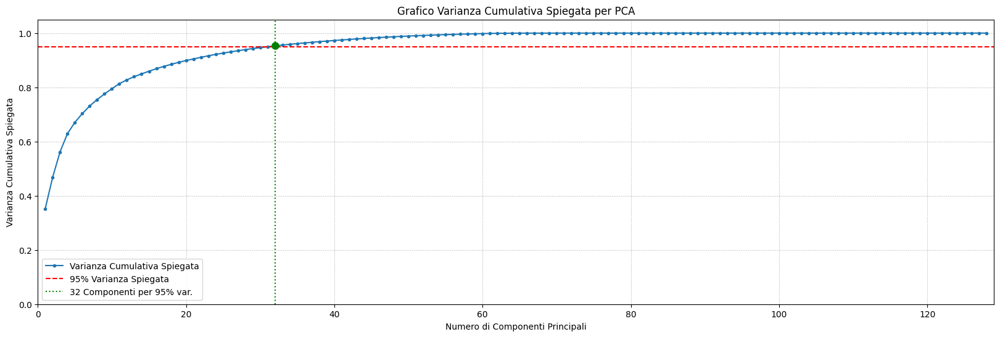

------------------------------
Ora puoi decidere il numero ottimale di componenti basandoti su:
 - L' 'elbow' (gomito) visibile nello Scree Plot Classico.
 - Il numero di componenti suggerito per 95% di varianza (32).
Usando il numero suggerito dalla soglia di varianza: 32
------------------------------
Errore: Numero di componenti ottimale (32) non valido.

Script PCA terminato.


In [43]:
if 'embeddings_zscore' not in locals():
    print("Variabile 'embeddings_zscore' non trovata. Creo dati di esempio standardizzati...")
    np.random.seed(42)
    raw_embeddings = np.random.rand(5000, 128)
    scaler_ex = StandardScaler()
    embeddings_zscore = scaler_ex.fit_transform(raw_embeddings)
    print(f"Dati di esempio creati e standardizzati. Shape: {embeddings_zscore.shape}")
else:
    print("Verifica: 'embeddings_zscore' trovato.")

print("-" * 30)

# 2. Esegui l'analisi PCA iniziale (calcola tutte le componenti)
pca_fitted = perform_pca_analysis(embeddings_zscore, n_components=None)

print("-" * 30)

# 3. Plotta ENTRAMBI i grafici
if pca_fitted:
    # 3a. Scree Plot Classico (varianza individuale)
    print("Generazione Scree Plot Classico (varianza individuale per componente)...")
    plot_scree_variance(pca_fitted, max_components_to_plot=60) # Mostra i primi 60 componenti
    print("-" * 30)

    # 3b. Grafico Varianza Cumulativa
    print("Generazione Grafico Varianza Cumulativa Spiegata...")
    VARIANZA_DESIDERATA = 0.95
    n_suggerito = plot_cumulative_explained_variance(pca_fitted, highlight_threshold=VARIANZA_DESIDERATA)
    print("-" * 30)

    # 4. Decidi il numero ottimale di componenti (usando info da *entrambi* i grafici)
    print("Ora puoi decidere il numero ottimale di componenti basandoti su:")
    print(" - L' 'elbow' (gomito) visibile nello Scree Plot Classico.")
    print(f" - Il numero di componenti suggerito per {VARIANZA_DESIDERATA*100:.0f}% di varianza ({n_suggerito}).")

    # --- Scegli n_componenti_ottimale ---
    if n_suggerito:

        n_componenti_ottimale = n_suggerito
        print(f"Usando il numero suggerito dalla soglia di varianza: {n_componenti_ottimale}")
    else:
        # Fallback se n_suggerito non è stato calcolato
        try:
            n_componenti_ottimale = int(input("Soglia non trovata. Inserisci il numero di componenti ottimale basato sullo Scree Plot: "))
            if n_componenti_ottimale <= 0 or n_componenti_ottimale > embeddings_zscore.shape[1]:
                raise ValueError("Numero non valido.")
        except ValueError as e:
            print(f"Input non valido: {e}. Uso un default (es. 30). Modifica se necessario.")
            n_componenti_ottimale = 30

    print("-" * 30)

    # 5. Applica la trasformazione PCA
    embeddings_pca = apply_pca_transform(embeddings_zscore, n_componenti_ottimale)

    if embeddings_pca is not None:
        print("\nI nuovi embeddings ridotti dimensionalmente sono in 'embeddings_pca'")
        # Esempio: print(embeddings_pca[:5])
else:
    print("Analisi PCA fallita, impossibile procedere.")


print("\nScript PCA terminato.")

#### Clustering con PCA a 12 componenti

In [44]:
components=12
embeddings_pca_12 = apply_pca_transform(embeddings_zscore, components)


Applicazione della trasformazione PCA per mantenere 12 componenti...
Trasformazione completata. Nuova shape dei dati: (202599, 12)
Varianza totale spiegata da 12 componenti: 0.8274


In [45]:
print(embeddings_pca_12)

[[-6.984863   -5.3825336  -8.920525   ...  2.4798665  -2.8993237
  -1.2721603 ]
 [ 1.2607254   0.38423982  0.50607073 ... -1.1850698   2.5338905
   1.4570625 ]
 [ 2.8798187  10.299734    3.489346   ... -1.1274766  -0.24002714
   0.2306488 ]
 ...
 [ 7.3383965   1.9551184   1.7340187  ...  0.60211587 -0.52326286
  -1.3578708 ]
 [-5.294426    3.2216277   1.17927    ... -1.1574224  -0.13880242
  -0.71590143]
 [-7.5159674   2.0544453  -3.5656254  ... -1.3878745   0.74207526
   1.1076053 ]]


In [46]:
np.save(os.path.join(SAVE_PATH, 'face_embeddings_pca_12.npy'), embeddings_pca_12)

Caricamento embeddings da: /content/drive/MyDrive/Data Analytics for Business/Progetto/face_embeddings_pca_12.npy
Embeddings caricati. Shape: (202599, 12)
Attenzione: Atteso array 2D con 128 colonne, shape attuale (202599, 12)
Caricamento nomi immagini da: /content/drive/MyDrive/Data Analytics for Business/Progetto/face_filenames.npy
Nomi immagini caricati. Numero: 202599

CARICAMENTO assegnazioni cluster esistenti da: /content/drive/MyDrive/Data Analytics for Business/Progetto/clusters_output_pca_12/image_cluster_assignments_pca_12.npy
Assegnazioni caricate. Shape: (202599, 2)
Etichette cluster (1D int) ricostruite nell'ordine corretto.
Ricostruzione mappa cluster -> nomi...
Mappa cluster -> nomi ricostruita.

Risultati cluster (mappa nomi, conteggi, liste ID) caricati o già processati.
 Cluster 0 (53909 elem.) Campioni caricati: [np.str_('090872.jpg'), np.str_('065286.jpg'), np.str_('030364.jpg'), np.str_('051167.jpg'), np.str_('089087.jpg')]
 Cluster 1 (40633 elem.) Campioni caricat

/usr/local/lib/python3.11/dist-packages/sklearn/manifold/_t_sne.py:1164: FutureWarning: 'n_iter' was renamed to 'max_iter' in version 1.5 and will be removed in 1.7.
  warnings.warn(


Riduzione dimensionale completata.
Plotting scatter embeddings...


<ipython-input-34-6154877ae3a3>:334: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = plt.cm.get_cmap('viridis', k)


Scatter plot salvato in: /content/drive/MyDrive/Data Analytics for Business/Progetto/clusters_output_pca_12/cluster_visualization_tsne_k4.png


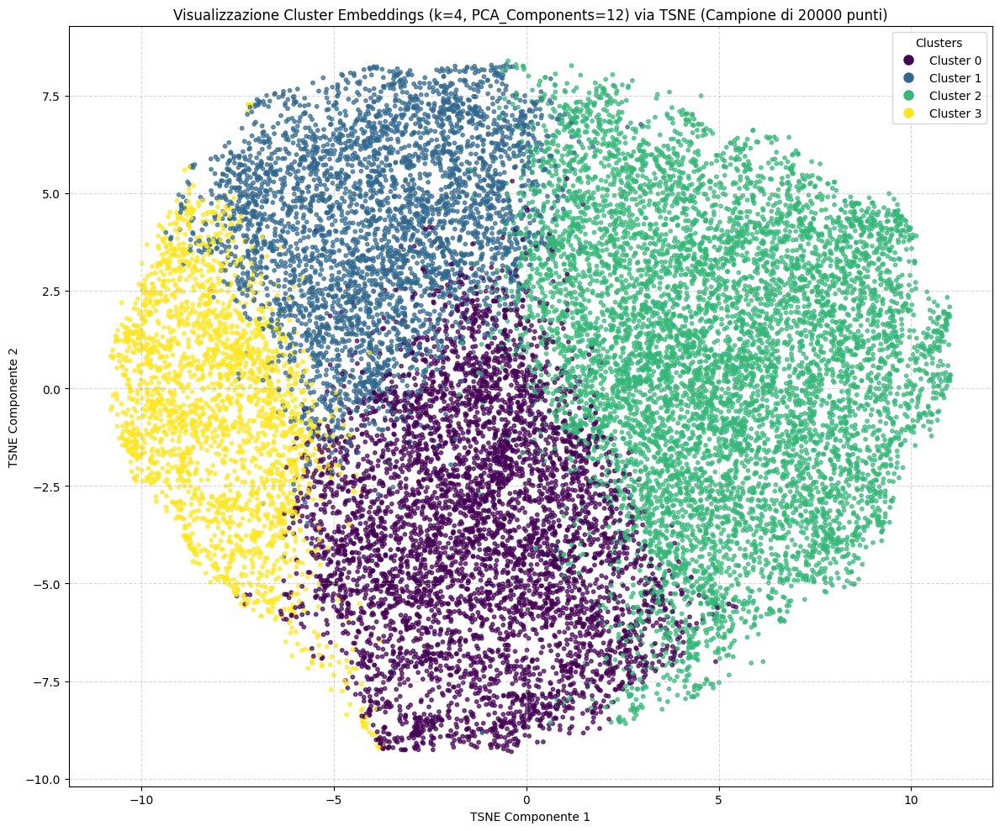


Script terminato.


In [47]:
if __name__ == "__main__":

    OUTPUT_LIST_DIR = os.path.join(PROJECT_PATH, 'clusters_output_pca_12')
    EMBEDDINGS_NPY_FILE_PATH = os.path.join(SAVE_PATH, 'face_embeddings_pca_12.npy')
    NAMES_NPY_FILE_PATH = os.path.join(SAVE_PATH, 'face_filenames.npy')
    CLUSTER_ASSIGNMENTS_NPY_FILE_PATH = os.path.join(OUTPUT_LIST_DIR, 'image_cluster_assignments_pca_12.npy') # Path for assignments

    K = 4 # Desired number of clusters
    RANDOM_STATE = 42
    RECOMPUTE_CLUSTERS = False # False: Load if exists, True: Always re-run K-Means
    SAVE_CLUSTER_FILE_LISTS = True
    PRINT_SAMPLE_NAMES = True
    NUM_SAMPLE_NAMES_TO_PRINT = 5

    VISUALIZATION_METHOD = 'tsne' # 'tsne' or 'pca'

    VISUALIZE_SAMPLE_ONLY = True
    SAMPLE_SIZE_VIS = 20000      # Sample size if VISUALIZE_SAMPLE_ONLY is True
    VISUALIZE_IMAGE_SAMPLES = True # Show grid of image samples?
    NUM_SAMPLES_TO_SHOW = 9      # Number of images per cluster grid


    # --- 2. LOAD DATA ---
    embeddings, image_names = load_data(EMBEDDINGS_NPY_FILE_PATH, NAMES_NPY_FILE_PATH)

    cluster_labels = None
    cluster_to_names = None
    cluster_counts = None

    if embeddings is not None and image_names is not None:

        # --- 3. PERFORM OR LOAD CLUSTERING ---
        if RECOMPUTE_CLUSTERS or not os.path.exists(CLUSTER_ASSIGNMENTS_NPY_FILE_PATH):
            if RECOMPUTE_CLUSTERS:
                 print("\nForzando riesecuzione K-Means...")
            else:
                 print(f"\nFile assegnazioni cluster non trovato ({CLUSTER_ASSIGNMENTS_NPY_FILE_PATH}). Esecuzione K-Means...")

            cluster_labels_computed, K = perform_kmeans(embeddings, K, RANDOM_STATE) # K might be adjusted
            if cluster_labels_computed is not None:
                 # Save the newly computed assignments
                 saved_ok = save_cluster_assignments(image_names, cluster_labels_computed, CLUSTER_ASSIGNMENTS_NPY_FILE_PATH)
                 if saved_ok:
                      cluster_labels = cluster_labels_computed # Use the computed labels
                 else:
                      print("Errore nel salvataggio, clustering potrebbe non essere utilizzabile.")
                      # Decide how to proceed, maybe exit?
            else:
                 print("K-Means fallito, impossibile procedere.")
        else:
            # Load existing assignments
            cluster_labels_loaded, cluster_to_names_loaded, cluster_counts_loaded = load_cluster_assignments(CLUSTER_ASSIGNMENTS_NPY_FILE_PATH, image_names)
            if cluster_labels_loaded is not None:
                cluster_labels = cluster_labels_loaded
                # cluster_to_names and cluster_counts are already reconstructed by the load function
                cluster_to_names = cluster_to_names_loaded
                cluster_counts = cluster_counts_loaded
                # Update K based on loaded labels if necessary (e.g., find max label + 1)
                if cluster_labels is not None and len(cluster_labels) > 0:
                    actual_k = np.max(cluster_labels[cluster_labels != -1]) + 1 if np.any(cluster_labels != -1) else 0
                    if actual_k != K:
                         print(f"Attenzione: Il numero di cluster K={K} differisce dai cluster caricati (max label={actual_k-1}). Userò k={actual_k} dai dati caricati.")
                         K = actual_k # Use the actual number of clusters found in the file

        # --- 4. PROCESS RESULTS (if clustering succeeded/loaded) ---
        if cluster_labels is not None:
             # If assignments were just computed, cluster_to_names/counts need to be generated
             if cluster_to_names is None or cluster_counts is None:
                 cluster_to_names, cluster_counts = process_and_save_cluster_results(
                     cluster_labels, image_names, K, OUTPUT_LIST_DIR,
                     print_samples=PRINT_SAMPLE_NAMES, num_samples_print=NUM_SAMPLE_NAMES_TO_PRINT,
                     save_lists=SAVE_CLUSTER_FILE_LISTS
                 )
             else:
                  # If loaded, results were already processed, maybe just print confirmation
                  print("\nRisultati cluster (mappa nomi, conteggi, liste ID) caricati o già processati.")
                  if PRINT_SAMPLE_NAMES: # Optionally re-print sample names even when loading
                       for cid in range(K):
                            names_in_c = cluster_to_names.get(cid, [])
                            if names_in_c:
                                 num_p = min(NUM_SAMPLE_NAMES_TO_PRINT, len(names_in_c))
                                 samples_p = random.sample(names_in_c, num_p)
                                 print(f" Cluster {cid} ({len(names_in_c)} elem.) Campioni caricati: {samples_p[:num_p]}")

             if PLOT_SCATTER_GRAPHS:

              print("\n--- Generazione Scatter Plot Abilitata ---")
              silhouette_avg = calculate_silhouette(
                embeddings, cluster_labels,
                sample_size=(SAMPLE_SIZE_VIS if VISUALIZE_SAMPLE_ONLY else None),
                random_state=RANDOM_STATE)

              # --- 6. REDUCE DIMENSIONS & PLOT ---
              sample_size_rd = SAMPLE_SIZE_VIS if VISUALIZE_SAMPLE_ONLY else None
              embeddings_2d, labels_for_plot, plot_title_suffix = reduce_dimensions(
                  embeddings, cluster_labels,
                  method=VISUALIZATION_METHOD,
                  sample_size=sample_size_rd,
                  random_state=RANDOM_STATE)

              if embeddings_2d is not None:
                  plot_clusters(
                      embeddings_2d, labels_for_plot, K,
                      method_name=VISUALIZATION_METHOD,
                      title_suffix=plot_title_suffix,
                      output_dir=OUTPUT_LIST_DIR # Save plot in the output directory
                      )
              else:
                print("Visualizzazione scatter plot saltata a causa di errori nella riduzione dimensionale.")
             else:
              print("--- Generazione Scatter Plot Disabilitata ---")



              # --- 7. VISUALIZE IMAGE SAMPLES ---
              if VISUALIZE_IMAGE_SAMPLES and cluster_to_names is not None:
                  visualize_image_samples(
                      cluster_to_names, K, NUM_SAMPLES_TO_SHOW, get_image_by_number
                  )
              else:
                    print("\nVisualizzazione campioni immagini disabilitata o dati non disponibili.")

        else:
            print("\nClustering non eseguito o fallito. Impossibile procedere con analisi e visualizzazione.")

    else:
        print("\nCaricamento dati fallito. Impossibile procedere.")

    print("\nScript terminato.")


Da questi esperimenti notiamo che con una pca a 12 componenti non riusciamo ad ottenere una buona separazione tra Clusters.

#### Clustering con PCA a 6 componenti

Provo ad utilizzare una pca a 6 componenti per vedere se ottengo risultati migliori:

In [48]:
components=6
embeddings_pca_6 = apply_pca_transform(embeddings_zscore, components)


Applicazione della trasformazione PCA per mantenere 6 componenti...
Trasformazione completata. Nuova shape dei dati: (202599, 6)
Varianza totale spiegata da 6 componenti: 0.7030


In [49]:
np.save(os.path.join(SAVE_PATH, 'face_embeddings_pca_6.npy'), embeddings_pca_6)

Caricamento embeddings da: /content/drive/MyDrive/Data Analytics for Business/Progetto/face_embeddings_pca_6.npy
Embeddings caricati. Shape: (202599, 6)
Attenzione: Atteso array 2D con 128 colonne, shape attuale (202599, 6)
Caricamento nomi immagini da: /content/drive/MyDrive/Data Analytics for Business/Progetto/face_filenames.npy
Nomi immagini caricati. Numero: 202599

CARICAMENTO assegnazioni cluster esistenti da: /content/drive/MyDrive/Data Analytics for Business/Progetto/clusters_output_pca_6/image_cluster_assignments_pca_6.npy
Assegnazioni caricate. Shape: (202599, 2)
Etichette cluster (1D int) ricostruite nell'ordine corretto.
Ricostruzione mappa cluster -> nomi...
Mappa cluster -> nomi ricostruita.

Risultati cluster (mappa nomi, conteggi, liste ID) caricati o già processati.
 Cluster 0 (53507 elem.) Campioni caricati: [np.str_('201519.jpg'), np.str_('059681.jpg'), np.str_('138201.jpg'), np.str_('015252.jpg'), np.str_('050460.jpg')]
 Cluster 1 (24891 elem.) Campioni caricati: [n

/usr/local/lib/python3.11/dist-packages/sklearn/manifold/_t_sne.py:1164: FutureWarning: 'n_iter' was renamed to 'max_iter' in version 1.5 and will be removed in 1.7.
  warnings.warn(


Riduzione dimensionale completata.
Plotting scatter embeddings...


<ipython-input-34-6154877ae3a3>:334: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = plt.cm.get_cmap('viridis', k)


Scatter plot salvato in: /content/drive/MyDrive/Data Analytics for Business/Progetto/clusters_output_pca_6/cluster_visualization_tsne_k4.png


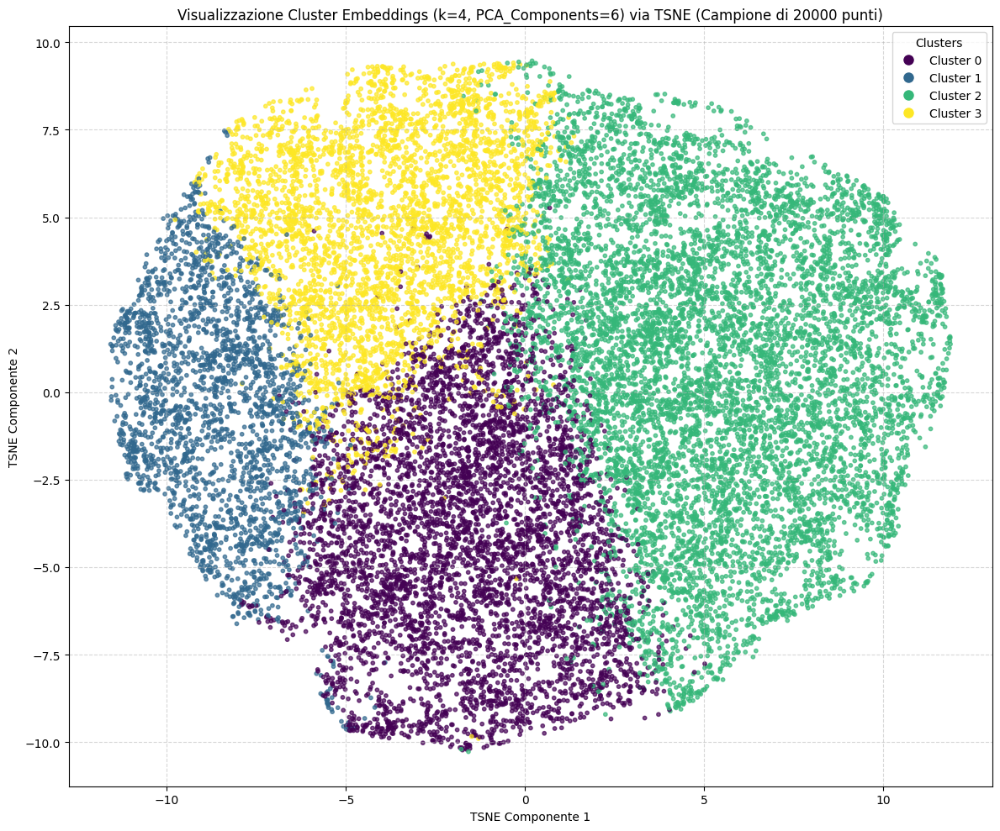


--- Visualizzazione Campioni Immagini per Cluster ---

Cluster 0 (53507 totali):
 Mostro 9 campioni casuali...


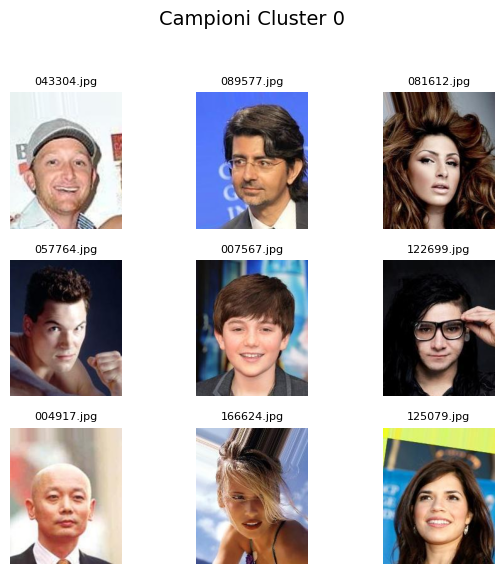


Cluster 1 (24891 totali):
 Mostro 9 campioni casuali...


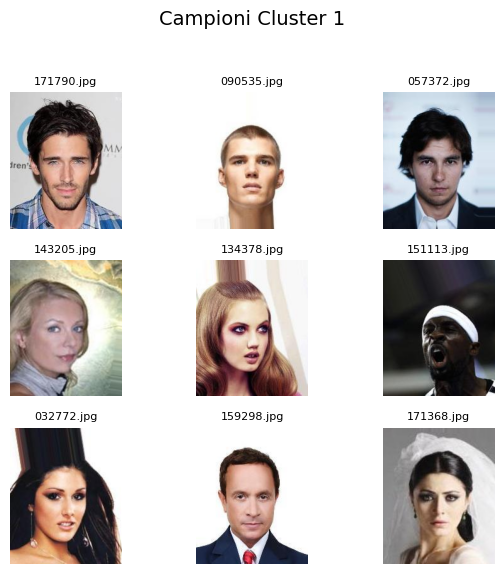


Cluster 2 (84042 totali):
 Mostro 9 campioni casuali...


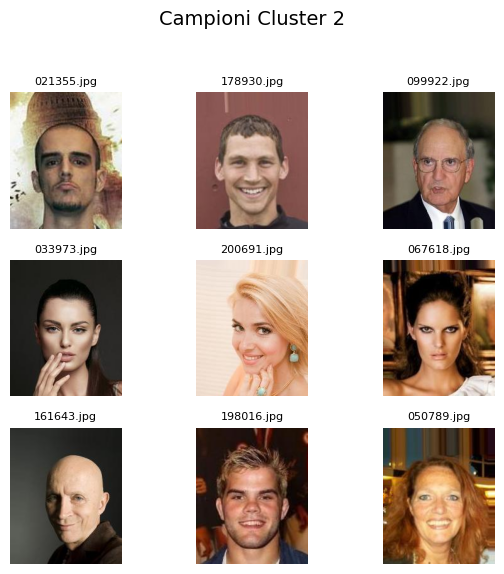


Cluster 3 (40159 totali):
 Mostro 9 campioni casuali...


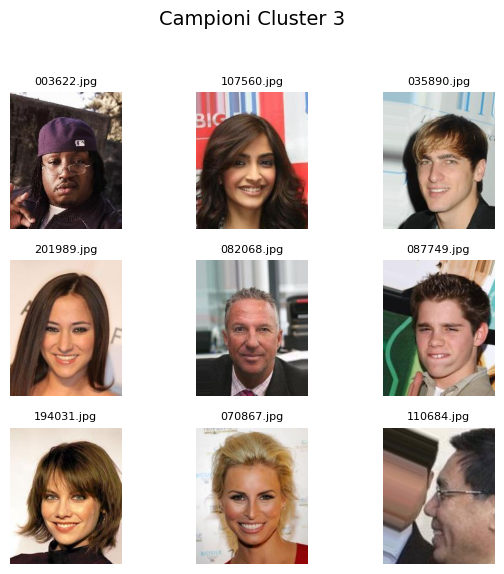


Script terminato.


In [50]:
if __name__ == "__main__":

    OUTPUT_LIST_DIR = os.path.join(PROJECT_PATH, 'clusters_output_pca_6')
    EMBEDDINGS_NPY_FILE_PATH = os.path.join(SAVE_PATH, 'face_embeddings_pca_6.npy')
    NAMES_NPY_FILE_PATH = os.path.join(SAVE_PATH, 'face_filenames.npy')
    CLUSTER_ASSIGNMENTS_NPY_FILE_PATH = os.path.join(OUTPUT_LIST_DIR, 'image_cluster_assignments_pca_6.npy') # Path for assignments

    K = 4 # Desired number of clusters
    RANDOM_STATE = 42
    RECOMPUTE_CLUSTERS = False  # False: Load if exists, True: Always re-run K-Means
    SAVE_CLUSTER_FILE_LISTS = True
    PRINT_SAMPLE_NAMES = True
    NUM_SAMPLE_NAMES_TO_PRINT = 5

    VISUALIZATION_METHOD = 'tsne' # 'tsne' or 'pca'

    SAMPLE_SIZE_VIS = 20000      # Sample size if VISUALIZE_SAMPLE_ONLY is True
    VISUALIZE_IMAGE_SAMPLES = True # Show grid of image samples?
    NUM_SAMPLES_TO_SHOW = 9      # Number of images per cluster grid


    # --- 2. LOAD DATA ---
    embeddings, image_names = load_data(EMBEDDINGS_NPY_FILE_PATH, NAMES_NPY_FILE_PATH)

    cluster_labels = None
    cluster_to_names = None
    cluster_counts = None

    if embeddings is not None and image_names is not None:

        # --- 3. PERFORM OR LOAD CLUSTERING ---
        if RECOMPUTE_CLUSTERS or not os.path.exists(CLUSTER_ASSIGNMENTS_NPY_FILE_PATH):
            if RECOMPUTE_CLUSTERS:
                 print("\nForzando riesecuzione K-Means...")
            else:
                 print(f"\nFile assegnazioni cluster non trovato ({CLUSTER_ASSIGNMENTS_NPY_FILE_PATH}). Esecuzione K-Means...")

            cluster_labels_computed, K = perform_kmeans(embeddings, K, RANDOM_STATE) # K might be adjusted
            if cluster_labels_computed is not None:
                 # Save the newly computed assignments
                 saved_ok = save_cluster_assignments(image_names, cluster_labels_computed, CLUSTER_ASSIGNMENTS_NPY_FILE_PATH)
                 if saved_ok:
                      cluster_labels = cluster_labels_computed # Use the computed labels
                 else:
                      print("Errore nel salvataggio, clustering potrebbe non essere utilizzabile.")
                      # Decide how to proceed, maybe exit?
            else:
                 print("K-Means fallito, impossibile procedere.")
        else:
            # Load existing assignments
            cluster_labels_loaded, cluster_to_names_loaded, cluster_counts_loaded = load_cluster_assignments(CLUSTER_ASSIGNMENTS_NPY_FILE_PATH, image_names)
            if cluster_labels_loaded is not None:
                cluster_labels = cluster_labels_loaded
                # cluster_to_names and cluster_counts are already reconstructed by the load function
                cluster_to_names = cluster_to_names_loaded
                cluster_counts = cluster_counts_loaded
                # Update K based on loaded labels if necessary (e.g., find max label + 1)
                if cluster_labels is not None and len(cluster_labels) > 0:
                    actual_k = np.max(cluster_labels[cluster_labels != -1]) + 1 if np.any(cluster_labels != -1) else 0
                    if actual_k != K:
                         print(f"Attenzione: Il numero di cluster K={K} differisce dai cluster caricati (max label={actual_k-1}). Userò k={actual_k} dai dati caricati.")
                         K = actual_k # Use the actual number of clusters found in the file

        # --- 4. PROCESS RESULTS (if clustering succeeded/loaded) ---
        if cluster_labels is not None:
             # If assignments were just computed, cluster_to_names/counts need to be generated
             if cluster_to_names is None or cluster_counts is None:
                 cluster_to_names, cluster_counts = process_and_save_cluster_results(
                     cluster_labels, image_names, K, OUTPUT_LIST_DIR,
                     print_samples=PRINT_SAMPLE_NAMES, num_samples_print=NUM_SAMPLE_NAMES_TO_PRINT,
                     save_lists=SAVE_CLUSTER_FILE_LISTS
                 )
             else:
                  # If loaded, results were already processed, maybe just print confirmation
                  print("\nRisultati cluster (mappa nomi, conteggi, liste ID) caricati o già processati.")
                  if PRINT_SAMPLE_NAMES: # Optionally re-print sample names even when loading
                       for cid in range(K):
                            names_in_c = cluster_to_names.get(cid, [])
                            if names_in_c:
                                 num_p = min(NUM_SAMPLE_NAMES_TO_PRINT, len(names_in_c))
                                 samples_p = random.sample(names_in_c, num_p)
                                 print(f" Cluster {cid} ({len(names_in_c)} elem.) Campioni caricati: {samples_p[:num_p]}")


             # --- 5. CALCULATE SILHOUETTE SCORE ---
             if PLOT_SCATTER_GRAPHS:

              silhouette_avg = calculate_silhouette(
                 embeddings, cluster_labels,
                 sample_size=(SAMPLE_SIZE_VIS if VISUALIZE_SAMPLE_ONLY else None),
                 random_state=RANDOM_STATE
                 )

             # --- 6. REDUCE DIMENSIONS & PLOT ---
              sample_size_rd = SAMPLE_SIZE_VIS if VISUALIZE_SAMPLE_ONLY else None
              embeddings_2d, labels_for_plot, plot_title_suffix = reduce_dimensions(
                  embeddings, cluster_labels,
                  method=VISUALIZATION_METHOD,
                  sample_size=sample_size_rd,
                  random_state=RANDOM_STATE)

              if embeddings_2d is not None:
                  plot_clusters(
                      embeddings_2d, labels_for_plot, K,
                      method_name=VISUALIZATION_METHOD,
                      title_suffix=plot_title_suffix,
                      output_dir=OUTPUT_LIST_DIR # Save plot in the output directory
                      )
              else:
                    print("Visualizzazione scatter plot saltata a causa di errori nella riduzione dimensionale.")
             else:
              print("--- Generazione scatter plot disabilitata ---")

             # --- 7. VISUALIZE IMAGE SAMPLES ---
             if VISUALIZE_IMAGE_SAMPLES and cluster_to_names is not None:
                 visualize_image_samples(
                     cluster_to_names, K, NUM_SAMPLES_TO_SHOW, get_image_by_number
                 )
             else:
                  print("\nVisualizzazione campioni immagini disabilitata o dati non disponibili.")

        else:
            print("\nClustering non eseguito o fallito. Impossibile procedere con analisi e visualizzazione.")

    else:
        print("\nCaricamento dati fallito. Impossibile procedere.")

    print("\nScript terminato.")


Con 6 componenti ho ottenuto un valore di Silhouette Score pari a 0.2220, migliorando il valore ottenuto precedentemente, ora proviamo con un valore minore di componenti nel punto migliore della curva a gomito dello Scree-Plot

#### Clustering con PCA a 4 componenti

In [51]:
components=4
embeddings_pca_4 = apply_pca_transform(embeddings_zscore, components)
np.save(os.path.join(SAVE_PATH, 'face_embeddings_pca_4.npy'), embeddings_pca_4)


Applicazione della trasformazione PCA per mantenere 4 componenti...
Trasformazione completata. Nuova shape dei dati: (202599, 4)
Varianza totale spiegata da 4 componenti: 0.6290


Caricamento embeddings da: /content/drive/MyDrive/Data Analytics for Business/Progetto/face_embeddings_pca_4.npy
Embeddings caricati. Shape: (202599, 4)
Attenzione: Atteso array 2D con 128 colonne, shape attuale (202599, 4)
Caricamento nomi immagini da: /content/drive/MyDrive/Data Analytics for Business/Progetto/face_filenames.npy
Nomi immagini caricati. Numero: 202599

CARICAMENTO assegnazioni cluster esistenti da: /content/drive/MyDrive/Data Analytics for Business/Progetto/clusters_output_pca_4/image_cluster_assignments_pca_4.npy
Assegnazioni caricate. Shape: (202599, 2)
Etichette cluster (1D int) ricostruite nell'ordine corretto.
Ricostruzione mappa cluster -> nomi...
Mappa cluster -> nomi ricostruita.

Risultati cluster (mappa nomi, conteggi, liste ID) caricati o già processati.
 Cluster 0 (51988 elem.) Campioni caricati: [np.str_('140362.jpg'), np.str_('154128.jpg'), np.str_('011688.jpg'), np.str_('003713.jpg'), np.str_('198892.jpg')]
 Cluster 1 (25389 elem.) Campioni caricati: [n

/usr/local/lib/python3.11/dist-packages/sklearn/manifold/_t_sne.py:1164: FutureWarning: 'n_iter' was renamed to 'max_iter' in version 1.5 and will be removed in 1.7.
  warnings.warn(


Riduzione dimensionale completata.
Plotting scatter embeddings...


<ipython-input-34-6154877ae3a3>:334: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = plt.cm.get_cmap('viridis', k)


Scatter plot salvato in: /content/drive/MyDrive/Data Analytics for Business/Progetto/clusters_output_pca_4/cluster_visualization_tsne_k4.png


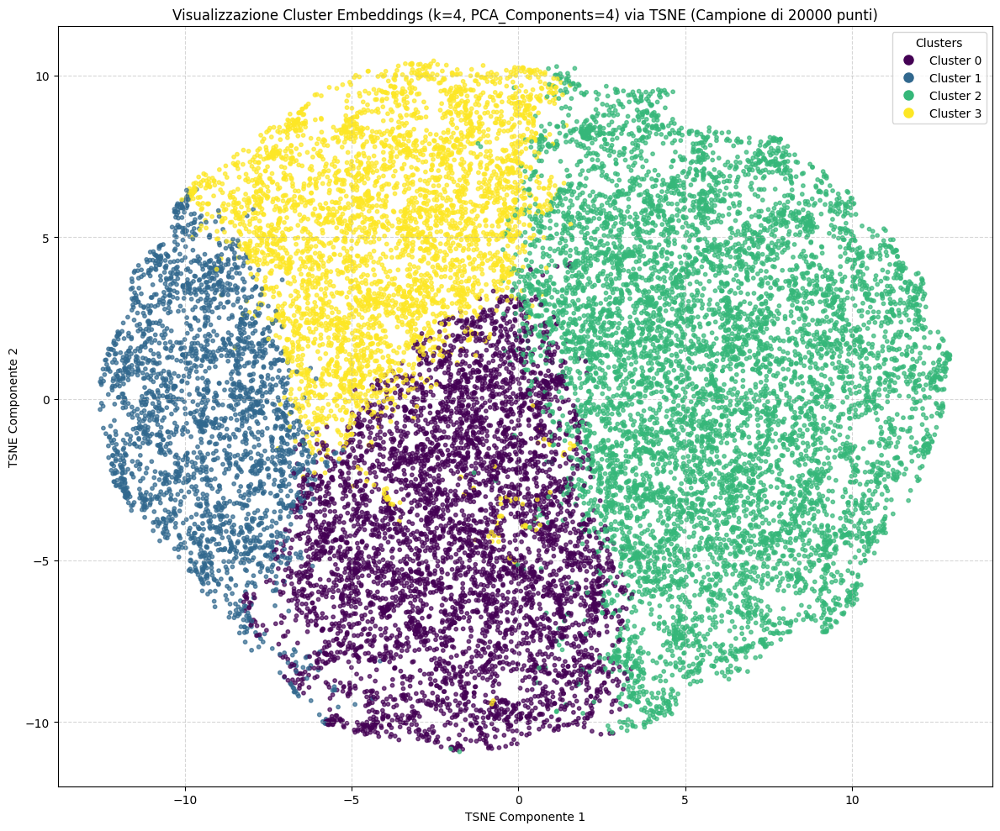


--- Visualizzazione Campioni Immagini per Cluster ---

Cluster 0 (51988 totali):
 Mostro 9 campioni casuali...


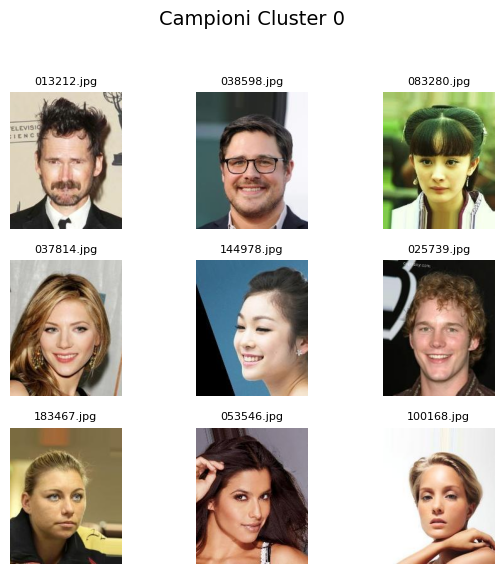


Cluster 1 (25389 totali):
 Mostro 9 campioni casuali...


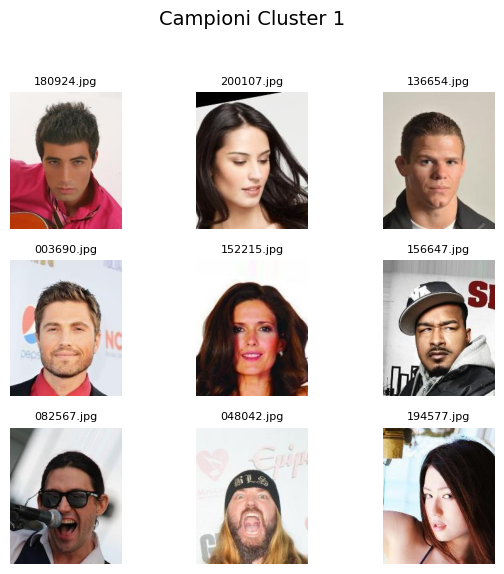


Cluster 2 (84266 totali):
 Mostro 9 campioni casuali...


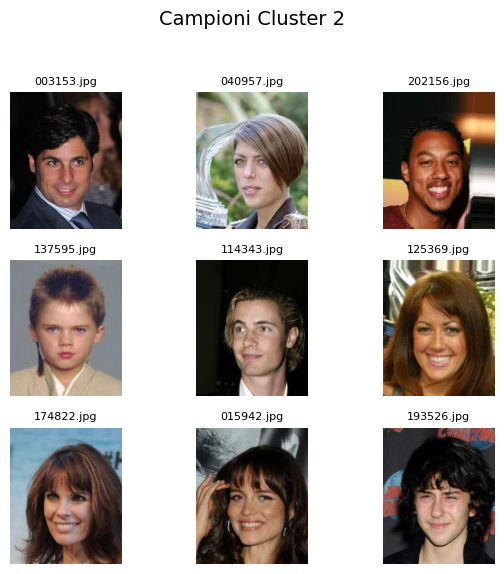


Cluster 3 (40956 totali):
 Mostro 9 campioni casuali...


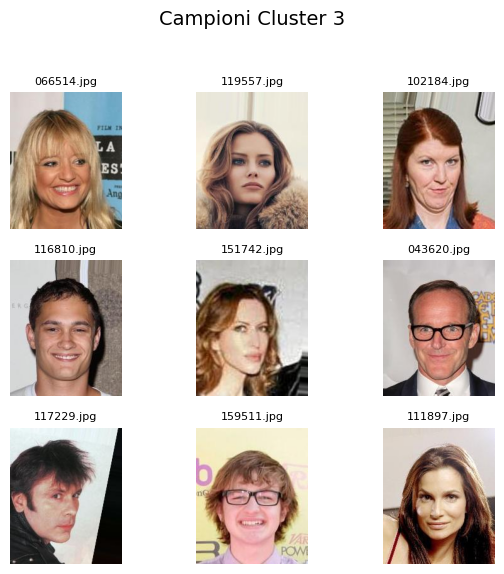


Script terminato.


In [52]:
if __name__ == "__main__":

    OUTPUT_LIST_DIR = os.path.join(PROJECT_PATH, 'clusters_output_pca_4')
    EMBEDDINGS_NPY_FILE_PATH = os.path.join(SAVE_PATH, 'face_embeddings_pca_4.npy')
    NAMES_NPY_FILE_PATH = os.path.join(SAVE_PATH, 'face_filenames.npy')
    CLUSTER_ASSIGNMENTS_NPY_FILE_PATH = os.path.join(OUTPUT_LIST_DIR, 'image_cluster_assignments_pca_4.npy') # Path for assignments

    K = 4 # Desired number of clusters
    RANDOM_STATE = 42
    RECOMPUTE_CLUSTERS = False  # False: Load if exists, True: Always re-run K-Means
    SAVE_CLUSTER_FILE_LISTS = True
    PRINT_SAMPLE_NAMES = True
    NUM_SAMPLE_NAMES_TO_PRINT = 5

    VISUALIZATION_METHOD = 'tsne' # 'tsne' or 'pca'

    SAMPLE_SIZE_VIS = 20000      # Sample size if VISUALIZE_SAMPLE_ONLY is True
    VISUALIZE_IMAGE_SAMPLES = True # Show grid of image samples?
    NUM_SAMPLES_TO_SHOW = 9      # Number of images per cluster grid


    # --- 2. LOAD DATA ---
    embeddings, image_names = load_data(EMBEDDINGS_NPY_FILE_PATH, NAMES_NPY_FILE_PATH)

    cluster_labels = None
    cluster_to_names = None
    cluster_counts = None

    if embeddings is not None and image_names is not None:

        # --- 3. PERFORM OR LOAD CLUSTERING ---
        if RECOMPUTE_CLUSTERS or not os.path.exists(CLUSTER_ASSIGNMENTS_NPY_FILE_PATH):
            if RECOMPUTE_CLUSTERS:
                 print("\nForzando riesecuzione K-Means...")
            else:
                 print(f"\nFile assegnazioni cluster non trovato ({CLUSTER_ASSIGNMENTS_NPY_FILE_PATH}). Esecuzione K-Means...")

            cluster_labels_computed, K = perform_kmeans(embeddings, K, RANDOM_STATE) # K might be adjusted
            if cluster_labels_computed is not None:
                 # Save the newly computed assignments
                 saved_ok = save_cluster_assignments(image_names, cluster_labels_computed, CLUSTER_ASSIGNMENTS_NPY_FILE_PATH)
                 if saved_ok:
                      cluster_labels = cluster_labels_computed # Use the computed labels
                 else:
                      print("Errore nel salvataggio, clustering potrebbe non essere utilizzabile.")
                      # Decide how to proceed, maybe exit?
            else:
                 print("K-Means fallito, impossibile procedere.")
        else:
            # Load existing assignments
            cluster_labels_loaded, cluster_to_names_loaded, cluster_counts_loaded = load_cluster_assignments(CLUSTER_ASSIGNMENTS_NPY_FILE_PATH, image_names)
            if cluster_labels_loaded is not None:
                cluster_labels = cluster_labels_loaded
                # cluster_to_names and cluster_counts are already reconstructed by the load function
                cluster_to_names = cluster_to_names_loaded
                cluster_counts = cluster_counts_loaded
                # Update K based on loaded labels if necessary (e.g., find max label + 1)
                if cluster_labels is not None and len(cluster_labels) > 0:
                    actual_k = np.max(cluster_labels[cluster_labels != -1]) + 1 if np.any(cluster_labels != -1) else 0
                    if actual_k != K:
                         print(f"Attenzione: Il numero di cluster K={K} differisce dai cluster caricati (max label={actual_k-1}). Userò k={actual_k} dai dati caricati.")
                         K = actual_k # Use the actual number of clusters found in the file

        # --- 4. PROCESS RESULTS (if clustering succeeded/loaded) ---
        if cluster_labels is not None:
             # If assignments were just computed, cluster_to_names/counts need to be generated
             if cluster_to_names is None or cluster_counts is None:
                 cluster_to_names, cluster_counts = process_and_save_cluster_results(
                     cluster_labels, image_names, K, OUTPUT_LIST_DIR,
                     print_samples=PRINT_SAMPLE_NAMES, num_samples_print=NUM_SAMPLE_NAMES_TO_PRINT,
                     save_lists=SAVE_CLUSTER_FILE_LISTS
                 )
             else:
                  # If loaded, results were already processed, maybe just print confirmation
                  print("\nRisultati cluster (mappa nomi, conteggi, liste ID) caricati o già processati.")
                  if PRINT_SAMPLE_NAMES: # Optionally re-print sample names even when loading
                       for cid in range(K):
                            names_in_c = cluster_to_names.get(cid, [])
                            if names_in_c:
                                 num_p = min(NUM_SAMPLE_NAMES_TO_PRINT, len(names_in_c))
                                 samples_p = random.sample(names_in_c, num_p)
                                 print(f" Cluster {cid} ({len(names_in_c)} elem.) Campioni caricati: {samples_p[:num_p]}")


             if PLOT_SCATTER_GRAPHS:


              # --- 5. CALCULATE SILHOUETTE SCORE ---
              silhouette_avg = calculate_silhouette(
                 embeddings, cluster_labels,
                 sample_size=(SAMPLE_SIZE_VIS if VISUALIZE_SAMPLE_ONLY else None),
                 random_state=RANDOM_STATE)


              # --- 6. REDUCE DIMENSIONS & PLOT ---
              sample_size_rd = SAMPLE_SIZE_VIS if VISUALIZE_SAMPLE_ONLY else None
              embeddings_2d, labels_for_plot, plot_title_suffix = reduce_dimensions(
                  embeddings, cluster_labels,
                  method=VISUALIZATION_METHOD,
                  sample_size=sample_size_rd,
                  random_state=RANDOM_STATE)

              if embeddings_2d is not None:
                plot_clusters(
                     embeddings_2d, labels_for_plot, K,
                     method_name=VISUALIZATION_METHOD,
                     title_suffix=plot_title_suffix,
                     output_dir=OUTPUT_LIST_DIR # Save plot in the output directory
                     )
              else:
                print("Visualizzazione scatter plot saltata a causa di errori nella riduzione dimensionale.")
             else:
              print("--- Generazione scatter plot disabilitata ---")


             # --- 7. VISUALIZE IMAGE SAMPLES ---
             if VISUALIZE_IMAGE_SAMPLES and cluster_to_names is not None:
                 visualize_image_samples(
                     cluster_to_names, K, NUM_SAMPLES_TO_SHOW, get_image_by_number
                 )
             else:
                  print("\nVisualizzazione campioni immagini disabilitata o dati non disponibili.")

        else:
            print("\nClustering non eseguito o fallito. Impossibile procedere con analisi e visualizzazione.")

    else:
        print("\nCaricamento dati fallito. Impossibile procedere.")

    print("\nScript terminato.")

### Clustering su CSV

In [53]:
attr.head()

,image_id,5_o_Clock_Shadow,Arched_Eyebrows,Attractive,Bags_Under_Eyes,Bangs,Big_Lips,Big_Nose,Black_Hair,Blond_Hair,...,Rosy_Cheeks,Sideburns,Smiling,Straight_Hair,Wavy_Hair,Wearing_Earrings,Wearing_Lipstick,Wearing_Necklace,Wearing_Necktie,Young
0,000001.jpg,0,1,1,0,0,0,0,0,0,...,0,0,1,1,0,1,1,0,0,1
1,000002.jpg,0,0,0,1,0,0,1,0,0,...,0,0,1,0,0,0,0,0,0,1
2,000003.jpg,0,0,0,0,0,1,0,0,0,...,0,0,0,0,1,0,0,0,0,1
3,000004.jpg,0,0,1,0,0,0,0,0,0,...,0,0,0,1,0,1,1,1,0,1
4,000005.jpg,0,1,1,0,0,1,0,0,0,...,0,0,0,0,0,0,1,0,0,1


#### Utils for PCA on CSV

------------------------------
Esecuzione di PCA su dati con shape: (202599, 34)
PCA eseguita. Numero di componenti calcolati: 34
------------------------------
Generazione Scree Plot Classico (varianza individuale per componente)...


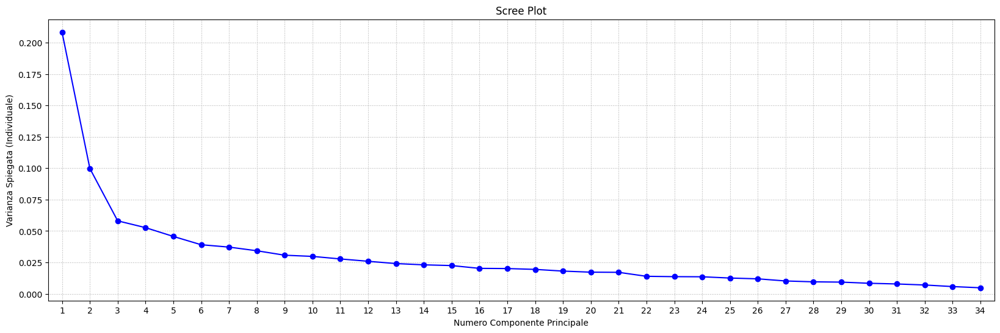

------------------------------
Generazione Grafico Varianza Cumulativa Spiegata...
Numero di componenti per spiegare almeno 95% della varianza cumulativa: 28 (varianza effettiva: 0.9569)


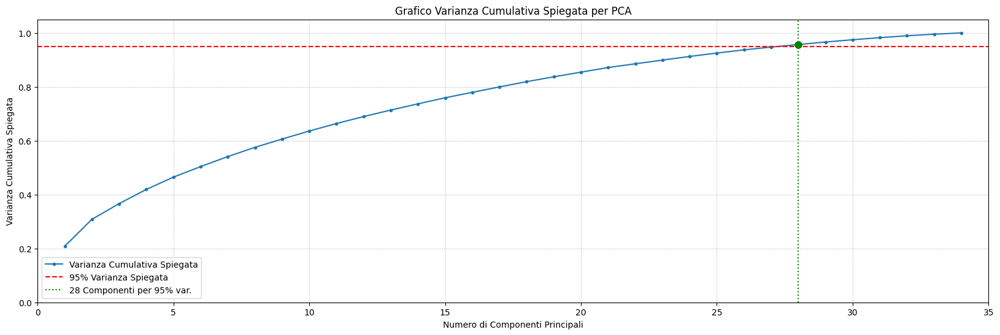

------------------------------
Ora puoi decidere il numero ottimale di componenti basandoti su:
 - L' 'elbow' (gomito) visibile nello Scree Plot Classico.
 - Il numero di componenti suggerito per 95% di varianza (28).
Usando il numero suggerito dalla soglia di varianza: 28
------------------------------

Applicazione della trasformazione PCA per mantenere 28 componenti...
Trasformazione completata. Nuova shape dei dati: (202599, 28)
Varianza totale spiegata da 28 componenti: 0.9569

Script PCA terminato.


In [54]:
print("-" * 30)

# 2. Esegui l'analisi PCA iniziale (calcola tutte le componenti)
attr_dropped = attr.drop('image_id', axis=1)

pca_fitted_attr = perform_pca_analysis(attr_dropped, n_components=None)

print("-" * 30)

# 3. Plotta ENTRAMBI i grafici
if pca_fitted_attr:
    # 3a. Scree Plot Classico (varianza individuale)
    print("Generazione Scree Plot Classico (varianza individuale per componente)...")
    plot_scree_variance(pca_fitted_attr, max_components_to_plot=60) # Mostra i primi 60 componenti
    print("-" * 30)

    # 3b. Grafico Varianza Cumulativa
    print("Generazione Grafico Varianza Cumulativa Spiegata...")
    VARIANZA_DESIDERATA = 0.95
    n_suggerito = plot_cumulative_explained_variance(pca_fitted_attr, highlight_threshold=VARIANZA_DESIDERATA)
    print("-" * 30)

    # 4. Decidi il numero ottimale di componenti (usando info da *entrambi* i grafici)
    print("Ora puoi decidere il numero ottimale di componenti basandoti su:")
    print(" - L' 'elbow' (gomito) visibile nello Scree Plot Classico.")
    print(f" - Il numero di componenti suggerito per {VARIANZA_DESIDERATA*100:.0f}% di varianza ({n_suggerito}).")

    # --- Scegli n_componenti_ottimale ---
    if n_suggerito:
        # Potresti voler prendere un valore leggermente superiore a quello dell'elbow
        # se la varianza cumulativa non è ancora soddisfacente a quel punto.
        # O semplicemente usare n_suggerito dalla soglia.
        n_componenti_ottimale = int(n_suggerito)
        print(f"Usando il numero suggerito dalla soglia di varianza: {n_componenti_ottimale}")
    else:
        # Fallback se n_suggerito non è stato calcolato
        try:
            n_componenti_ottimale = int(input("Soglia non trovata. Inserisci il numero di componenti ottimale basato sullo Scree Plot: "))
            if n_componenti_ottimale <= 0 or n_componenti_ottimale > embeddings_zscore.shape[1]:
                raise ValueError("Numero non valido.")
        except ValueError as e:
            print(f"Input non valido: {e}. Uso un default (es. 30). Modifica se necessario.")
            n_componenti_ottimale = 30

    print("-" * 30)

    # 5. Applica la trasformazione PCA
    attr_pca = apply_pca_transform(attr_dropped, n_componenti_ottimale)

    if embeddings_pca is not None:
        print("\nI nuovi embeddings ridotti dimensionalmente sono in 'embeddings_pca'")
        # Esempio: print(embeddings_pca[:5])
else:
    print("Analisi PCA fallita, impossibile procedere.")


print("\nScript PCA terminato.")

In [55]:
def perform_kmeans(data, k, random_state, n_init='auto'):
    """Performs K-Means clustering (Identica a prima)."""
    print(f"\nEsecuzione di K-Means con k={k}...")
    if data.shape[0] < k:
        print(f"Attenzione: Numero campioni ({data.shape[0]}) < k ({k}). Adatto k a {data.shape[0]}.")
        k = data.shape[0]
    kmeans = KMeans(n_clusters=k, random_state=random_state, n_init=n_init)
    cluster_labels = kmeans.fit_predict(data)
    print("Clustering completato.")
    return cluster_labels, k

def save_cluster_assignments_csv(ids, cluster_labels, assignments_path):
    """Saves IDs and their corresponding cluster labels to a .csv file."""
    try:
        os.makedirs(os.path.dirname(assignments_path), exist_ok=True)
        df_assignments = pd.DataFrame({'id': ids, 'cluster_label': cluster_labels})
        df_assignments.to_csv(assignments_path, index=False)
        print(f"Assegnazioni cluster (ID + label) salvate in: {assignments_path}")
        return True
    except Exception as e:
        print(f"Errore durante il salvataggio delle assegnazioni cluster CSV: {e}")
        return False

def load_cluster_assignments_csv(assignments_path, current_ids):
    """Loads cluster assignments from CSV and reconstructs labels based on current IDs."""
    print(f"\nCARICAMENTO assegnazioni cluster CSV esistenti da: {assignments_path}")
    try:
        df_loaded_assignments = pd.read_csv(assignments_path)
        print(f"Assegnazioni caricate. Numero di righe: {len(df_loaded_assignments)}")

        if len(df_loaded_assignments) != len(current_ids):
            print(f"Errore: Numero assegnazioni caricate ({len(df_loaded_assignments)}) != numero ID attuali ({len(current_ids)})")
            return None, None, None

        id_to_label_map = dict(zip(df_loaded_assignments['id'], df_loaded_assignments['cluster_label']))
        current_ids_str = [str(id_val) for id_val in current_ids]
        id_to_label_map_str_keys = {str(k): v for k, v in id_to_label_map.items()}
        cluster_labels = np.array([id_to_label_map_str_keys.get(id_val, -1) for id_val in current_ids_str], dtype=int)

        missing_count = np.sum(cluster_labels == -1)
        if missing_count > 0:
            print(f"Attenzione: {missing_count} ID correnti non trovati nelle assegnazioni caricate.")

        print("Etichette cluster (1D int) ricostruite.")
        cluster_to_ids_map = collections.defaultdict(list)
        for i, label in enumerate(cluster_labels):
            if label != -1:
                cluster_to_ids_map[label].append(current_ids[i])
        print("Mappa cluster -> ID ricostruita.")
        return cluster_labels, cluster_to_ids_map, collections.Counter(cluster_labels[cluster_labels != -1])

    except FileNotFoundError:
        print(f"Errore: File assegnazioni cluster CSV non trovato ({assignments_path})")
        return None, None, None
    except Exception as e:
        print(f"Errore durante il caricamento delle assegnazioni cluster CSV: {e}")
        return None, None, None

def process_and_save_cluster_results_pca_attr(cluster_labels, ids, df_original_attrs, k, output_dir,
                                              save_lists=True):
    """
    Processes clustering results for PCA'd attribute data: builds map, counts, saves ID lists,
    and optionally analyzes original attribute means per cluster.
    'ids' should be the original identifiers corresponding to the rows of df_original_attrs.
    """
    if cluster_labels is None:
        print("Errore: Etichette cluster non disponibili.")
        return None, None

    print("\nAnalisi e salvataggio risultati cluster (dati attr. PCA):")
    cluster_to_ids = collections.defaultdict(list)
    valid_labels = cluster_labels[cluster_labels != -1]
    # Ensure ids is an array-like structure that supports boolean indexing if cluster_labels can have -1
    ids_array = np.array(ids)
    valid_ids = ids_array[cluster_labels != -1]

    for i, label in enumerate(valid_labels):
         cluster_to_ids[label].append(valid_ids[i])

    cluster_counts = collections.Counter(valid_labels)
    print(f"Numero di elementi per cluster (validi): {sorted(cluster_counts.items())}")

    if save_lists:
        try:
            os.makedirs(output_dir, exist_ok=True)
        except OSError as e:
            print(f"Errore creazione directory {output_dir}: {e}. Salvataggio liste disabilitato.")
            save_lists = False

    for cluster_id in range(k):
        ids_in_cluster = cluster_to_ids.get(cluster_id, [])
        print(f"\n--- Cluster {cluster_id} ({len(ids_in_cluster)} elementi) ---")
        if not ids_in_cluster:
            print(" (Cluster vuoto)")
            continue

        if save_lists and output_dir:
            output_filename = os.path.join(output_dir, f'attr_pca_cluster_{cluster_id}_ids.txt')
            try:
                with open(output_filename, 'w', encoding='utf-8') as f:
                    for item_id in ids_in_cluster:
                        f.write(str(item_id) + '\n')
                print(f"  Lista ID salvata in: {output_filename}")
            except Exception as e:
                print(f"  Errore salvataggio file lista ID cluster {cluster_id}: {e}")

        if df_original_attrs is not None and not df_original_attrs.empty:
            try:
                # Usa la colonna 'image_id' da df_original_attrs per il join con ids_in_cluster
                cluster_original_attrs_df = df_original_attrs[df_original_attrs['image_id'].isin(ids_in_cluster)]
                if not cluster_original_attrs_df.empty:
                    numeric_attrs_df = cluster_original_attrs_df.drop(columns=['image_id'], errors='ignore').select_dtypes(include=np.number)
                    if not numeric_attrs_df.empty:
                        mean_attrs = numeric_attrs_df.mean()
                        print("  Medie attributi ORIGINALI per questo cluster (top 5 più alte, top 5 più basse):")
                        print("  Più alte:")
                        print(mean_attrs.nlargest(5))
                        print("  Più basse:")
                        print(mean_attrs.nsmallest(5))
                    else:
                        print("  Nessun attributo numerico trovato nel df originale per l'analisi delle medie.")
                else:
                     print(f"  Nessun dato trovato in df_original_attrs per gli ID del cluster {cluster_id} (basato su image_id).")
            except KeyError:
                 print("  Errore: La colonna 'image_id' non è presente in df_original_attrs, o il formato degli ID non corrisponde.")
            except Exception as e_attrs:
                 print(f"  Errore durante l'analisi delle medie attributi originali per il cluster {cluster_id}: {e_attrs}")
    return cluster_to_ids, cluster_counts


def calculate_silhouette(data, cluster_labels, sample_size=None, random_state=None):
    # ... (Codice identico) ...
    if cluster_labels is None or data is None: return None
    valid_indices = np.where(cluster_labels != -1)[0]
    if len(valid_indices) < 2: return None
    data_valid, labels_valid = data[valid_indices], cluster_labels[valid_indices]
    if sample_size is not None and len(labels_valid) > sample_size:
        if sample_size < 2: indices_to_use = np.arange(len(labels_valid))
        else:
            rng = np.random.default_rng(random_state)
            indices_to_use = rng.choice(len(labels_valid), size=sample_size, replace=False)
    else: indices_to_use = np.arange(len(labels_valid))
    if len(indices_to_use) < 2: return None
    data_sample, labels_sample = data_valid[indices_to_use], labels_valid[indices_to_use]
    try:
        unique_labels = np.unique(labels_sample)
        if len(unique_labels) < 2 or len(unique_labels) > len(labels_sample): return None
        score = silhouette_score(data_sample, labels_sample)
        print(f"Silhouette Score (su {len(labels_sample)} punti): {score:.4f}")
        return score
    except Exception as e: print(f"Errore Silhouette: {e}"); return None

def reduce_dimensions_for_visualization(data, cluster_labels, method='tsne', sample_size=None, random_state=None, perplexity=30):
    """Riduce le dimensioni specificamente per la visualizzazione (es. t-SNE su dati già PCA)."""
    # ... (Codice identico a reduce_dimensions, ma rinominato per chiarezza di intento) ...
    if cluster_labels is None or data is None: return None, None, None
    valid_indices = np.where(cluster_labels != -1)[0]
    if len(valid_indices) < 2: return None, None, None
    data_valid, labels_valid = data[valid_indices], cluster_labels[valid_indices]
    if sample_size is not None and len(labels_valid) > sample_size:
        if sample_size < 2: indices_to_use = np.arange(len(labels_valid))
        else:
            rng = np.random.default_rng(random_state)
            indices_to_use = rng.choice(len(labels_valid), size=sample_size, replace=False)
    else: indices_to_use = np.arange(len(labels_valid))
    if len(indices_to_use) < 2: return None, None, None
    data_to_reduce, labels_for_plot = data_valid[indices_to_use], labels_valid[indices_to_use]
    plot_title_suffix = f'(Campione di {len(labels_for_plot)} punti)'
    try:
        if method == 'tsne':
            eff_perp = min(perplexity, len(data_to_reduce) - 1)
            if eff_perp <=0: return None, None, None
            reducer = TSNE(n_components=2, random_state=random_state, perplexity=eff_perp, n_iter=300)
        elif method == 'pca': # PCA su dati già PCA è meno comune per visualizzazione, ma possibile
            reducer = SklearnPCA(n_components=2, random_state=random_state)
        else: return None, None, None
        data_2d = reducer.fit_transform(data_to_reduce)
        print(f"Riduzione dimensionale per visualizzazione ({method.upper()}) completata.")
        return data_2d, labels_for_plot, plot_title_suffix
    except Exception as e: print(f"Errore riduzione per visualizzazione: {e}"); return None, None, None


def plot_clusters(data_2d, labels, k, method_name, title_suffix="", output_dir=None, file_prefix=""):
    # ... (Codice identico, aggiunto file_prefix per distinguere i file salvati) ...
    if data_2d is None or labels is None: return
    try:
        plt.figure(figsize=(12, 10))
        unique_labels = np.unique(labels)
        cmap = plt.cm.get_cmap('viridis', k)
        plt.scatter(data_2d[:, 0], data_2d[:, 1], c=labels, cmap=cmap, s=10, alpha=0.7)
        handles, legend_labels_list = [], []
        for val in sorted(unique_labels):
            norm_val = val / (k - 1) if k > 1 else 0.5
            handles.append(plt.Line2D([0], [0], marker='o', color='w', label=f'Cluster {val}', markerfacecolor=cmap(norm_val), markersize=10))
            legend_labels_list.append(f'Cluster {val}')
        if len(unique_labels) <= 20: plt.legend(handles=handles, labels=legend_labels_list, title="Clusters")
        plt.title(f'Visualizzazione Cluster (k={k}) via {method_name.upper()} {title_suffix}')
        plt.xlabel(f'{method_name.upper()} Componente 1'); plt.ylabel(f'{method_name.upper()} Componente 2')
        plt.grid(True, linestyle='--', alpha=0.5); plt.tight_layout()
        if output_dir:
            os.makedirs(output_dir, exist_ok=True)
            filename = f'{file_prefix}cluster_visualization_{method_name}_k{k}.png'
            plt.savefig(os.path.join(output_dir, filename), dpi=300, bbox_inches='tight')
            print(f"Scatter plot salvato: {os.path.join(output_dir, filename)}")
        plt.show()
    except Exception as e: print(f"Errore plotting: {e}")


#### Clustering con PCA a 28 componenti

In [56]:
item_ids = attr['image_id'].values

ATTENZIONE: 'attr_pca', 'item_ids' o 'df_attr_original' non trovate.
Devi eseguire la cella PCA e assicurarti che queste variabili siano disponibili.

--- Inizio clustering per dati 'attr_pca' (shape: (202599, 28)) ---

CARICAMENTO assegnazioni cluster CSV esistenti da: /content/drive/MyDrive/Data Analytics for Business/Progetto/clusters_output_attr_pca/attr_pca_cluster_assignments_k4.csv
Assegnazioni caricate. Numero di righe: 202599
Etichette cluster (1D int) ricostruite.
Mappa cluster -> ID ricostruita.

Analisi e salvataggio risultati cluster (dati attr. PCA):
Numero di elementi per cluster (validi): [(np.int64(0), 61648), (np.int64(1), 45023), (np.int64(2), 55072), (np.int64(3), 40856)]

--- Cluster 0 (61648 elementi) ---
  Lista ID salvata in: /content/drive/MyDrive/Data Analytics for Business/Progetto/clusters_output_attr_pca/attr_pca_cluster_0_ids.txt

--- Cluster 1 (45023 elementi) ---
  Lista ID salvata in: /content/drive/MyDrive/Data Analytics for Business/Progetto/clusters_

/usr/local/lib/python3.11/dist-packages/sklearn/manifold/_t_sne.py:1164: FutureWarning: 'n_iter' was renamed to 'max_iter' in version 1.5 and will be removed in 1.7.
  warnings.warn(


Riduzione dimensionale per visualizzazione (TSNE) completata.


<ipython-input-55-afc4f3e0c5f9>:189: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = plt.cm.get_cmap('viridis', k)


Scatter plot salvato: /content/drive/MyDrive/Data Analytics for Business/Progetto/clusters_output_attr_pca/attr_pca_cluster_visualization_tsne_k4.png


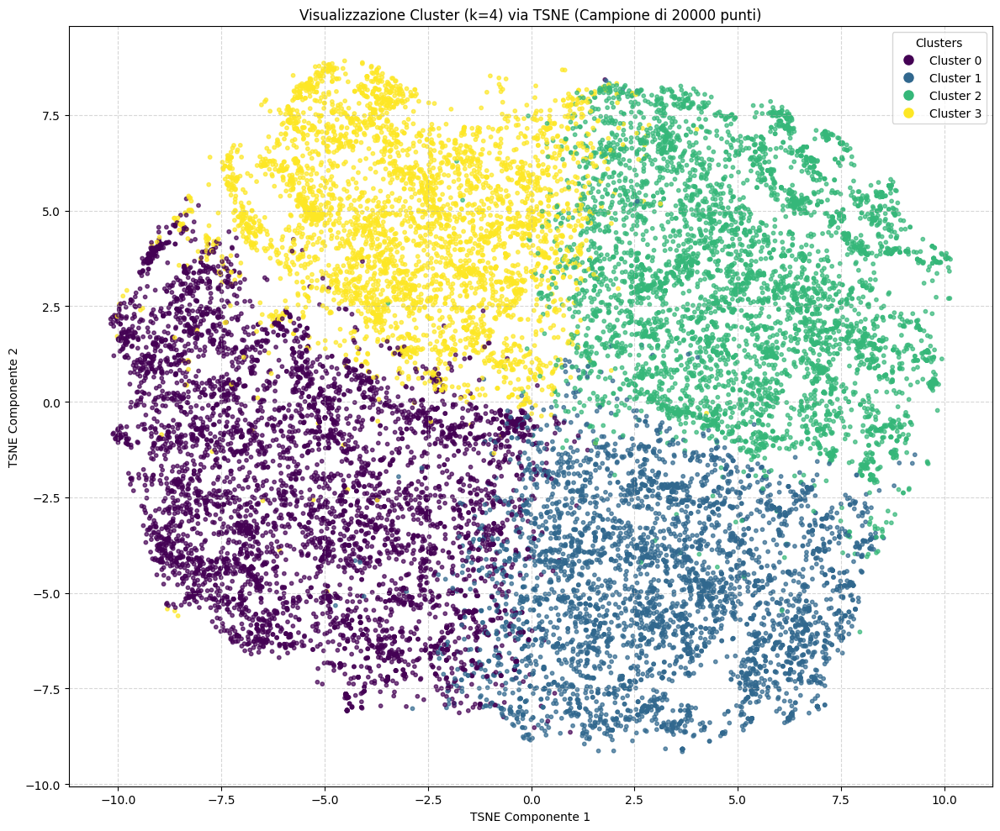


--- Script clustering attr_pca terminato. ---


In [57]:
if __name__ == "__main__":

    # --- 0. PRE-REQUISITI DALLA CELLA PRECEDENTE ---
    # Assicurati che queste variabili siano definite e popolate dalla cella PCA:
    # - attr_pca: L'array NumPy degli attributi dopo la PCA (N_samples x N_componenti_ottimale)
    # - item_ids: Array/lista degli 'image_id' originali, corrispondenti alle righe di attr_pca
    #             (Devi averlo salvato prima di fare drop('image_id') e PCA su 'attr')
    # - df_attr_original: Il DataFrame originale caricato dal CSV attr (con 'image_id' e tutte le feature)
    #                     Serve per l'analisi degli attributi originali nei cluster.

    # --- Esempio di come potresti averle ottenute (DA ADATTARE ALLA TUA CELLA PCA) ---
    if 'attr_pca' not in locals() or 'item_ids' not in locals() or 'df_attr_original' not in locals():
        print("ATTENZIONE: 'attr_pca', 'item_ids' o 'df_attr_original' non trovate.")
        print("Devi eseguire la cella PCA e assicurarti che queste variabili siano disponibili.")
        if 'df_attr_original' not in locals():
            df_attr_original = None # Per permettere allo script di girare senza errori sull'analisi attributi
        if 'attr_pca' not in locals() or 'item_ids' not in locals():
            raise ValueError("Devi fornire 'attr_pca' e 'item_ids' dalla cella precedente!")
    else:
        print(f"Trovato 'attr_pca' con shape: {attr_pca.shape}")
        print(f"Trovato 'item_ids' con lunghezza: {len(item_ids)}")
        if df_attr_original is not None:
             print(f"Trovato 'df_attr_original' con shape: {df_attr_original.shape}")
        else:
             print("Variabile 'df_attr_original' non trovata, l'analisi degli attributi originali per cluster verrà saltata.")


    # --- 1. DEFINE CONFIGURATION ---
    # Output directory per i risultati del clustering su attr_pca
    OUTPUT_DIR_ATTR_PCA_CLUSTERS = "/content/drive/MyDrive/Data Analytics for Business/Progetto/clusters_output_attr_pca" # MODIFICA SE NECESSARIO

    # Parametri di clustering
    K_ATTR_PCA = 4  # Numero di cluster desiderato sui dati PCA degli attributi
    RANDOM_STATE_ATTR_PCA = 42
    RECOMPUTE_CLUSTERS_ATTR_PCA = False # True per forzare, False per caricare se esiste
    # Il nome del file di assegnazione ora include K per evitare sovrascritture se cambi K
    CLUSTER_ASSIGNMENTS_ATTR_PCA_PATH = os.path.join(OUTPUT_DIR_ATTR_PCA_CLUSTERS, f'attr_pca_cluster_assignments_k{K_ATTR_PCA}.csv')

    # Opzioni di visualizzazione e analisi
    VISUALIZATION_METHOD_ATTR_PCA = 'tsne' # 'tsne' o 'pca' (t-SNE è spesso migliore su dati già PCA per visualizzazione)
    SAMPLE_SIZE_VIS_ATTR_PCA = 20000 # Campione per t-SNE/Silhouette

    # --- 2. CHECK DATI DI INPUT ---
    if attr_pca is None or item_ids is None:
        print("Errore: 'attr_pca' o 'item_ids' non sono disponibili. Assicurati che la cella PCA sia stata eseguita.")
    else:
        print(f"\n--- Inizio clustering per dati 'attr_pca' (shape: {attr_pca.shape}) ---")

        data_for_clustering = attr_pca # I dati su cui fare clustering
        current_ids_for_saving = item_ids # Gli ID da salvare con le etichette

        cluster_labels_attr_pca = None
        # cluster_to_ids_map_attr_pca = None # Non esplicitamente necessario qui, la funzione lo gestisce

        # --- 3. PERFORM OR LOAD CLUSTERING ---
        if RECOMPUTE_CLUSTERS_ATTR_PCA or not os.path.exists(CLUSTER_ASSIGNMENTS_ATTR_PCA_PATH):
            if RECOMPUTE_CLUSTERS_ATTR_PCA:
                 print(f"\nForzando riesecuzione K-Means per dati attr_pca con k={K_ATTR_PCA}...")
            else:
                 print(f"\nFile assegnazioni attr_pca non trovato. Esecuzione K-Means con k={K_ATTR_PCA}...")

            cluster_labels_computed, K_ATTR_PCA = perform_kmeans(data_for_clustering, K_ATTR_PCA, RANDOM_STATE_ATTR_PCA)
            if cluster_labels_computed is not None:
                 saved_ok = save_cluster_assignments_csv(current_ids_for_saving, cluster_labels_computed, CLUSTER_ASSIGNMENTS_ATTR_PCA_PATH)
                 if saved_ok:
                      cluster_labels_attr_pca = cluster_labels_computed
        else:
            loaded_labels, _, _ = load_cluster_assignments_csv(CLUSTER_ASSIGNMENTS_ATTR_PCA_PATH, current_ids_for_saving)
            if loaded_labels is not None:
                cluster_labels_attr_pca = loaded_labels
                if cluster_labels_attr_pca is not None and len(cluster_labels_attr_pca) > 0:
                     actual_k = np.max(cluster_labels_attr_pca[cluster_labels_attr_pca != -1]) + 1 if np.any(cluster_labels_attr_pca != -1) else 0
                     if actual_k > 0 and actual_k != K_ATTR_PCA:
                          print(f"Attenzione: K={K_ATTR_PCA} differisce dai cluster caricati (k={actual_k}). Userò k={actual_k}.")
                          K_ATTR_PCA = actual_k

        # --- 4. PROCESS RESULTS (if clustering succeeded/loaded) ---
        if cluster_labels_attr_pca is not None:
            # Passa df_attr_original per analizzare gli attributi originali
            _, _ = process_and_save_cluster_results_pca_attr(
                cluster_labels_attr_pca, current_ids_for_saving, df_attr_original, K_ATTR_PCA, OUTPUT_DIR_ATTR_PCA_CLUSTERS,
                save_lists=True
            )
            if PLOT_SCATTER_GRAPHS:


              # --- 5. CALCULATE SILHOUETTE SCORE ---
              silhouette_avg_attr_pca = calculate_silhouette(
                  data_for_clustering, cluster_labels_attr_pca,
                  sample_size=SAMPLE_SIZE_VIS_ATTR_PCA,
                  random_state=RANDOM_STATE_ATTR_PCA
              )

              # --- 6. REDUCE DIMENSIONS FOR VISUALIZATION & PLOT ---
              # Applicheremo t-SNE (o PCA di visualizzazione) ai dati *già ridotti* da attr_pca
              data_2d_viz, labels_for_plot_viz, plot_title_suffix_viz = reduce_dimensions_for_visualization(
                  data_for_clustering, cluster_labels_attr_pca,
                  method=VISUALIZATION_METHOD_ATTR_PCA,
                  sample_size=SAMPLE_SIZE_VIS_ATTR_PCA,
                  random_state=RANDOM_STATE_ATTR_PCA
              )

              if data_2d_viz is not None:
                  plot_clusters(
                      data_2d_viz, labels_for_plot_viz, K_ATTR_PCA,
                      method_name=VISUALIZATION_METHOD_ATTR_PCA,
                      title_suffix=plot_title_suffix_viz,
                      output_dir=OUTPUT_DIR_ATTR_PCA_CLUSTERS,
                      file_prefix="attr_pca_" # Per distinguere i file salvati
                  )
              else:
                    print("Visualizzazione scatter plot saltata per dati attr_pca a causa di errori.")
            else:
              print("Visualizzazione scatter plot non abilitata PLOT_SCATTER_GRAPHS=False")
        else:
            print("\nClustering per dati attr_pca non eseguito o fallito.")

    print("\n--- Script clustering attr_pca terminato. ---")

#### Clustering con PCA a 7 componenti

In [58]:
components=7
attr_pca_7= apply_pca_transform(attr_dropped, components)


Applicazione della trasformazione PCA per mantenere 7 componenti...
Trasformazione completata. Nuova shape dei dati: (202599, 7)
Varianza totale spiegata da 7 componenti: 0.5411


Trovato 'attr_pca_7' con shape: (202599, 7)
Trovato 'item_ids' con lunghezza: 202599
Variabile 'df_attr_original' non trovata, l'analisi degli attributi originali per cluster verrà saltata.

--- Inizio clustering per dati 'attr_pca_7' (shape: (202599, 7)) ---

CARICAMENTO assegnazioni cluster CSV esistenti da: /content/drive/MyDrive/Data Analytics for Business/Progetto/clusters_output_attr_pca_7/attr_pca_7_cluster_assignments_k4.csv
Assegnazioni caricate. Numero di righe: 202599
Etichette cluster (1D int) ricostruite.
Mappa cluster -> ID ricostruita.

Analisi e salvataggio risultati cluster (dati attr. PCA):
Numero di elementi per cluster (validi): [(np.int64(0), 39996), (np.int64(1), 45456), (np.int64(2), 61968), (np.int64(3), 55179)]

--- Cluster 0 (39996 elementi) ---
  Lista ID salvata in: /content/drive/MyDrive/Data Analytics for Business/Progetto/clusters_output_attr_pca_7/attr_pca_cluster_0_ids.txt

--- Cluster 1 (45456 elementi) ---
  Lista ID salvata in: /content/drive/MyDrive

/usr/local/lib/python3.11/dist-packages/sklearn/manifold/_t_sne.py:1164: FutureWarning: 'n_iter' was renamed to 'max_iter' in version 1.5 and will be removed in 1.7.
  warnings.warn(


Riduzione dimensionale per visualizzazione (TSNE) completata.


<ipython-input-55-afc4f3e0c5f9>:189: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = plt.cm.get_cmap('viridis', k)


Scatter plot salvato: /content/drive/MyDrive/Data Analytics for Business/Progetto/clusters_output_attr_pca_7/attr_pca_7_cluster_visualization_tsne_k4.png


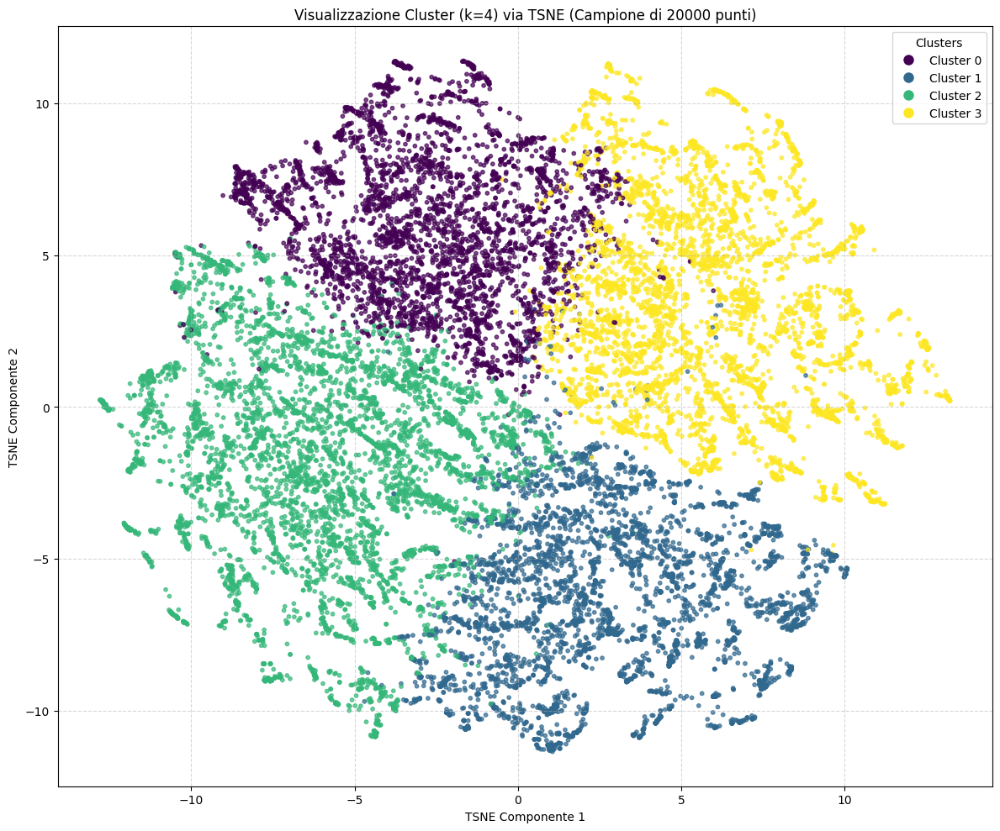


--- Script clustering attr_pca_7 terminato. ---


In [59]:
if __name__ == "__main__":

    if 'attr_pca_7' not in locals() or 'item_ids' not in locals() or 'df_attr_original' not in locals():
        print("ATTENZIONE: 'attr_pca_7', 'item_ids' o 'df_attr_original' non trovate.")
        print("Devi eseguire la cella PCA e assicurarti che queste variabili siano disponibili.")

        if 'df_attr_original' not in locals():
            df_attr_original = None # Per permettere allo script di girare senza errori sull'analisi attributi
        if 'attr_pca_7' not in locals() or 'item_ids' not in locals():
            raise ValueError("Devi fornire 'attr_pca_7' e 'item_ids' dalla cella precedente!")
    else:
        print(f"Trovato 'attr_pca_7' con shape: {attr_pca_7.shape}")
        print(f"Trovato 'item_ids' con lunghezza: {len(item_ids)}")
        if df_attr_original is not None:
             print(f"Trovato 'df_attr_original' con shape: {df_attr_original.shape}")
        else:
             print("Variabile 'df_attr_original' non trovata, l'analisi degli attributi originali per cluster verrà saltata.")


    # --- 1. DEFINE CONFIGURATION ---
    # Output directory per i risultati del clustering su attr_pca_7
    OUTPUT_DIR_attr_pca_7_CLUSTERS = "/content/drive/MyDrive/Data Analytics for Business/Progetto/clusters_output_attr_pca_7" # MODIFICA SE NECESSARIO

    # Parametri di clustering
    K_attr_pca_7 = 4  # Numero di cluster desiderato sui dati PCA degli attributi
    RANDOM_STATE_attr_pca_7 = 42
    RECOMPUTE_CLUSTERS_attr_pca_7 = False # True per forzare, False per caricare se esiste
    # Il nome del file di assegnazione ora include K per evitare sovrascritture se cambi K
    CLUSTER_ASSIGNMENTS_attr_pca_7_PATH = os.path.join(OUTPUT_DIR_attr_pca_7_CLUSTERS, f'attr_pca_7_cluster_assignments_k{K_attr_pca_7}.csv')

    # Opzioni di visualizzazione e analisi
    VISUALIZATION_METHOD_attr_pca_7 = 'tsne' # 'tsne' o 'pca' (t-SNE è spesso migliore su dati già PCA per visualizzazione)
    SAMPLE_SIZE_VIS_attr_pca_7 = 20000 # Campione per t-SNE/Silhouette

    # --- 2. CHECK DATI DI INPUT ---
    if attr_pca_7 is None or item_ids is None:
        print("Errore: 'attr_pca_7' o 'item_ids' non sono disponibili. Assicurati che la cella PCA sia stata eseguita.")
    else:
        print(f"\n--- Inizio clustering per dati 'attr_pca_7' (shape: {attr_pca_7.shape}) ---")

        data_for_clustering = attr_pca_7 # I dati su cui fare clustering
        current_ids_for_saving = item_ids # Gli ID da salvare con le etichette

        cluster_labels_attr_pca_7 = None
        # cluster_to_ids_map_attr_pca_7 = None # Non esplicitamente necessario qui, la funzione lo gestisce

        # --- 3. PERFORM OR LOAD CLUSTERING ---
        if RECOMPUTE_CLUSTERS_attr_pca_7 or not os.path.exists(CLUSTER_ASSIGNMENTS_attr_pca_7_PATH):
            if RECOMPUTE_CLUSTERS_attr_pca_7:
                 print(f"\nForzando riesecuzione K-Means per dati attr_pca_7 con k={K_attr_pca_7}...")
            else:
                 print(f"\nFile assegnazioni attr_pca_7 non trovato. Esecuzione K-Means con k={K_attr_pca_7}...")

            cluster_labels_computed, K_attr_pca_7 = perform_kmeans(data_for_clustering, K_attr_pca_7, RANDOM_STATE_attr_pca_7)
            if cluster_labels_computed is not None:
                 saved_ok = save_cluster_assignments_csv(current_ids_for_saving, cluster_labels_computed, CLUSTER_ASSIGNMENTS_attr_pca_7_PATH)
                 if saved_ok:
                      cluster_labels_attr_pca_7 = cluster_labels_computed
        else:
            loaded_labels, _, _ = load_cluster_assignments_csv(CLUSTER_ASSIGNMENTS_attr_pca_7_PATH, current_ids_for_saving)
            if loaded_labels is not None:
                cluster_labels_attr_pca_7 = loaded_labels
                if cluster_labels_attr_pca_7 is not None and len(cluster_labels_attr_pca_7) > 0:
                     actual_k = np.max(cluster_labels_attr_pca_7[cluster_labels_attr_pca_7 != -1]) + 1 if np.any(cluster_labels_attr_pca_7 != -1) else 0
                     if actual_k > 0 and actual_k != K_attr_pca_7:
                          print(f"Attenzione: K={K_attr_pca_7} differisce dai cluster caricati (k={actual_k}). Userò k={actual_k}.")
                          K_attr_pca_7 = actual_k

        # --- 4. PROCESS RESULTS (if clustering succeeded/loaded) ---
        if cluster_labels_attr_pca_7 is not None:
            # Passa df_attr_original per analizzare gli attributi originali
            _, _ = process_and_save_cluster_results_pca_attr(
                cluster_labels_attr_pca_7, current_ids_for_saving, df_attr_original, K_attr_pca_7, OUTPUT_DIR_attr_pca_7_CLUSTERS,
                save_lists=True
                )
            if PLOT_SCATTER_GRAPHS:
              # --- 5. CALCULATE SILHOUETTE SCORE ---
              silhouette_avg_attr_pca_7 = calculate_silhouette(
                  data_for_clustering, cluster_labels_attr_pca_7,
                  sample_size=SAMPLE_SIZE_VIS_attr_pca_7,
                  random_state=RANDOM_STATE_attr_pca_7)

              # --- 6. REDUCE DIMENSIONS FOR VISUALIZATION & PLOT ---
              # Applicheremo t-SNE (o PCA di visualizzazione) ai dati *già ridotti* da attr_pca_7
              data_2d_viz, labels_for_plot_viz, plot_title_suffix_viz = reduce_dimensions_for_visualization(
                  data_for_clustering, cluster_labels_attr_pca_7,
                  method=VISUALIZATION_METHOD_attr_pca_7,
                  sample_size=SAMPLE_SIZE_VIS_attr_pca_7,
                  random_state=RANDOM_STATE_attr_pca_7
              )

              if data_2d_viz is not None:
                  plot_clusters(
                      data_2d_viz, labels_for_plot_viz, K_attr_pca_7,
                      method_name=VISUALIZATION_METHOD_attr_pca_7,
                      title_suffix=plot_title_suffix_viz,
                      output_dir=OUTPUT_DIR_attr_pca_7_CLUSTERS,
                      file_prefix="attr_pca_7_" # Per distinguere i file salvati
                  )
              else:
                    print("Visualizzazione scatter plot saltata per dati attr_pca_7 a causa di errori.")
            else:
              print("Visualizzazione Scatter Plot non abilitata PLOT_SCATTER_GRAPH = False")
        else:
            print("\nClustering per dati attr_pca_7 non eseguito o fallito.")

    print("\n--- Script clustering attr_pca_7 terminato. ---")

#### Clustering con PCA a 4 componenti

In [60]:
components=4
attr_pca_4 = apply_pca_transform(attr_dropped, components)



Applicazione della trasformazione PCA per mantenere 4 componenti...
Trasformazione completata. Nuova shape dei dati: (202599, 4)
Varianza totale spiegata da 4 componenti: 0.4191


Trovato 'attr_pca_4' con shape: (202599, 4)
Trovato 'item_ids' con lunghezza: 202599
Variabile 'df_attr_original' non trovata, l'analisi degli attributi originali per cluster verrà saltata.

--- Inizio clustering per dati 'attr_pca_4' (shape: (202599, 4)) ---

CARICAMENTO assegnazioni cluster CSV esistenti da: /content/drive/MyDrive/Data Analytics for Business/Progetto/clusters_output_attr_pca_4/attr_pca_4_cluster_assignments_k4.csv
Assegnazioni caricate. Numero di righe: 202599
Etichette cluster (1D int) ricostruite.
Mappa cluster -> ID ricostruita.

Analisi e salvataggio risultati cluster (dati attr. PCA):
Numero di elementi per cluster (validi): [(np.int64(0), 61373), (np.int64(1), 44800), (np.int64(2), 55613), (np.int64(3), 40813)]

--- Cluster 0 (61373 elementi) ---
  Lista ID salvata in: /content/drive/MyDrive/Data Analytics for Business/Progetto/clusters_output_attr_pca_4/attr_pca_cluster_0_ids.txt

--- Cluster 1 (44800 elementi) ---
  Lista ID salvata in: /content/drive/MyDrive

/usr/local/lib/python3.11/dist-packages/sklearn/manifold/_t_sne.py:1164: FutureWarning: 'n_iter' was renamed to 'max_iter' in version 1.5 and will be removed in 1.7.
  warnings.warn(


Riduzione dimensionale per visualizzazione (TSNE) completata.


<ipython-input-55-afc4f3e0c5f9>:189: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = plt.cm.get_cmap('viridis', k)


Scatter plot salvato: /content/drive/MyDrive/Data Analytics for Business/Progetto/clusters_output_attr_pca_4/attr_pca_4_cluster_visualization_tsne_k4.png


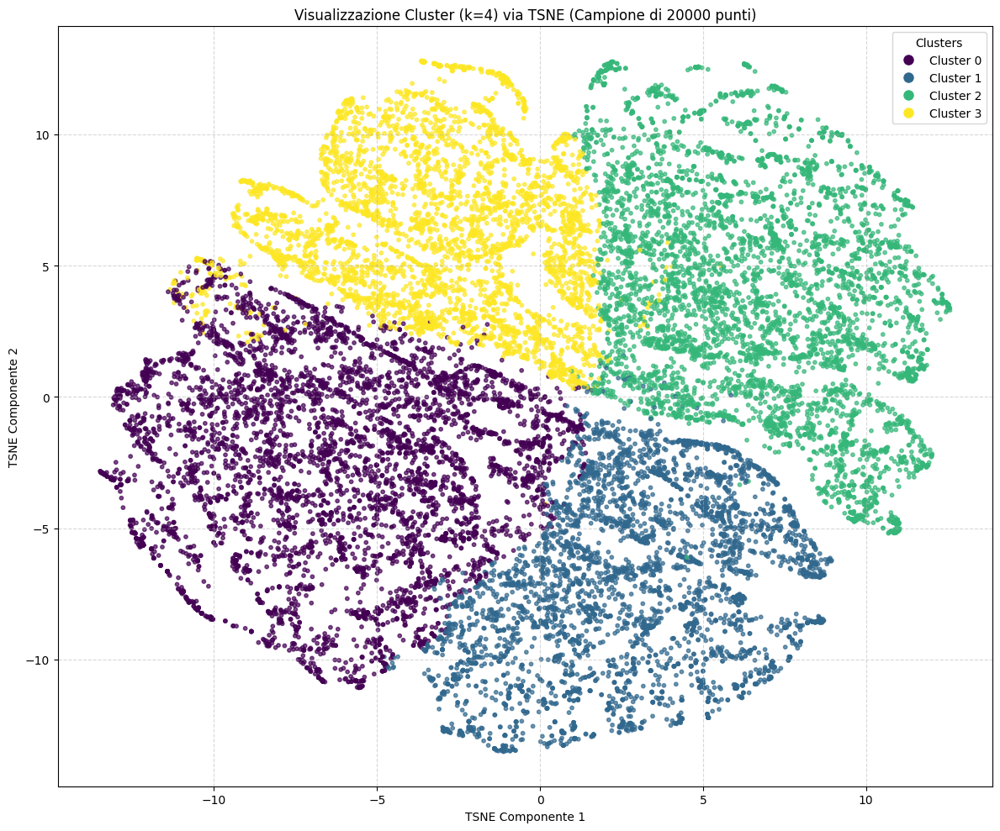


--- Script clustering attr_pca_4 terminato. ---


In [61]:
if __name__ == "__main__":

    if 'attr_pca_4' not in locals() or 'item_ids' not in locals() or 'df_attr_original' not in locals():
        print("ATTENZIONE: 'attr_pca_4', 'item_ids' o 'df_attr_original' non trovate.")
        print("Devi eseguire la cella PCA e assicurarti che queste variabili siano disponibili.")
        if 'df_attr_original' not in locals():
            df_attr_original = None # Per permettere allo script di girare senza errori sull'analisi attributi
        if 'attr_pca_4' not in locals() or 'item_ids' not in locals():
            raise ValueError("Devi fornire 'attr_pca_4' e 'item_ids' dalla cella precedente!")
    else:
        print(f"Trovato 'attr_pca_4' con shape: {attr_pca_4.shape}")
        print(f"Trovato 'item_ids' con lunghezza: {len(item_ids)}")
        if df_attr_original is not None:
             print(f"Trovato 'df_attr_original' con shape: {df_attr_original.shape}")
        else:
             print("Variabile 'df_attr_original' non trovata, l'analisi degli attributi originali per cluster verrà saltata.")


    # --- 1. DEFINE CONFIGURATION ---
    # Output directory per i risultati del clustering su attr_pca_4
    OUTPUT_DIR_attr_pca_4_CLUSTERS = "/content/drive/MyDrive/Data Analytics for Business/Progetto/clusters_output_attr_pca_4" # MODIFICA SE NECESSARIO

    # Parametri di clustering
    K_attr_pca_4 = 4  # Numero di cluster desiderato sui dati PCA degli attributi
    RANDOM_STATE_attr_pca_4 = 42
    RECOMPUTE_CLUSTERS_attr_pca_4 = False # True per forzare, False per caricare se esiste
    # Il nome del file di assegnazione ora include K per evitare sovrascritture se cambi K
    CLUSTER_ASSIGNMENTS_attr_pca_4_PATH = os.path.join(OUTPUT_DIR_attr_pca_4_CLUSTERS, f'attr_pca_4_cluster_assignments_k{K_attr_pca_4}.csv')

    # Opzioni di visualizzazione e analisi
    VISUALIZATION_METHOD_attr_pca_4 = 'tsne' # 'tsne' o 'pca' (t-SNE è spesso migliore su dati già PCA per visualizzazione)
    SAMPLE_SIZE_VIS_attr_pca_4 = 20000 # Campione per t-SNE/Silhouette

    # --- 2. CHECK DATI DI INPUT ---
    if attr_pca_4 is None or item_ids is None:
        print("Errore: 'attr_pca_4' o 'item_ids' non sono disponibili. Assicurati che la cella PCA sia stata eseguita.")
    else:
        print(f"\n--- Inizio clustering per dati 'attr_pca_4' (shape: {attr_pca_4.shape}) ---")

        data_for_clustering = attr_pca_4 # I dati su cui fare clustering
        current_ids_for_saving = item_ids # Gli ID da salvare con le etichette

        cluster_labels_attr_pca_4 = None
        # cluster_to_ids_map_attr_pca_4 = None # Non esplicitamente necessario qui, la funzione lo gestisce

        # --- 3. PERFORM OR LOAD CLUSTERING ---
        if RECOMPUTE_CLUSTERS_attr_pca_4 or not os.path.exists(CLUSTER_ASSIGNMENTS_attr_pca_4_PATH):
            if RECOMPUTE_CLUSTERS_attr_pca_4:
                 print(f"\nForzando riesecuzione K-Means per dati attr_pca_4 con k={K_attr_pca_4}...")
            else:
                 print(f"\nFile assegnazioni attr_pca_4 non trovato. Esecuzione K-Means con k={K_attr_pca_4}...")

            cluster_labels_computed, K_attr_pca_4 = perform_kmeans(data_for_clustering, K_attr_pca_4, RANDOM_STATE_attr_pca_4)
            if cluster_labels_computed is not None:
                 saved_ok = save_cluster_assignments_csv(current_ids_for_saving, cluster_labels_computed, CLUSTER_ASSIGNMENTS_attr_pca_4_PATH)
                 if saved_ok:
                      cluster_labels_attr_pca_4 = cluster_labels_computed
        else:
            loaded_labels, _, _ = load_cluster_assignments_csv(CLUSTER_ASSIGNMENTS_attr_pca_4_PATH, current_ids_for_saving)
            if loaded_labels is not None:
                cluster_labels_attr_pca_4 = loaded_labels
                if cluster_labels_attr_pca_4 is not None and len(cluster_labels_attr_pca_4) > 0:
                     actual_k = np.max(cluster_labels_attr_pca_4[cluster_labels_attr_pca_4 != -1]) + 1 if np.any(cluster_labels_attr_pca_4 != -1) else 0
                     if actual_k > 0 and actual_k != K_attr_pca_4:
                          print(f"Attenzione: K={K_attr_pca_4} differisce dai cluster caricati (k={actual_k}). Userò k={actual_k}.")
                          K_attr_pca_4 = actual_k

        # --- 4. PROCESS RESULTS (if clustering succeeded/loaded) ---
        if cluster_labels_attr_pca_4 is not None:
            # Passa df_attr_original per analizzare gli attributi originali
            _, _ = process_and_save_cluster_results_pca_attr(
                cluster_labels_attr_pca_4, current_ids_for_saving, df_attr_original, K_attr_pca_4, OUTPUT_DIR_attr_pca_4_CLUSTERS,
                save_lists=True
            )
            if PLOT_SCATTER_GRAPHS:
              # --- 5. CALCULATE SILHOUETTE SCORE ---
              silhouette_avg_attr_pca_4 = calculate_silhouette(
                  data_for_clustering, cluster_labels_attr_pca_4,
                  sample_size=SAMPLE_SIZE_VIS_attr_pca_4,
                  random_state=RANDOM_STATE_attr_pca_4)

              # --- 6. REDUCE DIMENSIONS FOR VISUALIZATION & PLOT ---
              # Applicheremo t-SNE (o PCA di visualizzazione) ai dati *già ridotti* da attr_pca_4
              data_2d_viz, labels_for_plot_viz, plot_title_suffix_viz = reduce_dimensions_for_visualization(
                  data_for_clustering, cluster_labels_attr_pca_4,
                  method=VISUALIZATION_METHOD_attr_pca_4,
                  sample_size=SAMPLE_SIZE_VIS_attr_pca_4,
                  random_state=RANDOM_STATE_attr_pca_4)

              if data_2d_viz is not None:
                  plot_clusters(
                      data_2d_viz, labels_for_plot_viz, K_attr_pca_4,
                      method_name=VISUALIZATION_METHOD_attr_pca_4,
                      title_suffix=plot_title_suffix_viz,
                      output_dir=OUTPUT_DIR_attr_pca_4_CLUSTERS,
                      file_prefix="attr_pca_4_" # Per distinguere i file salvati
                      )
              else:
                    print("Visualizzazione scatter plot saltata per dati attr_pca_4 a causa di errori.")
            else:
              print("Visualizzazione Scatter Plot non abilitata PLOT_SCATTER_GRAPH = False")
        else:
            print("\nClustering per dati attr_pca_4 non eseguito o fallito.")

    print("\n--- Script clustering attr_pca_4 terminato. ---")

#### Clustering con PCA a 2 componenti

In [62]:
components=2
attr_pca_2 = apply_pca_transform(attr_dropped, components)


Applicazione della trasformazione PCA per mantenere 2 componenti...
Trasformazione completata. Nuova shape dei dati: (202599, 2)
Varianza totale spiegata da 2 componenti: 0.3083


Trovato 'attr_pca_2' con shape: (202599, 2)
Trovato 'item_ids' con lunghezza: 202599
Variabile 'df_attr_original' non trovata, l'analisi degli attributi originali per cluster verrà saltata.

--- Inizio clustering per dati 'attr_pca_2' (shape: (202599, 2)) ---

CARICAMENTO assegnazioni cluster CSV esistenti da: /content/drive/MyDrive/Data Analytics for Business/Progetto/clusters_output_attr_pca_2/attr_pca_2_cluster_assignments_k4.csv
Assegnazioni caricate. Numero di righe: 202599
Etichette cluster (1D int) ricostruite.
Mappa cluster -> ID ricostruita.

Analisi e salvataggio risultati cluster (dati attr. PCA):
Numero di elementi per cluster (validi): [(np.int64(0), 41319), (np.int64(1), 44961), (np.int64(2), 55726), (np.int64(3), 60593)]

--- Cluster 0 (41319 elementi) ---
  Lista ID salvata in: /content/drive/MyDrive/Data Analytics for Business/Progetto/clusters_output_attr_pca_2/attr_pca_cluster_0_ids.txt

--- Cluster 1 (44961 elementi) ---
  Lista ID salvata in: /content/drive/MyDrive

/usr/local/lib/python3.11/dist-packages/sklearn/manifold/_t_sne.py:1164: FutureWarning: 'n_iter' was renamed to 'max_iter' in version 1.5 and will be removed in 1.7.
  warnings.warn(


Riduzione dimensionale per visualizzazione (TSNE) completata.


<ipython-input-55-afc4f3e0c5f9>:189: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = plt.cm.get_cmap('viridis', k)


Scatter plot salvato: /content/drive/MyDrive/Data Analytics for Business/Progetto/clusters_output_attr_pca_2/attr_pca_2_cluster_visualization_tsne_k4.png


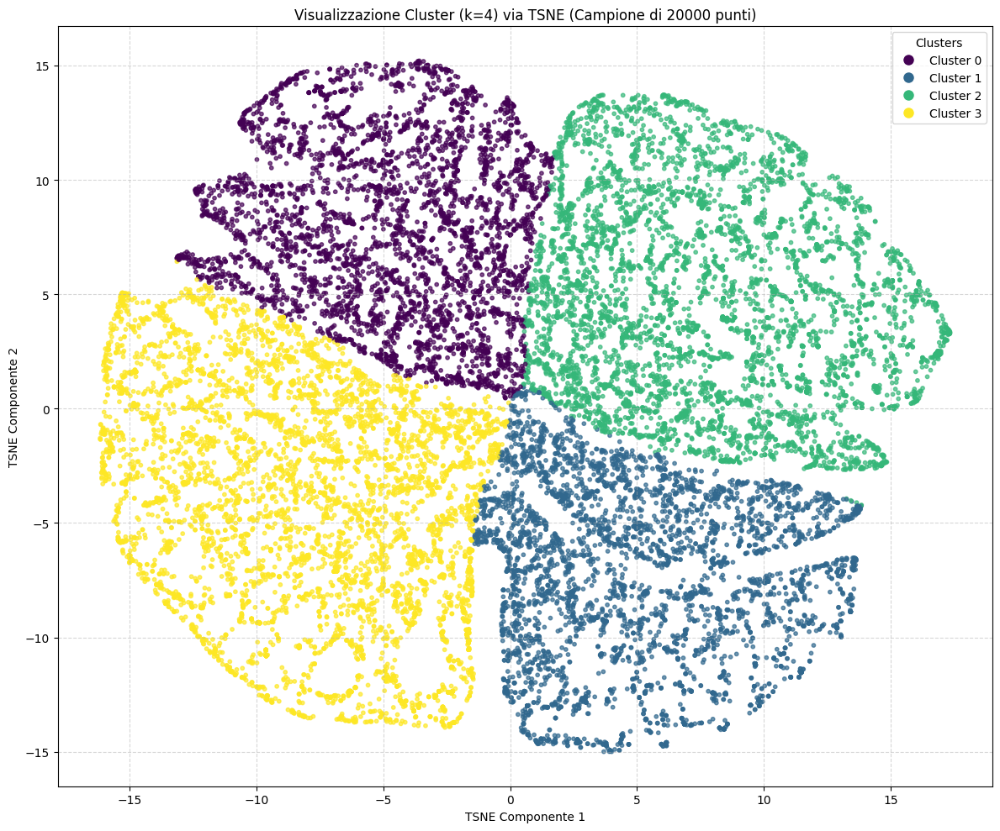


--- Script clustering attr_pca_2 terminato. ---


In [63]:
if __name__ == "__main__":

    if 'attr_pca_2' not in locals() or 'item_ids' not in locals() or 'df_attr_original' not in locals():
        print("ATTENZIONE: 'attr_pca_2', 'item_ids' o 'df_attr_original' non trovate.")
        print("Devi eseguire la cella PCA e assicurarti che queste variabili siano disponibili.")
        if 'df_attr_original' not in locals():
            df_attr_original = None # Per permettere allo script di girare senza errori sull'analisi attributi
        if 'attr_pca_4' not in locals() or 'item_ids' not in locals():
            raise ValueError("Devi fornire 'attr_pca_2' e 'item_ids' dalla cella precedente!")
    else:
        print(f"Trovato 'attr_pca_2' con shape: {attr_pca_2.shape}")
        print(f"Trovato 'item_ids' con lunghezza: {len(item_ids)}")
        if df_attr_original is not None:
             print(f"Trovato 'df_attr_original' con shape: {df_attr_original.shape}")
        else:
             print("Variabile 'df_attr_original' non trovata, l'analisi degli attributi originali per cluster verrà saltata.")


    # --- 1. DEFINE CONFIGURATION ---
    # Output directory per i risultati del clustering su attr_pca_2
    OUTPUT_DIR_attr_pca_2_CLUSTERS = "/content/drive/MyDrive/Data Analytics for Business/Progetto/clusters_output_attr_pca_2" # MODIFICA SE NECESSARIO

    # Parametri di clustering
    K_attr_pca_2 = 4  # Numero di cluster desiderato sui dati PCA degli attributi
    RANDOM_STATE_attr_pca_2 = 42
    RECOMPUTE_CLUSTERS_attr_pca_2 = False # True per forzare, False per caricare se esiste
    # Il nome del file di assegnazione ora include K per evitare sovrascritture se cambi K
    CLUSTER_ASSIGNMENTS_attr_pca_2_PATH = os.path.join(OUTPUT_DIR_attr_pca_2_CLUSTERS, f'attr_pca_2_cluster_assignments_k{K_attr_pca_2}.csv')

    # Opzioni di visualizzazione e analisi
    VISUALIZATION_METHOD_attr_pca_2 = 'tsne' # 'tsne' o 'pca' (t-SNE è spesso migliore su dati già PCA per visualizzazione)
    SAMPLE_SIZE_VIS_attr_pca_2 = 20000 # Campione per t-SNE/Silhouette

    # --- 2. CHECK DATI DI INPUT ---
    if attr_pca_2 is None or item_ids is None:
        print("Errore: 'attr_pca_2' o 'item_ids' non sono disponibili. Assicurati che la cella PCA sia stata eseguita.")
    else:
        print(f"\n--- Inizio clustering per dati 'attr_pca_2' (shape: {attr_pca_2.shape}) ---")

        data_for_clustering = attr_pca_2 # I dati su cui fare clustering
        current_ids_for_saving = item_ids # Gli ID da salvare con le etichette

        cluster_labels_attr_pca_2 = None
        # cluster_to_ids_map_attr_pca_2 = None # Non esplicitamente necessario qui, la funzione lo gestisce

        # --- 3. PERFORM OR LOAD CLUSTERING ---
        if RECOMPUTE_CLUSTERS_attr_pca_2 or not os.path.exists(CLUSTER_ASSIGNMENTS_attr_pca_2_PATH):
            if RECOMPUTE_CLUSTERS_attr_pca_2:
                 print(f"\nForzando riesecuzione K-Means per dati attr_pca_2 con k={K_attr_pca_2}...")
            else:
                 print(f"\nFile assegnazioni attr_pca_2 non trovato. Esecuzione K-Means con k={K_attr_pca_2}...")

            cluster_labels_computed, K_attr_pca_2 = perform_kmeans(data_for_clustering, K_attr_pca_2, RANDOM_STATE_attr_pca_2)
            if cluster_labels_computed is not None:
                 saved_ok = save_cluster_assignments_csv(current_ids_for_saving, cluster_labels_computed, CLUSTER_ASSIGNMENTS_attr_pca_2_PATH)
                 if saved_ok:
                      cluster_labels_attr_pca_2 = cluster_labels_computed
        else:
            loaded_labels, _, _ = load_cluster_assignments_csv(CLUSTER_ASSIGNMENTS_attr_pca_2_PATH, current_ids_for_saving)
            if loaded_labels is not None:
                cluster_labels_attr_pca_2 = loaded_labels
                if cluster_labels_attr_pca_2 is not None and len(cluster_labels_attr_pca_2) > 0:
                     actual_k = np.max(cluster_labels_attr_pca_2[cluster_labels_attr_pca_2 != -1]) + 1 if np.any(cluster_labels_attr_pca_2 != -1) else 0
                     if actual_k > 0 and actual_k != K_attr_pca_2:
                          print(f"Attenzione: K={K_attr_pca_2} differisce dai cluster caricati (k={actual_k}). Userò k={actual_k}.")
                          K_attr_pca_2 = actual_k

        # --- 4. PROCESS RESULTS (if clustering succeeded/loaded) ---
        if cluster_labels_attr_pca_2 is not None:
            # Passa df_attr_original per analizzare gli attributi originali
            _, _ = process_and_save_cluster_results_pca_attr(
                cluster_labels_attr_pca_2, current_ids_for_saving, df_attr_original, K_attr_pca_2, OUTPUT_DIR_attr_pca_2_CLUSTERS,
                save_lists=True)

            if PLOT_SCATTER_GRAPHS:
              # --- 5. CALCULATE SILHOUETTE SCORE ---
              silhouette_avg_attr_pca_2 = calculate_silhouette(
                  data_for_clustering, cluster_labels_attr_pca_2,
                  sample_size=SAMPLE_SIZE_VIS_attr_pca_2,
                  random_state=RANDOM_STATE_attr_pca_2
              )

              # --- 6. REDUCE DIMENSIONS FOR VISUALIZATION & PLOT ---
              # Applicheremo t-SNE (o PCA di visualizzazione) ai dati *già ridotti* da attr_pca_2
              data_2d_viz, labels_for_plot_viz, plot_title_suffix_viz = reduce_dimensions_for_visualization(
                  data_for_clustering, cluster_labels_attr_pca_2,
                  method=VISUALIZATION_METHOD_attr_pca_2,
                  sample_size=SAMPLE_SIZE_VIS_attr_pca_2,
                  random_state=RANDOM_STATE_attr_pca_2
              )

              if data_2d_viz is not None:
                  plot_clusters(
                      data_2d_viz, labels_for_plot_viz, K_attr_pca_2,
                      method_name=VISUALIZATION_METHOD_attr_pca_2,
                      title_suffix=plot_title_suffix_viz,
                      output_dir=OUTPUT_DIR_attr_pca_2_CLUSTERS,
                      file_prefix="attr_pca_2_" # Per distinguere i file salvati
                  )
              else:
                    print("Visualizzazione scatter plot saltata per dati attr_pca_2 a causa di errori.")
            else:
              print("Visualizzazione Scatter Plot non abilitata PLOT_SCATTER_GRAPH = False")
        else:
          print("\nClustering per dati attr_pca_2 non eseguito o fallito.")


    print("\n--- Script clustering attr_pca_2 terminato. ---")

# Approccio basato su Anzalone et al.

Dopo una prima fase di esplorazione del dataset e clustering effettuato sugli embedding diretti delle immagini (es. tramite FaceNet), abbiamo scelto di adottare un approccio più mirato, focalizzandoci sulla rappresentazione semantica dei volti attraverso i loro attributi facciali.

Ispirandoci al lavoro di Anzalone et al., **"Transfer Learning for Facial Attributes Prediction and Clustering"**, abbiamo utilizzato i pesi pubblicati del loro modello fine-tunato (es. `weights-FC37-MobileNetV2-0.92.hdf5`) per predire 37 attributi facciali su tutte le immagini del dataset CelebA (oltre 200.000 volti). Questo ci ha permesso di ottenere un vettore binario per ogni immagine, evitando il dispendioso processo di addestramento da zero.

Le predizioni ottenute non rappresentano embedding generici per il riconoscimento facciale, come ottenuto nell'Approccio baseline esplorato sopra, ma sono il risultato diretto di una rete neurale progettata per classificare **attributi facciali** (multi-label classification). Ogni immagine è rappresentata da un vettore binario di 37 elementi, corrispondenti alla presenza o assenza di attributi come `Smiling`, `Male`, `Eyeglasses`, `Blond_Hair`, ecc.

Il modello di Anzalone et al. è basato su **MobileNetV2**, modificato con l’aggiunta di un layer `Dense` da 37 neuroni, ciascuno attivato tramite funzione sigmoide. L’output continuo di ciascun neurone è una probabilità stimata che l’attributo sia presente:

$$
\hat{y}_j = \sigma(z_j) = \frac{1}{1 + e^{-z_j}}
$$

Dove $\hat{y}_j$ è l’output probabilistico per l’attributo $j$, e $z_j$ è l’input lineare del neurone.

Questi output sono stati **sogliati a 0.5** per ottenere le predizioni binarie:

$$
\hat{\mathbf{y}} = [\text{round}(\hat{y}_1), \text{round}(\hat{y}_2), \dots, \text{round}(\hat{y}_{37})]
$$

Ogni immagine è quindi rappresentata da un vettore binario 37-D, utilizzabile come base per analisi di clustering semantico.

Il modello è stato addestrato utilizzando la **Cosine Proximity** come funzione di perdita, adatta a problemi multi-label con output sparsi. È definita come:

$$
L = - \frac{\mathbf{y} \cdot \hat{\mathbf{y}}}{\|\mathbf{y}\|_2 \cdot \|\hat{\mathbf{y}}\|_2}
$$

dove:
- $\mathbf{y}$ è il vettore binario delle etichette reali (ground truth),
- $\hat{\mathbf{y}}$ è il vettore di probabilità predette dal modello.

Questa funzione massimizza l’allineamento tra le direzioni dei due vettori, trattandoli come punti in uno spazio vettoriale.

Le predizioni binarie, ottenute in ambiente locale per ragioni di efficienza computazionale, verranno ora utilizzate per:
- effettuare un’analisi di **clustering** basata sulla similarità tra attributi espliciti;
- investigare la presenza di **bias** nei dati o nelle predizioni del modello, valutando l’equità rispetto a gruppi demografici o tratti specifici.

L’obiettivo è comprendere se e come i volti si raggruppano in base a caratteristiche condivise e verificare la robustezza semantica del modello.

Gli autori del paper di Anzalone et al. hanno effettuato predizioni su un campione di 2000 immagini preso dall'intera collezione di CelebA, senza filtraggio basato sulla partizione ufficiale training/validation/test.

Nel nostro approccio invece le predizioni hanno riguardato l'intero dataset, ottenendo per un Error Ratio ed una Accuracy, i cui risultati sono riportati nei grafici sotto, molto simili a quelle di Anzalone et al.

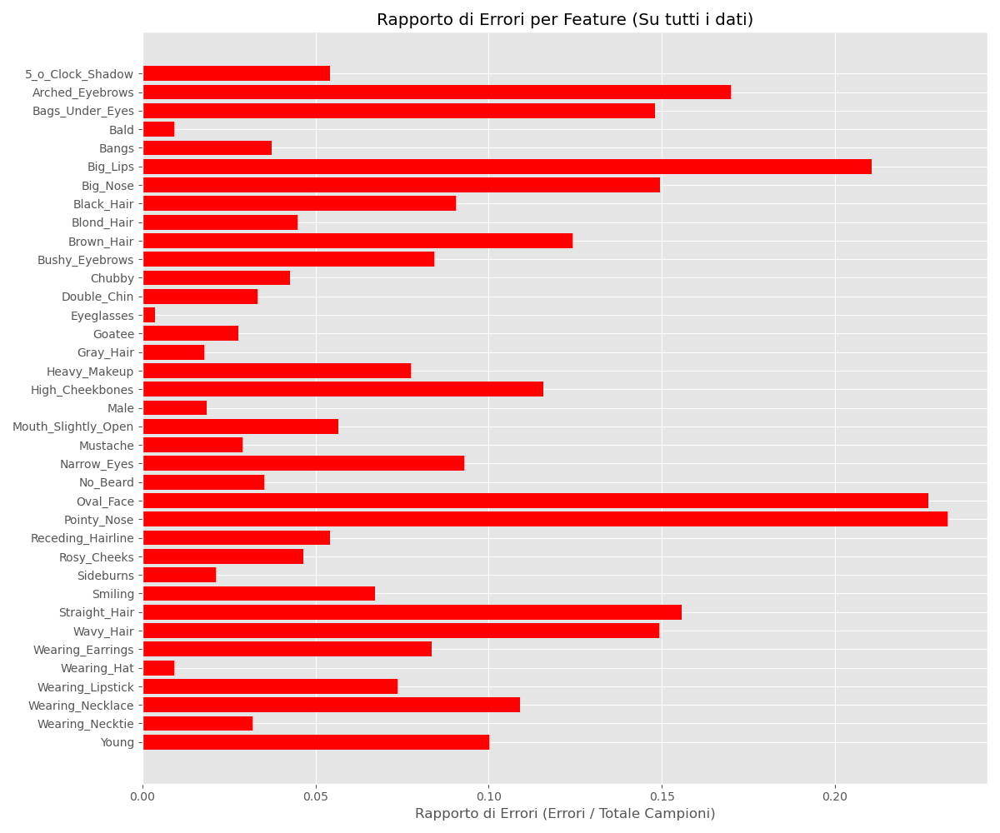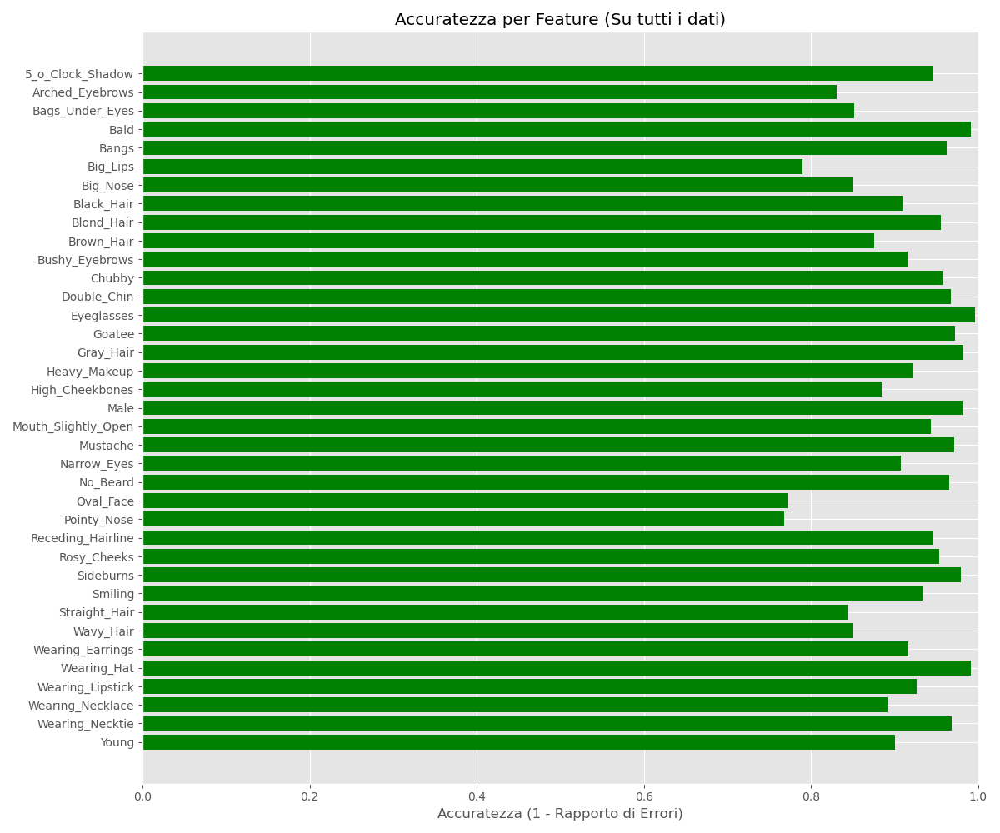

Per ragioni computazionali non è stato possibile in questo notebook replicare la stima del numero ottimale di cluster tramite l’algoritmo DBSCAN, che consente di determinare automaticamente la struttura dei cluster a partire dalla densità dei dati.

Di conseguenza, negli esperimenti successivi adotteremo direttamente il numero di cluster identificato nel loro studio. Verificheremo quindi se, utilizzando tale valore, è possibile ottenere uno **Silhouette Score** comparabile a quello riportato dagli autori, valutando così la coerenza e l’efficacia del nostro pipeline di clustering.


In [64]:
PROJECT_PATH="/content/drive/MyDrive/Data Analytics for Business/Progetto"
NEW_PATH=os.path.join(PROJECT_PATH, "all_images_predicted_powerbi.csv")

pred_attr= pd.read_csv(NEW_PATH, sep=";")

In [65]:
pred_attr.head()

,image_id,5_o_Clock_Shadow_pred,Arched_Eyebrows_pred,Bags_Under_Eyes_pred,Bald_pred,Bangs_pred,Big_Lips_pred,Big_Nose_pred,Black_Hair_pred,Blond_Hair_pred,...,Sideburns_pred,Smiling_pred,Straight_Hair_pred,Wavy_Hair_pred,Wearing_Earrings_pred,Wearing_Hat_pred,Wearing_Lipstick_pred,Wearing_Necklace_pred,Wearing_Necktie_pred,Young_pred
0,000001.jpg,0,0,0,0,0,0,0,0,0,...,0,1,1,0,0,0,1,0,0,1
1,000002.jpg,0,0,1,0,0,0,0,0,0,...,0,1,0,0,0,0,0,0,0,1
2,000003.jpg,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,1
3,000004.jpg,0,0,0,0,0,0,0,0,0,...,0,0,1,0,0,0,0,0,0,1
4,000005.jpg,0,1,0,0,0,0,0,0,0,...,0,0,0,0,0,0,1,0,0,1


In [66]:
pred_attr.info()



<class 'pandas.core.frame.DataFrame'>
RangeIndex: 202599 entries, 0 to 202598
Data columns (total 38 columns):
 #   Column                    Non-Null Count   Dtype 
---  ------                    --------------   ----- 
 0   image_id                  202599 non-null  object
 1   5_o_Clock_Shadow_pred     202599 non-null  int64 
 2   Arched_Eyebrows_pred      202599 non-null  int64 
 3   Bags_Under_Eyes_pred      202599 non-null  int64 
 4   Bald_pred                 202599 non-null  int64 
 5   Bangs_pred                202599 non-null  int64 
 6   Big_Lips_pred             202599 non-null  int64 
 7   Big_Nose_pred             202599 non-null  int64 
 8   Black_Hair_pred           202599 non-null  int64 
 9   Blond_Hair_pred           202599 non-null  int64 
 10  Brown_Hair_pred           202599 non-null  int64 
 11  Bushy_Eyebrows_pred       202599 non-null  int64 
 12  Chubby_pred               202599 non-null  int64 
 13  Double_Chin_pred          202599 non-null  int64 
 14  Eyeg

In [67]:
pred_attr_cluster=pred_attr.drop("image_id", axis=1)

In [68]:
variance_by_feature_pred = pred_attr_cluster.var()

variance_by_feature_pred.sort_values(ascending=False)

,0
Smiling_pred,0.249529
Mouth_Slightly_Open_pred,0.249392
Wearing_Lipstick_pred,0.245768
Male_pred,0.245159
High_Cheekbones_pred,0.241667
Heavy_Makeup_pred,0.230306
Pointy_Nose_pred,0.179585
Bags_Under_Eyes_pred,0.176853
Wavy_Hair_pred,0.173988
Black_Hair_pred,0.168498


In [69]:
import gc

# --- PARAMETRI GLOBALI E CONFIGURAZIONE ---

PROJECT_PATH = "/content/drive/MyDrive/Data Analytics for Business/Progetto" # MODIFICA QUESTO!
KMEANS_N_INIT_GLOBAL = 10
KMEANS_RANDOM_STATE_GLOBAL = 42

# Parametri Silhouette (possono essere globali o passati)
SILHOUETTE_SAMPLE_SIZE_GLOBAL = 20000
SILHOUETTE_RANDOM_STATE_GLOBAL = 42

RECOMPUTE_KMEANS_CLUSTERS = False #vale sia per esperimenti qui che per Anzalone
# Parametri per la visualizzazione
VISUALIZATION_METHOD = 'tsne' # o 'pca'
VISUALIZE_SAMPLE_ONLY = True # Per t-SNE/Silhouette su campione
SAMPLE_SIZE_VIS = 20000      # Dimensione campione per visualizzazione
NUM_SAMPLES_TO_SHOW_IMG = 9  # Numero di immagini per cluster da visualizzare

# --- FUNZIONI HELPER ---

def run_direct_kmeans(data_matrix, n_clusters, n_init, random_state):
    """
    Esegue K-Means clustering sull'intero data_matrix con un numero specificato di cluster.
    """
    if n_clusters < 2:
        print(f"ERRORE: K-Means richiede almeno 2 cluster. Ricevuto: {n_clusters}")
        return None, None

    print(f"\n--- Esecuzione K-Means (n_clusters={n_clusters}) ---")
    kmeans = KMeans(n_clusters=n_clusters,
                    init='k-means++',
                    n_init=n_init,
                    random_state=random_state,
                    max_iter=300, # Valore di default, può essere aggiustato
                    verbose=0)    # Imposta a 1 per vedere i log di K-Means durante l'esecuzione
    try:
        kmeans_labels = kmeans.fit_predict(data_matrix)
        inertia = kmeans.inertia_
    except MemoryError:
        print("ERRORE DI MEMORIA durante KMeans.fit_predict.")
        print("Questo è insolito per K-Means con un numero moderato di feature, a meno che n_clusters non sia molto alto o il dataset sia estremamente grande.")
        return None, None
    except Exception as e:
        print(f"Errore generico durante K-Means: {e}")
        return None, None

    print(f"K-Means completato. Inerzia: {inertia:.2f}")
    return kmeans_labels, inertia

def calculate_silhouette_for_kmeans(data_matrix, labels, sample_size=None, random_state=None):
    """
    Calcola il Silhouette Score per i risultati di K-Means.
    """
    print("\n--- Calcolo Silhouette Score per K-Means ---")
    if labels is None:
        print("Etichette K-Means non disponibili per il calcolo del Silhouette Score.")
        return None

    unique_cluster_labels = np.unique(labels)
    # Silhouette score richiede almeno 2 etichette (cluster) e al massimo n_samples-1 etichette.
    if len(unique_cluster_labels) < 2 or len(unique_cluster_labels) > len(data_matrix) - 1:
        print(f"Silhouette Score non calcolabile: numero di etichette uniche ({len(unique_cluster_labels)}) non valido per {len(data_matrix)} campioni.")
        return None

    use_data = data_matrix
    use_labels = labels
    operation_target_description = f"tutti i {len(data_matrix)} punti"

    if sample_size is not None and len(data_matrix) > sample_size:
        if sample_size < 2: # Impossibile calcolare silhouette
            print(f"Dimensione campione ({sample_size}) troppo piccola per Silhouette. Uso tutti i punti.")
        else:
            print(f"Campionamento di {sample_size} punti su {len(data_matrix)} per Silhouette Score...")
            np.random.seed(random_state) # Per riproducibilità del campionamento
            indices = np.random.choice(len(data_matrix), sample_size, replace=False)
            use_data = data_matrix[indices]
            use_labels = labels[indices]

            unique_sample_labels = np.unique(use_labels)
            if len(unique_sample_labels) < 2 or len(unique_sample_labels) > len(use_data) - 1:
                 print(f"Silhouette Score non calcolabile sul campione: numero di etichette uniche nel campione ({len(unique_sample_labels)}) non valido per {len(use_data)} campioni campionati.")
                 return None
            operation_target_description = f"campione di {len(use_data)} punti"
    else:
         print(f"Utilizzo di {operation_target_description} per Silhouette Score...")

    try:
        score = silhouette_score(use_data, use_labels, metric='hamming') # Assumendo dati binari e metrica hamming
        print(f"Silhouette Score (calcolato su {operation_target_description}): {score:.4f}")
    except MemoryError:
        print("ERRORE DI MEMORIA durante il calcolo del Silhouette Score.")
        print("Prova a ridurre ulteriormente SILHOUETTE_SAMPLE_SIZE_GLOBAL.")
        return None
    except ValueError as ve:
        print(f"ERRORE di Valore durante il calcolo del Silhouette Score: {ve}")
        print("Questo può accadere se ci sono pochi campioni per cluster nel campione selezionato o se tutte le etichette sono uguali.")
        return None
    except Exception as e:
        print(f"Errore generico durante il calcolo del Silhouette Score: {e}")
        return None
    return score

# --- FUNZIONE PRINCIPALE DI CLUSTERING K-MEANS DIRETTO ---


def perform_direct_kmeans_clustering(input_df,
                                     num_k_clusters,
                                     df_name_for_output="dataset_kmeans",
                                     # Aggiungi RECOMPUTE_FLAG come parametro opzionale
                                     recompute_flag=RECOMPUTE_KMEANS_CLUSTERS,
                                     kmeans_n_init=KMEANS_N_INIT_GLOBAL,
                                     kmeans_random_state=KMEANS_RANDOM_STATE_GLOBAL,
                                     silhouette_sample_size=SILHOUETTE_SAMPLE_SIZE_GLOBAL,
                                     silhouette_random_state=SILHOUETTE_RANDOM_STATE_GLOBAL):
    """
    Esegue K-Means clustering o carica risultati esistenti.
    Salva il DataFrame con le etichette dei cluster.
    """
    print(f"\n{'='*10} GESTIONE K-MEANS PER: {df_name_for_output} (k={num_k_clusters}) {'='*10}")

    # ... (codice per gestione output directory e controlli input_df invariato) ...
    if not PROJECT_PATH or not os.path.exists(os.path.dirname(PROJECT_PATH) if os.path.dirname(PROJECT_PATH) else PROJECT_PATH):
        print(f"ERRORE: PROJECT_PATH ('{PROJECT_PATH}') non valido o non accessibile.")
        return None, None # Restituisce None per kmeans_labels e df_with_labels

    specific_output_dir = os.path.join(PROJECT_PATH, f"{KMEANS_OUTPUT_SUBDIR_BASE}_{df_name_for_output}_k{num_k_clusters}")
    try:
        os.makedirs(specific_output_dir, exist_ok=True)
        print(f"Cartella di output (o già esistente): {specific_output_dir}")
    except OSError as e:
        print(f"Errore nella creazione della cartella di output {specific_output_dir}: {e}")
        # Non usciamo, ma il salvataggio potrebbe fallire

    if not isinstance(input_df, pd.DataFrame) or input_df.empty:
        print(f"ERRORE [{df_name_for_output}]: Input DataFrame non valido o vuoto.")
        return None, None
    if not all(input_df.dtypes.apply(lambda x: pd.api.types.is_numeric_dtype(x))):
        print(f"ERRORE [{df_name_for_output}]: Il DataFrame contiene colonne non numeriche.")
        return None, None

    print(f"Utilizzo del DataFrame '{df_name_for_output}'. Shape: {input_df.shape}")
    X_attributes_full = input_df.values

    # Definisci il percorso del file dei risultati
    file_out_name = f"{df_name_for_output}_k{num_k_clusters}_results.csv"
    results_file_path = os.path.join(specific_output_dir, file_out_name)

    kmeans_labels = None
    df_with_labels = None

    if not recompute_flag and os.path.exists(results_file_path):
        print(f"Trovati risultati K-Means preesistenti: {results_file_path}")
        try:
            df_with_labels = pd.read_csv(results_file_path)
            if 'kmeans_label' in df_with_labels.columns and len(df_with_labels) == len(input_df):
                kmeans_labels = df_with_labels['kmeans_label'].values
                print("Risultati K-Means caricati con successo.")
                # Verifica che il numero di cluster caricati corrisponda a num_k_clusters
                loaded_k = len(np.unique(kmeans_labels[kmeans_labels >= 0])) # Escludi eventuali etichette -1 se ci fossero
                if loaded_k != num_k_clusters:
                    print(f"ATTENZIONE: Il file caricato ha {loaded_k} cluster, ma erano attesi {num_k_clusters}. Rieseguo K-Means.")
                    kmeans_labels = None # Forza riesecuzione
                    df_with_labels = None
            else:
                print("File dei risultati K-Means non valido o incompleto. Rieseguo K-Means.")
        except Exception as e:
            print(f"Errore durante il caricamento dei risultati K-Means: {e}. Rieseguo K-Means.")
            kmeans_labels = None
            df_with_labels = None

    if kmeans_labels is None: # Se dobbiamo rieseguire o il caricamento è fallito
        if recompute_flag:
            print(f"RECOMPUTE_KMEANS_CLUSTERS è True. Riesecuzione K-Means per {df_name_for_output}...")
        else:
            print(f"Nessun risultato valido trovato o recompute richiesto. Esecuzione K-Means per {df_name_for_output}...")

        gc.collect()
        kmeans_labels, kmeans_inertia = run_direct_kmeans(
            X_attributes_full,
            n_clusters=num_k_clusters,
            n_init=kmeans_n_init,
            random_state=kmeans_random_state
        )

        if kmeans_labels is not None:
            df_with_labels = input_df.copy() # Crea df_with_labels qui
            df_with_labels['kmeans_label'] = kmeans_labels

            print(f"\nPrimi campioni di '{df_name_for_output}' con etichette K-Means (k={num_k_clusters}):")
            print(df_with_labels.head())

            if os.path.exists(specific_output_dir):
                try:
                    df_with_labels.to_csv(results_file_path, index=False)
                    print(f"DataFrame '{df_name_for_output}' con etichette K-Means salvato in: {results_file_path}")
                except Exception as e:
                    print(f"ERRORE [{df_name_for_output}] durante il salvataggio del CSV: {e}")
            else:
                print(f"Salvataggio CSV per '{df_name_for_output}' saltato (cartella output non trovata/creata).")
        else:
            print(f"K-Means per '{df_name_for_output}' non ha prodotto etichette.")
            # df_with_labels rimarrà None

    # Calcola Silhouette Score in ogni caso se le etichette sono disponibili
    if kmeans_labels is not None:
        silhouette_avg = calculate_silhouette_for_kmeans(
            X_attributes_full,
            kmeans_labels,
            sample_size=silhouette_sample_size,
            random_state=silhouette_random_state
        )
    else:
        print(f"Silhouette score non calcolato per '{df_name_for_output}' perché le etichette K-Means non sono disponibili.")

    print(f"\n{'='*10} FINE GESTIONE K-MEANS PER: {df_name_for_output} (k={num_k_clusters}) {'='*10}")
    return kmeans_labels, df_with_labels # Restituisci anche df_with_labels

### Prova su Dataset originale senza feature Attractive, Pale-Skin e Blurry
Effettuiamo una prova del Clustering K-Means con k=15 sui dati del CSV originale rimuovendo le feature Attractive, Pale Skin e Blurry, in quanto non rappresentano feature facciali, similmente a come è stato fatto da Anzalone et al. però sul dataset ricavato dalla Rete MobileVNet2 fine-tunata

In [70]:
attr_original_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 202599 entries, 0 to 202598
Data columns (total 41 columns):
 #   Column               Non-Null Count   Dtype 
---  ------               --------------   ----- 
 0   image_id             202599 non-null  object
 1   5_o_Clock_Shadow     202599 non-null  int64 
 2   Arched_Eyebrows      202599 non-null  int64 
 3   Attractive           202599 non-null  int64 
 4   Bags_Under_Eyes      202599 non-null  int64 
 5   Bald                 202599 non-null  int64 
 6   Bangs                202599 non-null  int64 
 7   Big_Lips             202599 non-null  int64 
 8   Big_Nose             202599 non-null  int64 
 9   Black_Hair           202599 non-null  int64 
 10  Blond_Hair           202599 non-null  int64 
 11  Blurry               202599 non-null  int64 
 12  Brown_Hair           202599 non-null  int64 
 13  Bushy_Eyebrows       202599 non-null  int64 
 14  Chubby               202599 non-null  int64 
 15  Double_Chin          202599 non-nu

In [71]:
remove=['image_id','Attractive', 'Pale_Skin', 'Blurry']

attr_no_pca = attr_original_df.drop(remove, axis=1)

In [72]:
attr_no_pca.head()

attr_no_pca.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 202599 entries, 0 to 202598
Data columns (total 37 columns):
 #   Column               Non-Null Count   Dtype
---  ------               --------------   -----
 0   5_o_Clock_Shadow     202599 non-null  int64
 1   Arched_Eyebrows      202599 non-null  int64
 2   Bags_Under_Eyes      202599 non-null  int64
 3   Bald                 202599 non-null  int64
 4   Bangs                202599 non-null  int64
 5   Big_Lips             202599 non-null  int64
 6   Big_Nose             202599 non-null  int64
 7   Black_Hair           202599 non-null  int64
 8   Blond_Hair           202599 non-null  int64
 9   Brown_Hair           202599 non-null  int64
 10  Bushy_Eyebrows       202599 non-null  int64
 11  Chubby               202599 non-null  int64
 12  Double_Chin          202599 non-null  int64
 13  Eyeglasses           202599 non-null  int64
 14  Goatee               202599 non-null  int64
 15  Gray_Hair            202599 non-null  int64
 16  He

In [73]:
# Sottocartella per i risultati del clustering K-Means dentro PROJECT_PATH
KMEANS_OUTPUT_SUBDIR_BASE = "kmeans_clustering_original_no_pca" # Base per la sottocartella

# Parametri per K-Means (da definire prima di chiamare la funzione di clustering)
# Questi verranno usati dalla funzione perform_direct_kmeans_clustering
# ma possono essere sovrascritti se la funzione viene modificata per accettarli.
NUM_CLUSTERS_KMEANS = 15 # Esempio: imposta il numero di cluster desiderato
KMEANS_N_INIT_GLOBAL = 10 # o 'auto' per sklearn recenti
KMEANS_RANDOM_STATE_GLOBAL = 42

# Parametri per Silhouette Score
SILHOUETTE_SAMPLE_SIZE_GLOBAL = 20000 # Riduci se Colab crasha
SILHOUETTE_RANDOM_STATE_GLOBAL = 42

if __name__ == "__main__":
    print("Avvio script di K-Means clustering diretto multi-dataset...")

    NOME_DATASET_1 = "attr_no_pca" # Nome descrittivo per l'output
    NUM_K_DA_USARE_1 = NUM_CLUSTERS_KMEANS # Usa il k globale

    if 'attr_no_pca' in locals() and isinstance(attr_no_pca, pd.DataFrame):
        print(f"\nEsecuzione K-Means su '{NOME_DATASET_1}' con k={NUM_K_DA_USARE_1}...")
        perform_direct_kmeans_clustering(
            attr_no_pca,
            num_k_clusters=NUM_K_DA_USARE_1,
            df_name_for_output=NOME_DATASET_1
        )
    else:
        print('Non vi è il dataset')

Avvio script di K-Means clustering diretto multi-dataset...

Esecuzione K-Means su 'attr_no_pca' con k=15...

========== GESTIONE K-MEANS PER: attr_no_pca (k=15) ==========
Cartella di output (o già esistente): /content/drive/MyDrive/Data Analytics for Business/Progetto/kmeans_clustering_original_no_pca_attr_no_pca_k15
Utilizzo del DataFrame 'attr_no_pca'. Shape: (202599, 37)
Trovati risultati K-Means preesistenti: /content/drive/MyDrive/Data Analytics for Business/Progetto/kmeans_clustering_original_no_pca_attr_no_pca_k15/attr_no_pca_k15_results.csv
Risultati K-Means caricati con successo.

--- Calcolo Silhouette Score per K-Means ---
Campionamento di 20000 punti su 202599 per Silhouette Score...
Silhouette Score (calcolato su campione di 20000 punti): 0.1117

========== FINE GESTIONE K-MEANS PER: attr_no_pca (k=15) ==========


Come prevedibile è stato ottenuto un punteggio di Silhouette Score molto basso

### Prova su Dataset originale con feature selezionate da Anzalone et al.

Effettuiamo un'altra prova sul dataset originale, questa volta con lo stesso sottoinsieme di feature usato da Anzalone et al. per effettuare il Clustering

In [74]:
#attributi selezionati da Anzalone
anzalone_features = ['Wearing_Lipstick_pred','Smiling_pred','No_Beard_pred','Heavy_Makeup_pred','Bald_pred','Male_pred','Young_pred','Eyeglasses_pred','Blond_Hair_pred','Wearing_Hat_pred']


In [75]:
#rimuovo _pred per far corrispondere i nomi delle feature predette e usate da anzalone con quelle del dataset originale
lista1= [feature.removesuffix('_pred') for feature in anzalone_features]

attr_no_pca_selected = attr_no_pca[lista1]

In [76]:
attr_no_pca_selected.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 202599 entries, 0 to 202598
Data columns (total 10 columns):
 #   Column            Non-Null Count   Dtype
---  ------            --------------   -----
 0   Wearing_Lipstick  202599 non-null  int64
 1   Smiling           202599 non-null  int64
 2   No_Beard          202599 non-null  int64
 3   Heavy_Makeup      202599 non-null  int64
 4   Bald              202599 non-null  int64
 5   Male              202599 non-null  int64
 6   Young             202599 non-null  int64
 7   Eyeglasses        202599 non-null  int64
 8   Blond_Hair        202599 non-null  int64
 9   Wearing_Hat       202599 non-null  int64
dtypes: int64(10)
memory usage: 15.5 MB


In [77]:
# Sottocartella per i risultati del clustering K-Means dentro PROJECT_PATH
KMEANS_OUTPUT_SUBDIR_BASE = "kmeans_clustering_attributes" # Base per la sottocartella

# Parametri per K-Means
NUM_CLUSTERS_KMEANS = 15
KMEANS_N_INIT_GLOBAL = 10
KMEANS_RANDOM_STATE_GLOBAL = 42

# Parametri per Silhouette Score
SILHOUETTE_SAMPLE_SIZE_GLOBAL = 20000 # Riduci se Colab crasha
SILHOUETTE_RANDOM_STATE_GLOBAL = 42

if __name__ == "__main__":
    print("Avvio script di K-Means clustering")


    # --- Esempio 1: Dataset 'pred_attr_cluster' con k definito globalmente ---
    NOME_DATASET_1 = "attr_no_pca_selected" # Nome descrittivo per l'output
    NUM_K_DA_USARE_1 = NUM_CLUSTERS_KMEANS # Usa il k globale

    if 'attr_no_pca_selected' in locals() and isinstance(attr_no_pca_selected, pd.DataFrame):
        print(f"\nEsecuzione K-Means su '{NOME_DATASET_1}' con k={NUM_K_DA_USARE_1}...")
        perform_direct_kmeans_clustering(
            attr_no_pca_selected,
            num_k_clusters=NUM_K_DA_USARE_1,
            df_name_for_output=NOME_DATASET_1
        )
    else:
        print('Non vi è il dataset')

Avvio script di K-Means clustering

Esecuzione K-Means su 'attr_no_pca_selected' con k=15...

========== GESTIONE K-MEANS PER: attr_no_pca_selected (k=15) ==========
Cartella di output (o già esistente): /content/drive/MyDrive/Data Analytics for Business/Progetto/kmeans_clustering_attributes_attr_no_pca_selected_k15
Utilizzo del DataFrame 'attr_no_pca_selected'. Shape: (202599, 10)
Trovati risultati K-Means preesistenti: /content/drive/MyDrive/Data Analytics for Business/Progetto/kmeans_clustering_attributes_attr_no_pca_selected_k15/attr_no_pca_selected_k15_results.csv
Risultati K-Means caricati con successo.

--- Calcolo Silhouette Score per K-Means ---
Campionamento di 20000 punti su 202599 per Silhouette Score...
Silhouette Score (calcolato su campione di 20000 punti): 0.6568

========== FINE GESTIONE K-MEANS PER: attr_no_pca_selected (k=15) ==========


In questo caso il Silhouette score ottenuto è pari a 0.65, quindi migliorato sensibilmente rispetto alle prove effettuaete prima

### Replicazione esperimento Anzalone et al.

In questa sezione replichiamo l'esperimento di Anzalone et al. ovvero:

Utilizziamo lo stesso sottoinsieme di 10 feature "anzalone_features" dal dataset predetto (in locale) dalla rete neurale per effettuare il Clustering e con parametro del K-Means con k=15 clusters




In [78]:
def perform_anzalone_replication_clustering(
    input_df,
    original_item_ids,
    num_k_clusters,
    df_name_for_output,
    output_subdir_base,
    recompute_flag=RECOMPUTE_KMEANS_CLUSTERS, # Usa la variabile globale come default
    kmeans_n_init=KMEANS_N_INIT_GLOBAL,
    kmeans_random_state=KMEANS_RANDOM_STATE_GLOBAL,
    silhouette_sample_size=SILHOUETTE_SAMPLE_SIZE_GLOBAL,
    silhouette_random_state=SILHOUETTE_RANDOM_STATE_GLOBAL,
    visualize_method=VISUALIZATION_METHOD,
    visualize_sample_size=SAMPLE_SIZE_VIS,
    num_images_to_show_grid=NUM_SAMPLES_TO_SHOW_IMG
    ):
    """
    Esegue clustering K-Means per la replicazione Anzalone o carica risultati,
    calcola Silhouette, salva, e visualizza.
    """
    print(f"\n{'='*10} GESTIONE CLUSTERING REPLICAZIONE ANZALONE PER: {df_name_for_output} (k={num_k_clusters}) {'='*10}")

    if not PROJECT_PATH or not os.path.exists(os.path.dirname(PROJECT_PATH) if os.path.dirname(PROJECT_PATH) else PROJECT_PATH):
        print(f"ERRORE: PROJECT_PATH ('{PROJECT_PATH}') non valido o non accessibile.")
        return

    specific_output_dir = os.path.join(PROJECT_PATH, f"{output_subdir_base}_{df_name_for_output}_k{num_k_clusters}")
    try:
        os.makedirs(specific_output_dir, exist_ok=True)
        print(f"Cartella di output (o già esistente): {specific_output_dir}")
    except OSError as e:
        print(f"Errore nella creazione della cartella di output {specific_output_dir}: {e}")


    if not isinstance(input_df, pd.DataFrame) or input_df.empty:
        print(f"ERRORE [{df_name_for_output}]: Input DataFrame non valido o vuoto.")
        return
    if not all(input_df.dtypes.apply(lambda x: pd.api.types.is_numeric_dtype(x))):
        print(f"ERRORE [{df_name_for_output}]: Il DataFrame contiene colonne non numeriche.")
        return
    if len(original_item_ids) != len(input_df):
        print("ERRORE: La lunghezza di original_item_ids non corrisponde a input_df.")
        return

    print(f"Utilizzo del DataFrame '{df_name_for_output}'. Shape: {input_df.shape}")
    X_attributes = input_df.values

    results_file_name_anzalone = f"{df_name_for_output}_k{num_k_clusters}_results_with_ids.csv"
    results_file_path_anzalone = os.path.join(specific_output_dir, results_file_name_anzalone)

    kmeans_labels = None
    df_with_labels_and_ids = None # DataFrame che conterrà image_id e kmeans_label

    if not recompute_flag and os.path.exists(results_file_path_anzalone):
        print(f"Trovati risultati Anzalone preesistenti: {results_file_path_anzalone}")
        try:
            df_with_labels_and_ids = pd.read_csv(results_file_path_anzalone)
            # Verifica che le colonne necessarie e la lunghezza siano corrette
            if ('kmeans_label' in df_with_labels_and_ids.columns and
                'image_id' in df_with_labels_and_ids.columns and
                len(df_with_labels_and_ids) == len(input_df)):

                kmeans_labels = df_with_labels_and_ids['kmeans_label'].values
                print("Risultati Anzalone (con ID e label) caricati con successo.")
                loaded_k = len(np.unique(kmeans_labels[kmeans_labels >= 0]))
                if loaded_k != num_k_clusters:
                    print(f"ATTENZIONE: File caricato ha {loaded_k} cluster, attesi {num_k_clusters}. Rieseguo.")
                    kmeans_labels = None
                    df_with_labels_and_ids = None
            else:
                print("File risultati Anzalone non valido o incompleto. Rieseguo K-Means.")
        except Exception as e:
            print(f"Errore caricamento risultati Anzalone: {e}. Rieseguo K-Means.")
            kmeans_labels = None
            df_with_labels_and_ids = None

    if kmeans_labels is None: # Se dobbiamo rieseguire o il caricamento è fallito
        if recompute_flag:
            print(f"RECOMPUTE_KMEANS_CLUSTERS è True. Riesecuzione K-Means per {df_name_for_output}...")
        else:
            print(f"Nessun risultato Anzalone valido trovato o recompute richiesto. Esecuzione K-Means per {df_name_for_output}...")

        # 1. K-Means Clustering
        kmeans_labels, _ = run_direct_kmeans( # Questa è la tua funzione originale, non la modificata
            X_attributes,
            num_k_clusters,
            n_init=kmeans_n_init,
            random_state=kmeans_random_state
        )

        if kmeans_labels is not None:
            # 3. Prepara e Salva risultati (DataFrame con etichette E original_item_ids)
            df_with_labels_and_ids = input_df.copy() # Inizia con le feature
            df_with_labels_and_ids.insert(0, 'image_id', original_item_ids)
            df_with_labels_and_ids['kmeans_label'] = kmeans_labels

            print(f"\nPrimi campioni di '{df_name_for_output}' con etichette K-Means (k={num_k_clusters}):")
            print(df_with_labels_and_ids.head())

            if os.path.exists(specific_output_dir):
                try:
                    df_with_labels_and_ids.to_csv(results_file_path_anzalone, index=False)
                    print(f"DataFrame '{df_name_for_output}' (con ID e label) salvato in: {results_file_path_anzalone}")
                except Exception as e:
                    print(f"ERRORE [{df_name_for_output}] durante il salvataggio del CSV con ID: {e}")
            else:
                print(f"Salvataggio CSV per '{df_name_for_output}' (con ID) saltato.")
        else:
            print(f"K-Means per '{df_name_for_output}' non ha prodotto etichette.")
            # df_with_labels_and_ids rimarrà None

    # Se le etichette sono disponibili (caricate o calcolate) procedi con il resto
    if kmeans_labels is not None and df_with_labels_and_ids is not None:
        # 2. Silhouette Score
        _ = calculate_silhouette_for_kmeans(
            X_attributes, # Usa la matrice NumPy per Silhouette
            kmeans_labels,
            sample_size=silhouette_sample_size,
            random_state=silhouette_random_state
        )
        if PLOT_SCATTER_GRAPHS:

          # 4. Riduci Dimensioni per Visualizzazione
          data_2d_viz, labels_for_plot_viz, plot_title_suffix_viz = reduce_dimensions_for_visualization(
              X_attributes, # Usa la matrice NumPy
              kmeans_labels,
              method=visualize_method,
              sample_size=visualize_sample_size,
              random_state=kmeans_random_state
          )

          # 5. Plotta Cluster 2D
          if data_2d_viz is not None and labels_for_plot_viz is not None:
              plot_clusters(
                  data_2d_viz, labels_for_plot_viz, k=num_k_clusters,
                  method_name=visualize_method, title_suffix=plot_title_suffix_viz,
                  output_dir=specific_output_dir, file_prefix=f"{df_name_for_output}_"
              )
          else:
              print("Visualizzazione scatter plot saltata.")

          # 6. Visualizza Immagini Campione (usa df_with_labels_and_ids per ottenere original_item_ids)
          # La funzione visualize_image_samples si aspetta una mappa cluster_id -> lista di image_id
          # Dobbiamo usare gli original_item_ids passati alla funzione, non quelli potenzialmente
          # modificati in df_with_labels_and_ids se input_df non li avesse avuti.
        else:
          print("Visualizzazione Scatter Plot non abilitata PLOT_SCATTER_GRAPH = False")
        cluster_to_ids_map = collections.defaultdict(list)
        # Usiamo original_item_ids passati come argomento, che dovrebbero essere allineati con kmeans_labels
        for i, label in enumerate(kmeans_labels):
            if label != -1:
                cluster_to_ids_map[label].append(original_item_ids[i])

        visualize_image_samples(
            cluster_to_ids_map, k=num_k_clusters,
            num_samples_show=num_images_to_show_grid,
            get_image_func=get_image_by_number # Assicurati che get_image_by_number sia definita globalmente
        )
    else:
        print(f"Analisi e visualizzazioni per '{df_name_for_output}' saltate perché le etichette K-Means non sono disponibili.")

    print(f"\n{'='*10} FINE CLUSTERING REPLICAZIONE ANZALONE PER: {df_name_for_output} (k={num_k_clusters}) {'='*10}")

In [79]:
#Proviamo con lo stesso sottoinsieme di feature di Anzalone et al.
anz=pred_attr_cluster
anz_selected = anz[anzalone_features]

In [80]:
pred_attr.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 202599 entries, 0 to 202598
Data columns (total 38 columns):
 #   Column                    Non-Null Count   Dtype 
---  ------                    --------------   ----- 
 0   image_id                  202599 non-null  object
 1   5_o_Clock_Shadow_pred     202599 non-null  int64 
 2   Arched_Eyebrows_pred      202599 non-null  int64 
 3   Bags_Under_Eyes_pred      202599 non-null  int64 
 4   Bald_pred                 202599 non-null  int64 
 5   Bangs_pred                202599 non-null  int64 
 6   Big_Lips_pred             202599 non-null  int64 
 7   Big_Nose_pred             202599 non-null  int64 
 8   Black_Hair_pred           202599 non-null  int64 
 9   Blond_Hair_pred           202599 non-null  int64 
 10  Brown_Hair_pred           202599 non-null  int64 
 11  Bushy_Eyebrows_pred       202599 non-null  int64 
 12  Chubby_pred               202599 non-null  int64 
 13  Double_Chin_pred          202599 non-null  int64 
 14  Eyeg

DataFrame 'anz_selected' pronto per il clustering. Shape: (202599, 10)
Numero di ID immagine: 202599

========== GESTIONE CLUSTERING REPLICAZIONE ANZALONE PER: anzalone_selected_features (k=15) ==========
Cartella di output (o già esistente): /content/drive/MyDrive/Data Analytics for Business/Progetto/kmeans_clustering_anzalone_replication_anzalone_selected_features_k15
Utilizzo del DataFrame 'anzalone_selected_features'. Shape: (202599, 10)
Trovati risultati Anzalone preesistenti: /content/drive/MyDrive/Data Analytics for Business/Progetto/kmeans_clustering_anzalone_replication_anzalone_selected_features_k15/anzalone_selected_features_k15_results_with_ids.csv
Risultati Anzalone (con ID e label) caricati con successo.

--- Calcolo Silhouette Score per K-Means ---
Campionamento di 20000 punti su 202599 per Silhouette Score...
Silhouette Score (calcolato su campione di 20000 punti): 0.7229


/usr/local/lib/python3.11/dist-packages/sklearn/manifold/_t_sne.py:1164: FutureWarning: 'n_iter' was renamed to 'max_iter' in version 1.5 and will be removed in 1.7.
  warnings.warn(


Riduzione dimensionale per visualizzazione (TSNE) completata.


<ipython-input-55-afc4f3e0c5f9>:189: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = plt.cm.get_cmap('viridis', k)


Scatter plot salvato: /content/drive/MyDrive/Data Analytics for Business/Progetto/kmeans_clustering_anzalone_replication_anzalone_selected_features_k15/anzalone_selected_features_cluster_visualization_tsne_k15.png


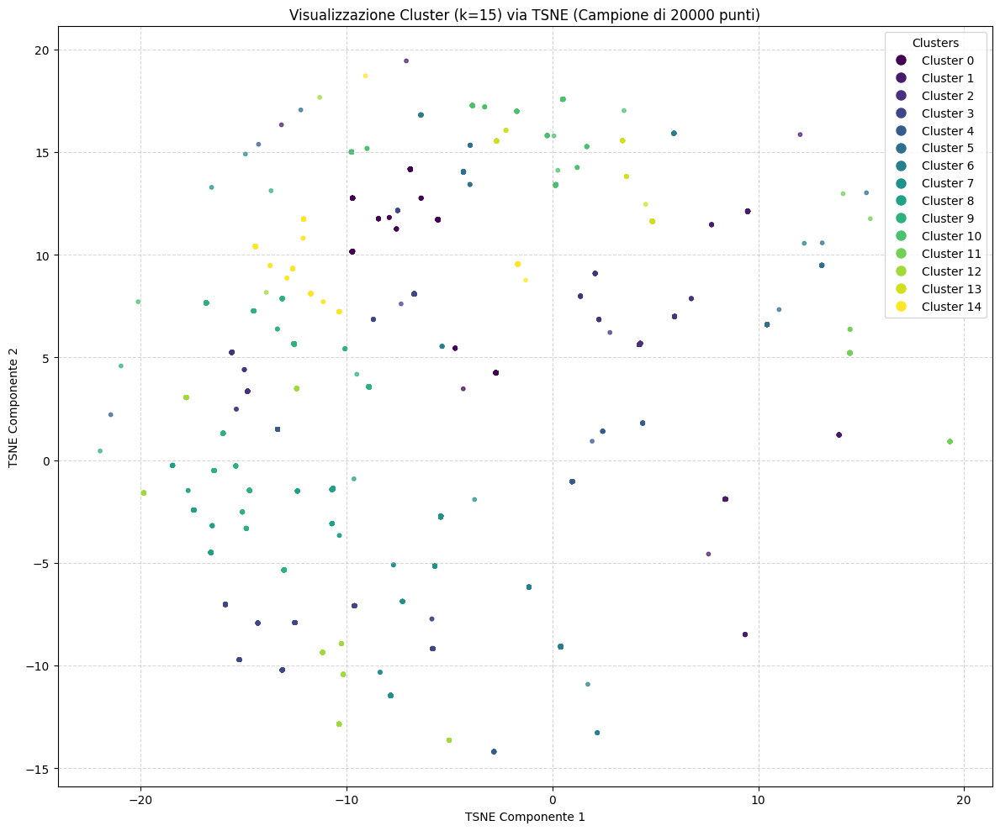


--- Visualizzazione Campioni Immagini per Cluster ---

Cluster 0 (18005 totali):
 Mostro 9 campioni casuali...


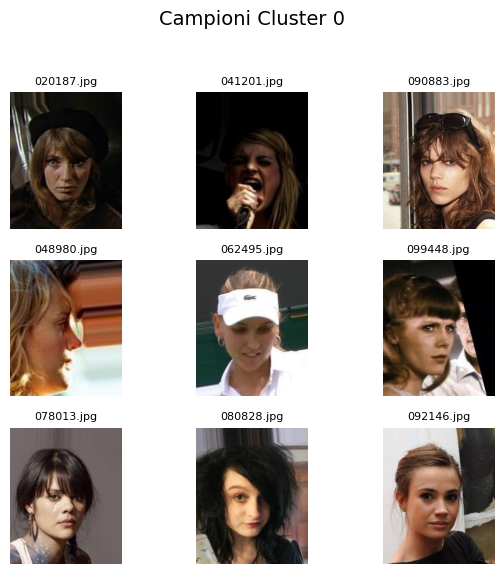


Cluster 1 (33458 totali):
 Mostro 9 campioni casuali...


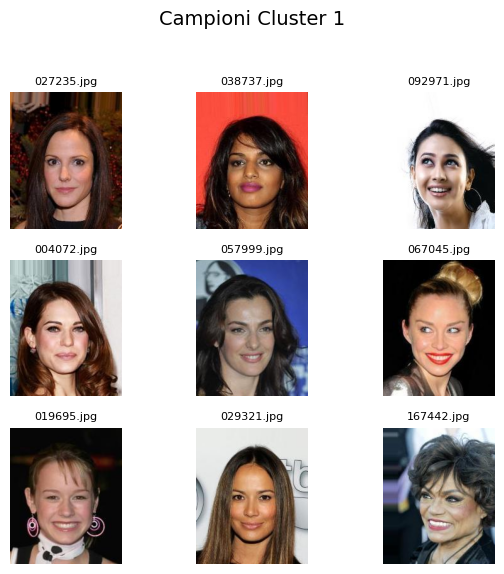


Cluster 2 (13440 totali):
 Mostro 9 campioni casuali...


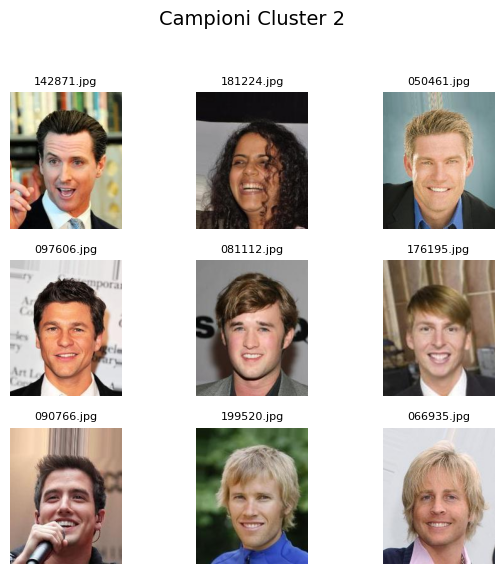


Cluster 3 (12221 totali):
 Mostro 9 campioni casuali...


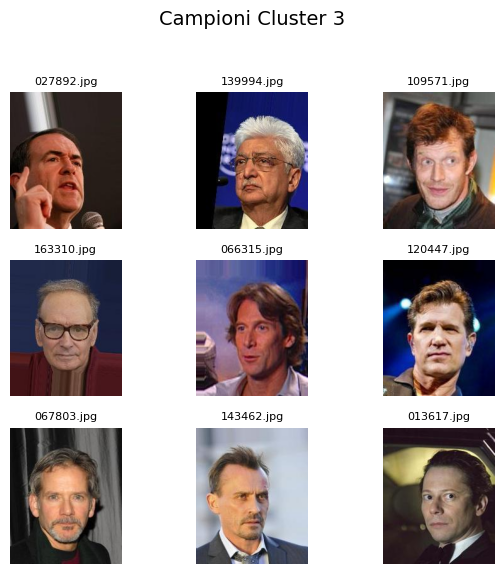


Cluster 4 (21020 totali):
 Mostro 9 campioni casuali...


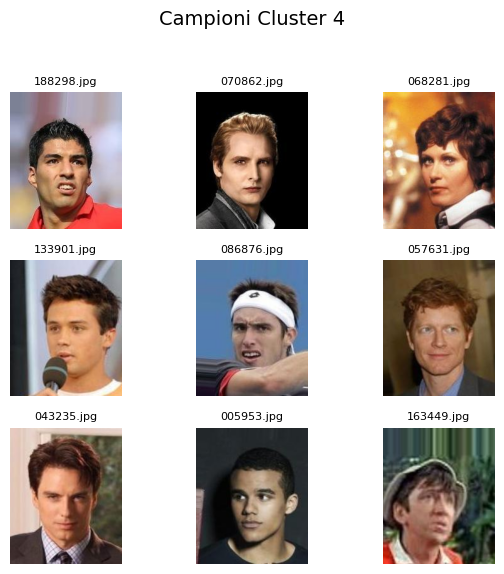


Cluster 5 (7173 totali):
 Mostro 9 campioni casuali...


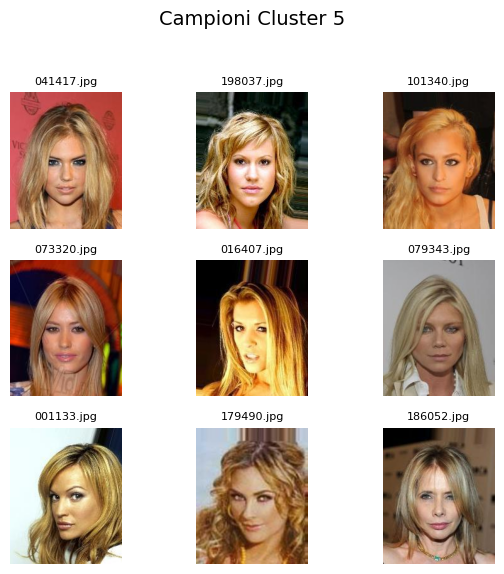


Cluster 6 (21808 totali):
 Mostro 9 campioni casuali...


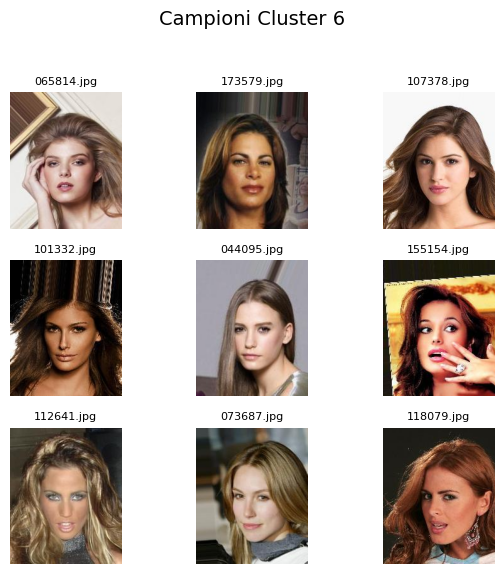


Cluster 7 (15191 totali):
 Mostro 9 campioni casuali...


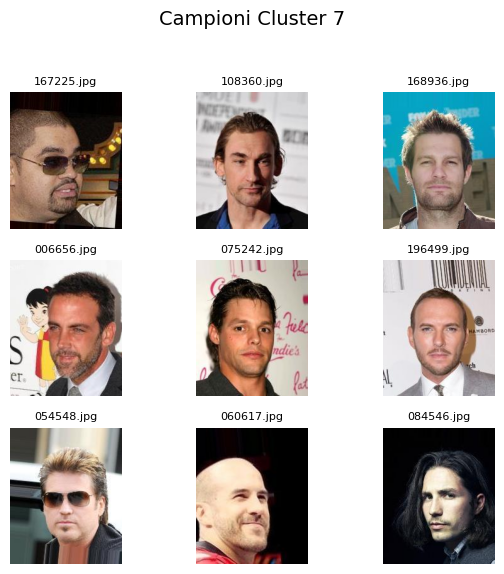


Cluster 8 (8468 totali):
 Mostro 9 campioni casuali...


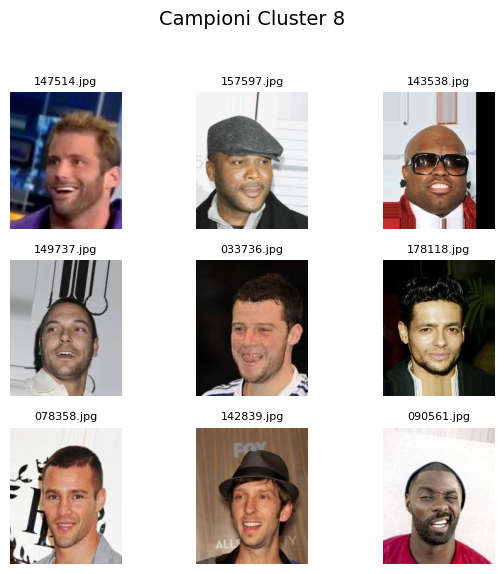


Cluster 9 (12758 totali):
 Mostro 9 campioni casuali...


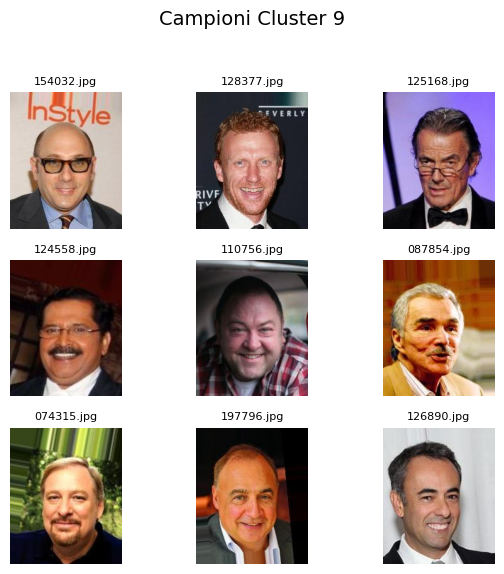


Cluster 10 (8147 totali):
 Mostro 9 campioni casuali...


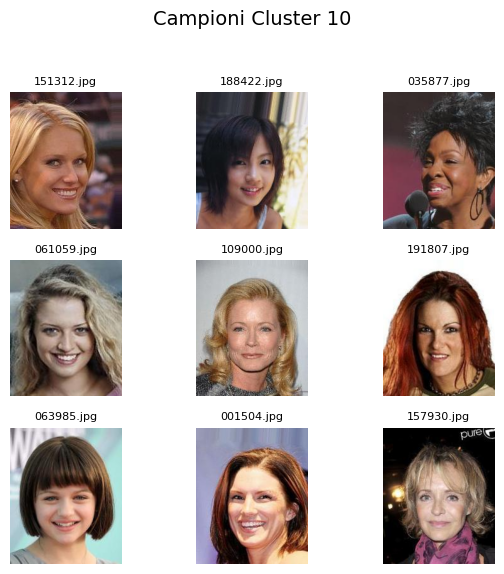


Cluster 11 (11697 totali):
 Mostro 9 campioni casuali...


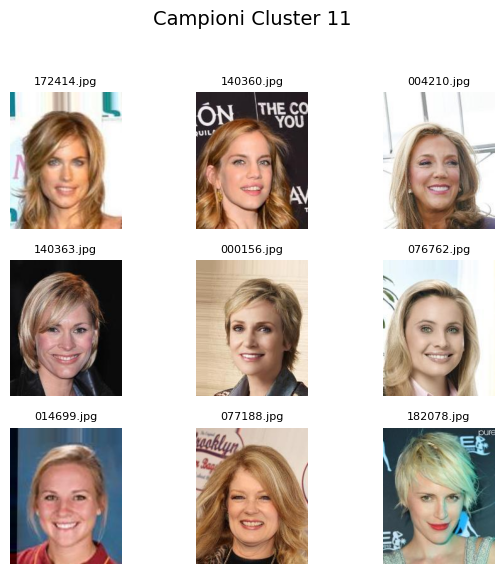


Cluster 12 (4393 totali):
 Mostro 9 campioni casuali...


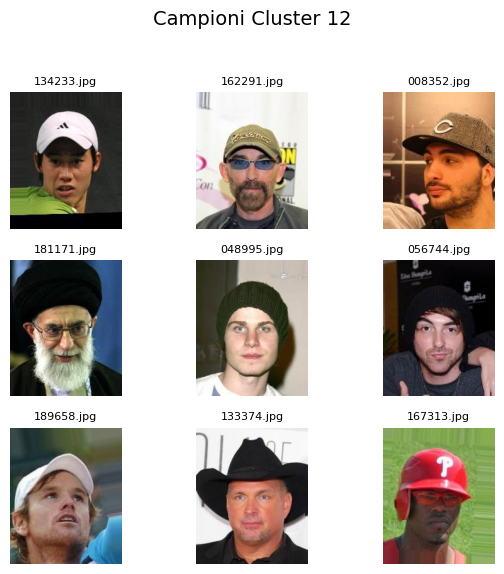


Cluster 13 (5889 totali):
 Mostro 9 campioni casuali...


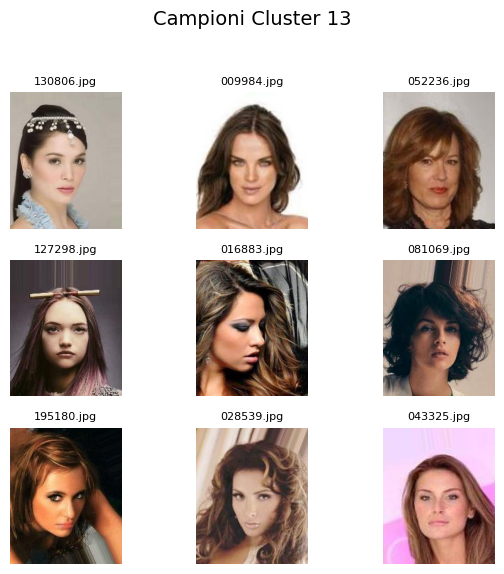


Cluster 14 (8931 totali):
 Mostro 9 campioni casuali...


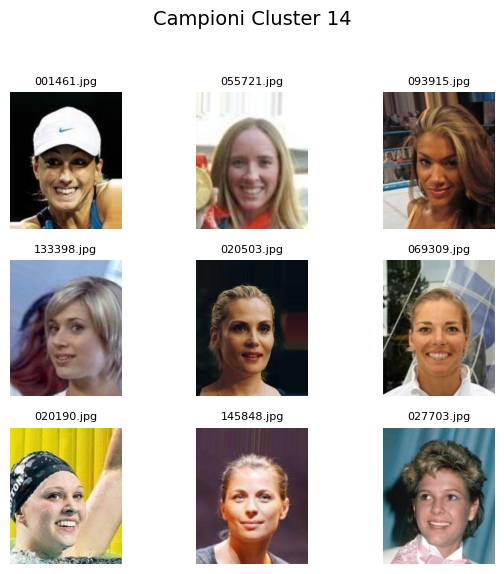


========== FINE CLUSTERING REPLICAZIONE ANZALONE PER: anzalone_selected_features (k=15) ==========


In [81]:
if 'anz_selected' in locals() and isinstance(anz_selected, pd.DataFrame) and not anz_selected.empty and \
   'pred_attr' in locals() and isinstance(pred_attr, pd.DataFrame) and 'image_id' in pred_attr.columns:

    # Estrai gli ID immagine originali CORRISPONDENTI alle righe di anz_selected
    # È cruciale che questi ID siano nell'ordine corretto.
    # Assumiamo che anz_selected sia un subset di righe/colonne di pred_attr
    # e quindi gli indici siano allineati o che pred_attr['image_id']
    # sia l'elenco completo da cui anz_selected deriva le sue righe.
    # Se anz_selected ha mantenuto gli indici originali di pred_attr, possiamo usare .loc
    # Altrimenti, se anz_selected è il risultato di pred_attr[anzalone_features],
    # gli ID immagine corrispondono direttamente.

    # Opzione più sicura se anz_selected è un subset di colonne MA TUTTE LE RIGHE di pred_attr:
    if len(anz_selected) == len(pred_attr):
        original_image_ids_for_anzalone_exp = pred_attr['image_id'].values.tolist()
        print(f"DataFrame 'anz_selected' pronto per il clustering. Shape: {anz_selected.shape}")
        print(f"Numero di ID immagine: {len(original_image_ids_for_anzalone_exp)}")

        # Definisci i parametri specifici per questo esperimento
        K_ANZALONE_REPLICATION = 15 # Come da paper/esperimento precedente
        ANZALONE_OUTPUT_SUBDIR = "kmeans_clustering_anzalone_replication" # Sottocartella specifica
        ANZALONE_DF_NAME = "anzalone_selected_features" # Nome descrittivo per i file di output

        # Esegui il clustering completo con visualizzazioni
        perform_anzalone_replication_clustering(
            input_df=anz_selected, # Il DataFrame con solo le 10 feature
            original_item_ids=original_image_ids_for_anzalone_exp, # La lista completa degli ID
            num_k_clusters=K_ANZALONE_REPLICATION,
            df_name_for_output=ANZALONE_DF_NAME,
            output_subdir_base=ANZALONE_OUTPUT_SUBDIR
            # Puoi sovrascrivere altri parametri globali se necessario, es:
            # silhouette_sample_size=10000
            # visualize_sample_size=10000
        )
    else:
        print("ATTENZIONE: La lunghezza di 'anz_selected' non corrisponde a 'pred_attr'. Impossibile allineare gli image_id.")
        print("Assicurati che 'anz_selected' contenga le stesse righe di 'pred_attr' per estrarre correttamente 'image_id'.")
        print("Clustering per Anzalone Replication saltato.")

else:
    missing_vars = []
    if 'anz_selected' not in locals() or not isinstance(anz_selected, pd.DataFrame) or anz_selected.empty:
        missing_vars.append("'anz_selected' (DataFrame con le feature selezionate)")
    if 'pred_attr' not in locals() or not isinstance(pred_attr, pd.DataFrame) or 'image_id' not in pred_attr.columns:
        missing_vars.append("'pred_attr' (DataFrame originale con 'image_id')")

    print(f"Clustering per Anzalone Replication saltato. Variabili necessarie non trovate o non valide: {', '.join(missing_vars)}.")
    print("Controlla le celle precedenti dove queste variabili vengono definite.")

Come possiamo notare, dagli esperimenti effettuati sopra, utilizzando il dataset ottenuto dai pesi del modello si ottiene un leggero incremento nel silhouette score pari a 0,72 in linea quindi con il valore di 0,8 presente nel paper di Anzalone et al.


# Classificazione per feature Attractive


Classificazione dell'Attributo "Attractive" e Valutazione dei Bias tra Cluster

In questa sezione, si investiga la presenza di potenziali bias nella predizione dell'attributo "Attractive" (ground truth) analizzando le performance e il comportamento di un modello di classificazione attraverso i cluster precedentemente identificati. I cluster sono stati formati utilizzando le 10 feature facciali predette dal modello di Anzalone et al., e le relative etichette di cluster sono state aggiunte al DataFrame class_df nella colonna kmeans_label.

L'obiettivo è duplice:

* Valutare se la capacità di un modello di classificare correttamente l'attributo "Attractive" varia significativamente tra i diversi cluster di volti, indicando potenziali disparità di trattamento (fairness).

* Comprendere come le 10 feature predette (che definiscono i cluster) influenzano la predizione di "Attractive" in modo differenziato all'interno di ciascun cluster.

Per raggiungere questi obiettivi, è stato addestrato un unico classificatore globale (ad esempio, Regressione Logistica o Random Forest) per predire l'etichetta "Attractive" (ground truth) utilizzando come input le 10 feature predette presenti in class_df. Successivamente, le performance di questo modello globale (in termini di accuratezza, F1-score, AUC-ROC, True Positive Rate, False Positive Rate) sono state valutate separatamente per ciascun sottogruppo di dati definito dalle etichette kmeans_label.

Per approfondire l'impatto delle singole feature, è stata impiegata la tecnica di interpretabilità SHAP (SHapley Additive exPlanations). Applicando SHAP al modello globale per le istanze appartenenti a ciascun cluster, è possibile quantificare il contributo di ognuna delle 10 feature predette alla decisione del modello per quel specifico sottogruppo.

Il confronto delle metriche di performance e dei pattern di importanza delle feature (SHAP values) tra i cluster permette di identificare eventuali disparità. Ad esempio, una performance significativamente inferiore o un diverso set di feature trainanti per la predizione di "Attractive" in un cluster rispetto ad altri può segnalare la presenza di bias, che potrebbero originare dal dataset CelebA, dal modello di predizione degli attributi di Anzalone et al., o dal classificatore di "Attractive" stesso. L'analisi qualitativa delle immagini campione dei cluster con comportamenti anomali supporterà l'interpretazione di questi risultati.

In [82]:
class_df= pd.read_csv('/content/drive/MyDrive/Data Analytics for Business/Progetto/kmeans_clustering_anzalone_replication_anzalone_selected_features_k15/anzalone_selected_features_k15_results.csv')
class_df.head()

,image_id,Wearing_Lipstick_pred,Smiling_pred,No_Beard_pred,Heavy_Makeup_pred,Bald_pred,Male_pred,Young_pred,Eyeglasses_pred,Blond_Hair_pred,Wearing_Hat_pred,kmeans_label
0,000001.jpg,1,1,1,1,0,0,1,0,0,0,1
1,000002.jpg,0,1,1,0,0,0,1,0,0,0,14
2,000003.jpg,0,0,1,0,0,1,1,0,0,0,4
3,000004.jpg,0,0,1,0,0,0,1,0,0,0,0
4,000005.jpg,1,0,1,1,0,0,1,0,0,0,6


In [83]:
class_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 202599 entries, 0 to 202598
Data columns (total 12 columns):
 #   Column                 Non-Null Count   Dtype 
---  ------                 --------------   ----- 
 0   image_id               202599 non-null  object
 1   Wearing_Lipstick_pred  202599 non-null  int64 
 2   Smiling_pred           202599 non-null  int64 
 3   No_Beard_pred          202599 non-null  int64 
 4   Heavy_Makeup_pred      202599 non-null  int64 
 5   Bald_pred              202599 non-null  int64 
 6   Male_pred              202599 non-null  int64 
 7   Young_pred             202599 non-null  int64 
 8   Eyeglasses_pred        202599 non-null  int64 
 9   Blond_Hair_pred        202599 non-null  int64 
 10  Wearing_Hat_pred       202599 non-null  int64 
 11  kmeans_label           202599 non-null  int64 
dtypes: int64(11), object(1)
memory usage: 18.5+ MB


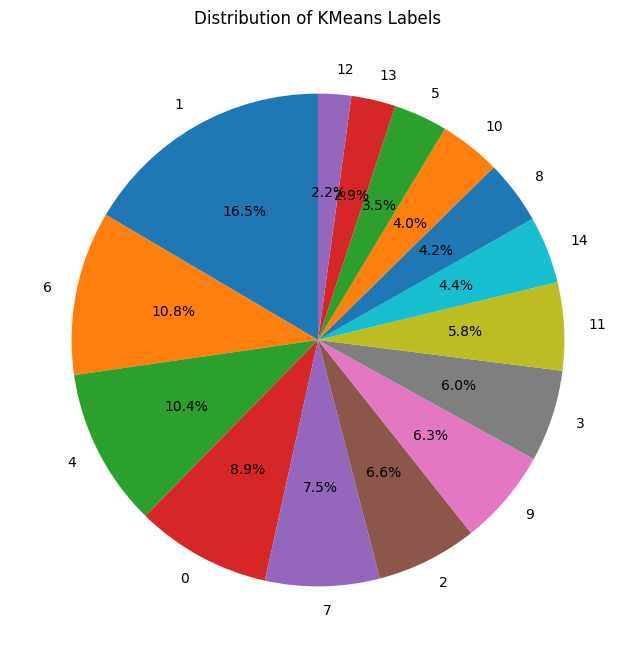

In [84]:
label_counts = class_df['kmeans_label'].value_counts()

plt.figure(figsize=(8, 8))
plt.pie(label_counts, labels=label_counts.index, autopct='%1.1f%%', startangle=90)
plt.title('Distribution of KMeans Labels')
plt.show()

In [85]:
label_counts = class_df['kmeans_label'].value_counts()
print("Conteggio istanze per etichetta KMeans:")
label_counts

Conteggio istanze per etichetta KMeans:


,count
kmeans_label,
1,33458
6,21808
4,21020
0,18005
7,15191
2,13440
9,12758
3,12221
11,11697


Faccio training su 80% di ogni cluster e poi faccio le predizioni

In [86]:
# ------ Definisco mappa tra image_id e feature Attractive ------

if 'attr_original_df' in locals() and isinstance(attr_original_df, pd.DataFrame) and \
   'image_id' in attr_original_df.columns and 'Attractive' in attr_original_df.columns:

    # Crea il dizionario (mappa)
    attractive_ground_truth_map = pd.Series(
        attr_original_df.Attractive.values,
        index=attr_original_df.image_id
    ).to_dict()

    print(f"Mappa 'attractive_ground_truth_map' creata con successo con {len(attractive_ground_truth_map)} voci.")

else:
    print("ERRORE: 'attr_original_df' non è definito correttamente o mancano le colonne 'image_id' o 'Attractive'.")
    print("Assicurati di aver caricato il file CSV originale di CelebA in questo DataFrame e che le colonne abbiano i nomi corretti.")
    attractive_ground_truth_map = {}

Mappa 'attractive_ground_truth_map' creata con successo con 202599 voci.


## Analisi esplorativa su feature attractive

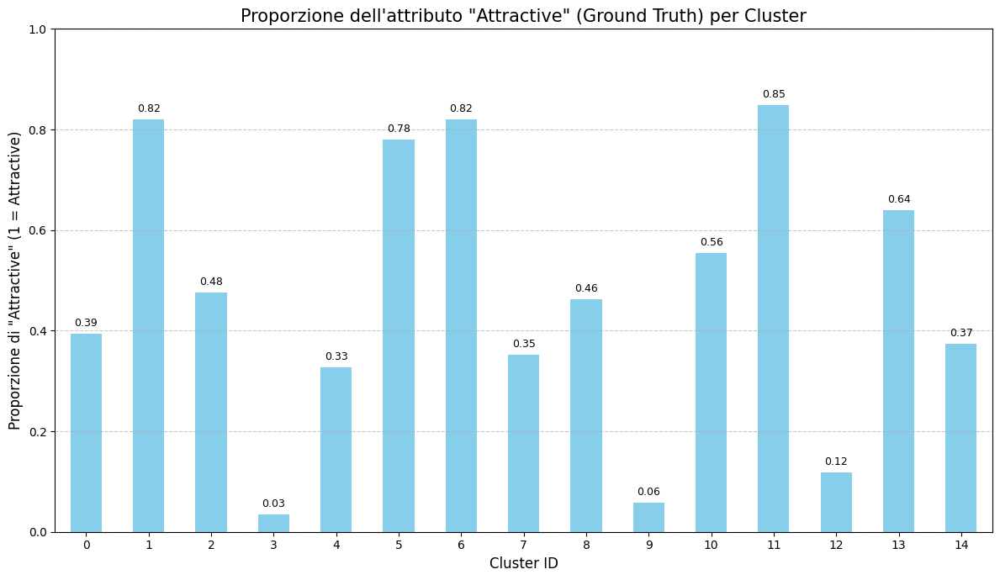

In [87]:
# --- 1. Mappare il Ground Truth "Attractive" a class_df ---

df_for_plot = class_df.copy()
df_for_plot['Attractive_GT'] = df_for_plot['image_id'].map(attractive_ground_truth_map)

# Rimuovi righe dove il mapping potrebbe aver fallito (se qualche image_id non era nella mappa)
df_for_plot.dropna(subset=['Attractive_GT'], inplace=True)
df_for_plot['Attractive_GT'] = df_for_plot['Attractive_GT'].astype(int)


# --- 2. Calcolare la Proporzione di "Attractive" per Cluster ---

attractive_proportion_per_cluster = df_for_plot.groupby('kmeans_label')['Attractive_GT'].mean().sort_index()



# --- 3. Creare il Grafico a Barre delle Proporzioni ---
if not attractive_proportion_per_cluster.empty:
    plt.figure(figsize=(12, 7))
    attractive_proportion_per_cluster.plot(kind='bar', color='skyblue')

    plt.title('Proporzione dell\'attributo "Attractive" (Ground Truth) per Cluster', fontsize=15)
    plt.xlabel('Cluster ID', fontsize=12)
    plt.ylabel('Proporzione di "Attractive" (1 = Attractive)', fontsize=12)
    plt.xticks(rotation=0) # Mantieni le etichette dei cluster orizzontali
    plt.grid(axis='y', linestyle='--', alpha=0.7)
    plt.ylim(0, 1) # La proporzione va da 0 a 1

    # Aggiungi etichette numeriche sopra le barre
    for index, value in enumerate(attractive_proportion_per_cluster):
        plt.text(index, value + 0.01, f"{value:.2f}", ha='center', va='bottom', fontsize=9)

    plt.tight_layout()
    plt.show()
else:
    print("Nessun dato sulla proporzione di 'Attractive' da plottare. Controlla i dati di input.")

Come visibile dal grafico i Clusters 3, 9 e 12 sono quelli più sbilanciati rispetto alla feature Attractive. Ciò porterà sicuramente a delle metriche di performance dei modelli più difficili da interpretare

## Bilanciamento classi nei clusters
Quindi per aumentare l'interpretabilità delle metriche di valutazione ed un addestramento più efficace effettuiamo un ribilanciamento della classe target attractive tramite undersampling della classe maggioritaria.

In particolare andiamo ad effettuare vari esperimenti di bilanciamento:

* Bilanciamo sia il training set che il test set ed usiamo per la predizione le stesse feature di Anzalone.

* Bilanciamo sia il training set che il test set ed usiamo per la predizione un nuovo set di feature

* Bilanciamo solamente i fold di training, lasciando il test set sbilanciato in modo tale da avere delle metriche più robuste




In [88]:
from tqdm.notebook import tqdm
from sklearn.utils import resample # Per l'undersampling

def prepare_global_train_and_cluster_test_sets_with_undersampling(
    df_input, # DataFrame originale (es. class_df)
    feature_cols,
    id_col, # Nome della colonna ID (es. 'image_id')
    target_col_name, # Nome che darai alla colonna target (es. 'Attractive_GT')
    cluster_label_col,
    n_clusters,
    test_size_cluster,
    random_state,
    perform_undersampling=True # Flag per attivare/disattivare l'undersampling
):
    """
    Prepara un dataset di training globale e set di test specifici per ogni cluster.
    Include l'opzione di effettuare UNDERSAMPLING sulla classe maggioritaria del target
    ALL'INTERNO di ciascun cluster prima dello split train/test del cluster.
    """
    X_train_global_list = []
    y_train_global_list = []
    test_sets_per_cluster = {}

    df = df_input.copy() # Lavora su una copia

    # Mappa l'image_id al ground truth di attractive
    df[target_col_name] = df[id_col].map(attractive_ground_truth_map)
    df_cleaned = df.dropna(subset=[target_col_name])
    if df_cleaned.empty:
        print(f"ERRORE: Nessun dato valido dopo il mapping del target (colonna '{target_col_name}').")
        return None, None, None
    df_cleaned[target_col_name] = df_cleaned[target_col_name].astype(int)

    print(f"Valori unici per target '{target_col_name}' prima del bilanciamento: {df_cleaned[target_col_name].value_counts(normalize=True)}")

    for i in tqdm(range(n_clusters), desc="Preparazione Dati per Cluster (Undersampling)", leave=False):
        cluster_data_original = df_cleaned[df_cleaned[cluster_label_col] == i]

        if len(cluster_data_original) < 10: # Soglia minima per considerare un cluster
            print(f"Cluster {i}: troppo piccolo ({len(cluster_data_original)} campioni), skipping.")
            continue

        # --- INIZIO BLOCCO UNDERSAMPLING PER CLUSTER ---
        if perform_undersampling:
            counts = cluster_data_original[target_col_name].value_counts()
            if len(counts) < 2: # Solo una classe presente nel cluster
                print(f"Cluster {i}: solo una classe target presente ({counts.index[0] if len(counts)>0 else 'N/A'}), skipping undersampling per questo cluster.")
                cluster_data_balanced = cluster_data_original.copy()
            else:
                minority_class_count = counts.min()
                majority_class_label = counts.idxmax()
                minority_class_label = counts.idxmin()

                if counts[majority_class_label] == minority_class_count: # Già bilanciato o quasi
                    # print(f"Cluster {i}: già bilanciato o classe maggioritaria uguale a minoritaria, skipping undersampling.")
                    cluster_data_balanced = cluster_data_original.copy()
                else:
                    df_majority = cluster_data_original[cluster_data_original[target_col_name] == majority_class_label]
                    df_minority = cluster_data_original[cluster_data_original[target_col_name] == minority_class_label]

                    df_majority_undersampled = resample(df_majority,
                                                        replace=False, # Non campionare con rimpiazzo
                                                        n_samples=minority_class_count, # Abbina alla classe minoritaria
                                                        random_state=random_state)

                    cluster_data_balanced = pd.concat([df_majority_undersampled, df_minority])
                    # print(f"Cluster {i}: Undersampling effettuato. Da {len(df_majority)} a {len(df_majority_undersampled)} per classe {majority_class_label}. "
                    #       f"Minoritaria ({minority_class_label}): {len(df_minority)}. Totale bilanciato: {len(cluster_data_balanced)}")
        else: # Se perform_undersampling è False
            cluster_data_balanced = cluster_data_original.copy()
        # --- FINE BLOCCO UNDERSAMPLING PER CLUSTER ---

        if len(cluster_data_balanced) < 5: # Soglia minima dopo bilanciamento per split
            print(f"Cluster {i}: dopo bilanciamento, rimasti meno di 5 campioni ({len(cluster_data_balanced)}), skipping.")
            continue

        X_c_balanced = cluster_data_balanced[feature_cols]
        y_c_balanced = cluster_data_balanced[target_col_name]

        if len(y_c_balanced.unique()) < 2:
            # print(f"Cluster {i} (bilanciato): solo una classe ({y_c_balanced.unique()}). Split non stratificato.")
            try:
                X_train_c, X_test_c, y_train_c, y_test_c = train_test_split(
                    X_c_balanced, y_c_balanced, test_size=test_size_cluster, random_state=random_state, shuffle=True
                )
            except ValueError:
                 X_train_c, y_train_c = X_c_balanced.copy(), y_c_balanced.copy()
                 X_test_c, y_test_c = pd.DataFrame(columns=feature_cols), pd.Series(dtype='int')
        else:
            try:
                X_train_c, X_test_c, y_train_c, y_test_c = train_test_split(
                    X_c_balanced, y_c_balanced, test_size=test_size_cluster, random_state=random_state, stratify=y_c_balanced, shuffle=True
                )
            except ValueError:
                 X_train_c, y_train_c = X_c_balanced.copy(), y_c_balanced.copy()
                 X_test_c, y_test_c = pd.DataFrame(columns=feature_cols), pd.Series(dtype='int')

        X_train_global_list.append(X_train_c)
        y_train_global_list.append(y_train_c)

        if not X_test_c.empty:
            test_sets_per_cluster[i] = {'X_test': X_test_c, 'y_test': y_test_c, 'original_size_before_balance': len(cluster_data_original), 'balanced_size': len(cluster_data_balanced)}
        else:
            # print(f"Cluster {i} (bilanciato) non avrà un test set dedicato.")
            pass


    if not X_train_global_list:
        print("ERRORE: Nessun dato di training globale generato dopo undersampling e split. Controlla i cluster e le soglie.")
        return None, None, None

    X_train_global = pd.concat(X_train_global_list).sample(frac=1, random_state=random_state).reset_index(drop=True) # Shuffle globale
    y_train_global = pd.concat(y_train_global_list).sample(frac=1, random_state=random_state).reset_index(drop=True) # Shuffle globale

    print(f"Dimensioni Training Globale (dopo undersampling per cluster e shuffle): X={X_train_global.shape}, y={y_train_global.shape}")
    print(f"Distribuzione target nel Training Globale: \n{y_train_global.value_counts(normalize=True)}")
    print(f"Numero di Test Set per Cluster: {len(test_sets_per_cluster)}")

    # Stampa un riepilogo delle dimensioni dei test set per cluster
    print("\nRiepilogo dimensioni Test Set per Cluster (dopo undersampling sul training del cluster):")
    for cid, data in test_sets_per_cluster.items():
        print(f"  Cluster {cid}: Test Size = {len(data['X_test'])}, Original Cluster Size (prima di bilanciare per split) = {data['original_size_before_balance']}, Balanced Data Size (prima di split) = {data['balanced_size']}")


    return X_train_global, y_train_global, test_sets_per_cluster

## Utils for Machine Learning Models

In [89]:
!pip install scikeras

In [90]:
import shap
import joblib # Per salvare/caricare modelli
import tensorflow.keras


from sklearn.model_selection import train_test_split, GridSearchCV
from sklearn.ensemble import RandomForestClassifier
from sklearn.linear_model import LogisticRegression
from sklearn.svm import SVC
from sklearn.preprocessing import StandardScaler
from sklearn.pipeline import Pipeline
from sklearn.metrics import accuracy_score, classification_report, roc_auc_score, confusion_matrix

from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense, Dropout
from tensorflow.keras.optimizers import Adam, RMSprop
from scikeras.wrappers import KerasClassifier # Per usare Keras con GridSearchCV


# --- IMPOSTAZIONI GLOBALI (DA ADATTARE SE NECESSARIO) ---
RANDOM_STATE = 42
CV_FOLDS = 3
N_JOBS_GRIDSEARCH = -1
TEST_SIZE_PER_CLUSTER = 0.20
MODELS_DIR = "trained_models"
RESULTS_DIR = "evaluation_results"
SHAP_PLOTS_DIR = "shap_plots"


def train_tune_or_load_classifier(X_train, y_train, model_name,
                                  base_model_instance, # <<<< NOME CAMBIATO
                                  param_grid,
                                  cv_folds, random_state, project_path, model_filename_prefix,
                                  n_jobs=-1, force_retrain=False):
    model_dir_path = os.path.join(project_path, MODELS_DIR)
    os.makedirs(model_dir_path, exist_ok=True)
    model_path = os.path.join(model_dir_path, f"{model_filename_prefix}_{model_name}.joblib")

    if os.path.exists(model_path) and not force_retrain:
        print(f"Caricamento modello pre-addestrato: {model_name} da {model_path}")
        try:
            best_model = joblib.load(model_path)
            print(f"Modello {model_name} caricato con successo.")
            return best_model
        except Exception as e:
            print(f"Errore durante il caricamento del modello {model_name}: {e}. Rieseguo il training.")

    print(f"\n--- Training e Tuning per: {model_name} (Modello non trovato o force_retrain=True) ---")

    # Ora current_model è direttamente l'istanza passata
    current_model = base_model_instance # <<<< MODIFICA QUI: non c'è più model_constructor()

    grid_search = GridSearchCV(estimator=current_model, param_grid=param_grid, cv=cv_folds,
                               scoring='roc_auc', verbose=1, n_jobs=n_jobs, error_score='raise')

    try:
        grid_search.fit(X_train, y_train)
    except Exception as e:
        print(f"Errore FATALE durante GridSearchCV per {model_name}: {e}")
        print("Controlla la configurazione del modello e i dati.")
        return None

    if np.isnan(grid_search.best_score_):
        print(f"ATTENZIONE: Miglior AUC (CV) per {model_name} è nan. Ciò potrebbe indicare problemi nel training/valutazione.")
        print(f"GridSearchCV.cv_results_['mean_test_score'] è: {grid_search.cv_results_['mean_test_score']}")
        print(f"Verrà usato il modello corrispondente a best_params_: {grid_search.best_params_}, ma le performance CV non sono affidabili.")
        best_model = grid_search.best_estimator_
    else:
        best_model = grid_search.best_estimator_
        print(f"Migliori iperparametri per {model_name}: {grid_search.best_params_}")
        print(f"Miglior AUC (CV) per {model_name}: {grid_search.best_score_:.4f}")

    try:
        joblib.dump(best_model, model_path)
        print(f"Modello {model_name} salvato in: {model_path}")
    except Exception as e:
        print(f"Errore durante il salvataggio del modello {model_name}: {e}")

    return best_model


def evaluate_model_on_clusters(model, model_name, test_sets_per_cluster, project_path, results_filename_prefix, force_recalculate=False):

    results_dir_path = os.path.join(project_path, RESULTS_DIR)
    os.makedirs(results_dir_path, exist_ok=True)
    results_path = os.path.join(results_dir_path, f"{results_filename_prefix}_{model_name}_cluster_performance.csv")

    if os.path.exists(results_path) and not force_recalculate:

        print(f"Caricamento risultati performance pre-calcolati per {model_name} da {results_path}")
        try:
            df_performance = pd.read_csv(results_path, index_col=0)
            print(f"Risultati performance per {model_name} caricati.")
            print(f"\n--- Performance di {model_name} sui Test Set dei Cluster (caricate) ---")
            print(df_performance)
            return df_performance
        except Exception as e:
            print(f"Errore caricamento risultati performance per {model_name}: {e}. Ricalcolo.")


    print(f"\n--- Calcolo Performance di {model_name} sui Test Set dei Cluster ---")
    cluster_performance = {}
    valid_clusters_for_eval = 0


    for cluster_id, data in tqdm(test_sets_per_cluster.items(), desc=f"Valutazione {model_name} su Cluster", leave=False):

        X_test_c = data['X_test']
        y_test_c = data['y_test']

        if X_test_c.empty or len(X_test_c) < 2 :

            cluster_performance[cluster_id] = {
                'model': model_name, 'size': len(X_test_c), 'accuracy': np.nan,
                'f1_attractive_1': np.nan, 'f1_attractive_0': np.nan,
                'tpr_attractive_1': np.nan, 'fpr_attractive_1': np.nan, 'auc': np.nan
            }
            continue

        if len(y_test_c.unique()) < 2:

            y_pred_c = model.predict(X_test_c)
            acc = accuracy_score(y_test_c, y_pred_c)

            cluster_performance[cluster_id] = {
                'model': model_name, 'size': len(X_test_c), 'accuracy': acc,
                'f1_attractive_1': np.nan, 'f1_attractive_0': np.nan,
                'tpr_attractive_1': np.nan, 'fpr_attractive_1': np.nan, 'auc': np.nan
            }
            valid_clusters_for_eval +=1
            continue



        y_pred_c = model.predict(X_test_c)
        y_proba_c = model.predict_proba(X_test_c)[:, 1]
        report_dict = classification_report(y_test_c, y_pred_c, output_dict=True, zero_division=0)
        auc_c = roc_auc_score(y_test_c, y_proba_c)
        cm = confusion_matrix(y_test_c, y_pred_c)
        tn, fp, fn, tp = cm.ravel() if cm.size == 4 else (sum(y_test_c==0),0,0,sum(y_test_c==1)) if sum(y_test_c==0)>0 and sum(y_test_c==1)>0 else (0,0,0,0)
        tpr_attractive = tp / (tp + fn) if (tp + fn) > 0 else 0
        fpr_attractive = fp / (fp + tn) if (fp + tn) > 0 else 0

        cluster_performance[cluster_id] = {
            'model': model_name, 'size': len(X_test_c), 'accuracy': report_dict['accuracy'],
            'f1_attractive_1': report_dict.get('1', {}).get('f1-score', np.nan),
            'f1_attractive_0': report_dict.get('0', {}).get('f1-score', np.nan),
            'tpr_attractive_1': tpr_attractive, 'fpr_attractive_1': fpr_attractive, 'auc': auc_c
        }
        valid_clusters_for_eval +=1


    if valid_clusters_for_eval == 0 :
        print(f"Nessun cluster aveva dati sufficienti per una valutazione completa per {model_name}.")
        return pd.DataFrame()
    df_performance = pd.DataFrame.from_dict(cluster_performance, orient='index')
    print(f"\n--- Performance Calcolate di {model_name} sui Test Set dei Cluster ---")
    print(df_performance.head())
    try:
        df_performance.to_csv(results_path)
        print(f"Risultati performance per {model_name} salvati in: {results_path}")
    except Exception as e:
        print(f"Errore durante il salvataggio dei risultati performance per {model_name}: {e}")
    return df_performance


def create_keras_model(optimizer='adam', dropout_rate=0.2, neurons=64, num_features=10):
    model = Sequential()
    model.add(Dense(neurons, input_shape=(num_features,), activation='relu'))
    model.add(Dropout(dropout_rate))
    model.add(Dense(neurons//2, activation='relu'))
    model.add(Dropout(dropout_rate/2))
    model.add(Dense(1, activation='sigmoid'))


    if optimizer == 'adam':
        opt = Adam()
    elif optimizer == 'rmsprop':
        opt = RMSprop()
    else:
        opt = Adam()

    model.compile(optimizer=opt, loss='binary_crossentropy', metrics=['accuracy'])
    return model

def get_shap_explanations_for_clusters(model, model_name, X_train_global_for_explainer, test_sets_per_cluster,
                                       feature_cols, project_path, results_filename_prefix, force_recalculate=False):
    results_dir_path = os.path.join(project_path, RESULTS_DIR)
    shap_plots_path_base = os.path.join(project_path, SHAP_PLOTS_DIR, model_name)
    os.makedirs(results_dir_path, exist_ok=True)
    os.makedirs(shap_plots_path_base, exist_ok=True)
    shap_comparison_path = os.path.join(results_dir_path, f"{results_filename_prefix}_{model_name}_shap_comparison.csv")

    if os.path.exists(shap_comparison_path) and not force_recalculate:
        print(f"Caricamento dati SHAP pre-calcolati per {model_name} da {shap_comparison_path}")
        try:
            df_shap_comparison = pd.read_csv(shap_comparison_path, index_col=0)
            print(f"Dati SHAP per {model_name} caricati.")
            if not df_shap_comparison.empty:
                print("\n\n--- Confronto Importanza Media Assoluta SHAP (Modello Globale) tra Cluster (caricato) ---")
                plt.figure(figsize=(max(10, len(feature_cols)), max(4, len(df_shap_comparison.index) * 0.6)))
                sns.heatmap(df_shap_comparison, annot=True, cmap="viridis", fmt=".3f")
                plt.title(f"Importanza Media SHAP ({model_name} Globale) per Cluster (Predizione 'Attractive')")
                plt.ylabel("Cluster ID")
                plt.show()
            return df_shap_comparison
        except Exception as e:
            print(f"Errore caricamento dati SHAP per {model_name}: {e}. Ricalcolo.")

    print(f"\n--- Calcolo Analisi SHAP per {model_name} (Modello Globale) sui dati dei Cluster ---")


    if len(X_train_global_for_explainer) > 500:
        background_data_shap = shap.sample(X_train_global_for_explainer, 100)
    else:
        background_data_shap = X_train_global_for_explainer.copy()


    explainer = None
    final_estimator_for_shap = model
    scaler_for_shap = None

    if hasattr(model, 'steps'): # È una Pipeline
        final_estimator_for_shap = model.steps[-1][1]
        if 'scaler' in model.named_steps:
            scaler_for_shap = model.named_steps['scaler']

            background_data_shap = scaler_for_shap.transform(background_data_shap)

    try:
        if isinstance(final_estimator_for_shap, RandomForestClassifier):
            explainer = shap.TreeExplainer(final_estimator_for_shap, data=background_data_shap)
        elif isinstance(final_estimator_for_shap, LogisticRegression) or \
             (isinstance(final_estimator_for_shap, SVC) and final_estimator_for_shap.kernel == 'linear'):
            explainer = shap.LinearExplainer(final_estimator_for_shap, background_data_shap)
        elif isinstance(final_estimator_for_shap, SVC) and final_estimator_for_shap.kernel == 'rbf': # SVM RBF
             print(f"Avviso: Uso di KernelExplainer per {model_name} (SVM RBF), potrebbe essere lento.")

             if scaler_for_shap: # Se c'è uno scaler nella pipeline
                 explainer = shap.KernelExplainer(model.predict_proba, background_data_shap) # Passa l'intera pipeline
             else: # Modello senza scaler
                 explainer = shap.KernelExplainer(final_estimator_for_shap.predict_proba, background_data_shap)

        else: # Fallback generico a KernelExplainer se il tipo non è gestito esplicitamente
            print(f"Avviso: Tipo di modello o final_estimator non gestito esplicitamente ({type(final_estimator_for_shap)}). Uso di KernelExplainer per {model_name}, potrebbe essere lento.")
            if scaler_for_shap:
                 explainer = shap.KernelExplainer(model.predict_proba, background_data_shap)
            else:
                 explainer = shap.KernelExplainer(final_estimator_for_shap.predict_proba, background_data_shap)

    except Exception as e:
        print(f"Errore inizializzazione SHAP Explainer per {model_name}: {e}")
        return pd.DataFrame()

    all_cluster_shap_means = {}

    for cluster_id, data in tqdm(test_sets_per_cluster.items(), desc=f"Analisi SHAP {model_name} su Cluster", leave=False):
        X_test_c_orig = data['X_test'] # Dati originali del cluster
        if X_test_c_orig.empty or len(X_test_c_orig) < 2:
            continue

        # Trasforma i dati del cluster se c'era uno scaler nella pipeline e l'explainer lo richiede
        X_test_c_for_shap = scaler_for_shap.transform(X_test_c_orig) if scaler_for_shap and not isinstance(explainer, shap.KernelExplainer) else X_test_c_orig

        try:
            # L'argomento 'nsamples' è solo per KernelExplainer quando si calcolano gli shap_values.
            # TreeExplainer e LinearExplainer non lo usano.
            if isinstance(explainer, shap.KernelExplainer):
                shap_values_c_raw = explainer.shap_values(X_test_c_for_shap, nsamples='auto')
            else:
                shap_values_c_raw = explainer.shap_values(X_test_c_for_shap) # No nsamples per Tree/Linear


            shap_values_to_plot = None
            if isinstance(shap_values_c_raw, list) and len(shap_values_c_raw) == 2:
                shap_values_to_plot = shap_values_c_raw[1]
            elif isinstance(shap_values_c_raw, np.ndarray) and shap_values_c_raw.ndim == X_test_c_for_shap.ndim :
                shap_values_to_plot = shap_values_c_raw
            else:
                print(f"    Formato SHAP values non gestito per cluster {cluster_id}.")
                continue

            data_for_summary_plot = X_test_c_orig if isinstance(X_test_c_for_shap, np.ndarray) and isinstance(X_test_c_orig, pd.DataFrame) else X_test_c_for_shap

            plt.figure()
            shap.summary_plot(shap_values_to_plot, data_for_summary_plot, feature_names=feature_cols, show=False, max_display=len(feature_cols))
            plt.title(f"SHAP Summary (Global {model_name}) - On Cluster {cluster_id} Data")
            plot_path = os.path.join(shap_plots_path_base, f"shap_summary_cluster_{cluster_id}.png")
            plt.savefig(plot_path, bbox_inches='tight'); plt.close()

            all_cluster_shap_means[cluster_id] = pd.Series(np.abs(shap_values_to_plot).mean(axis=0), index=feature_cols)

        except Exception as e_shap_c:
            print(f"    Errore durante calcolo/plotting SHAP per cluster {cluster_id} ({model_name}): {e_shap_c}")

    df_shap_comparison = pd.DataFrame()
    if all_cluster_shap_means:
        df_shap_comparison = pd.DataFrame(all_cluster_shap_means).T
        # ... (stampa, plot heatmap, salvataggio CSV) ...
        print("\n\n--- Confronto Importanza Media Assoluta SHAP (Modello Globale) tra Cluster ---")
        print(df_shap_comparison.head())

        plt.figure(figsize=(max(10, len(feature_cols)), max(4, len(df_shap_comparison.index) * 0.6)))
        sns.heatmap(df_shap_comparison, annot=True, cmap="viridis", fmt=".3f")
        plt.title(f"Importanza Media SHAP ({model_name} Globale) per Cluster (Predizione 'Attractive')")
        plt.ylabel("Cluster ID")
        heatmap_path = os.path.join(shap_plots_path_base, "shap_heatmap_comparison.png")
        plt.savefig(heatmap_path, bbox_inches='tight'); plt.close()

        try:
            df_shap_comparison.to_csv(shap_comparison_path)
            print(f"Dati SHAP comparison per {model_name} salvati in: {shap_comparison_path}")
        except Exception as e:
            print(f"Errore durante il salvataggio dei dati SHAP comparison per {model_name}: {e}")
    return df_shap_comparison


In [91]:
!pip show scikeras tensorflow

Name: scikeras
Version: 0.13.0
Summary: Scikit-Learn API wrapper for Keras.
Home-page: https://github.com/adriangb/scikeras
Author: Adrian Garcia Badaracco
Author-email: 1755071+adriangb@users.noreply.github.com
License: MIT
Location: /usr/local/lib/python3.11/dist-packages
Requires: keras, scikit-learn
Required-by: 
---
Name: tensorflow
Version: 2.18.0
Summary: TensorFlow is an open source machine learning framework for everyone.
Home-page: https://www.tensorflow.org/
Author: Google Inc.
Author-email: packages@tensorflow.org
License: Apache 2.0
Location: /usr/local/lib/python3.11/dist-packages
Requires: absl-py, astunparse, flatbuffers, gast, google-pasta, grpcio, h5py, keras, libclang, ml-dtypes, numpy, opt-einsum, packaging, protobuf, requests, setuptools, six, tensorboard, tensorflow-io-gcs-filesystem, termcolor, typing-extensions, wrapt
Required-by: dopamine_rl, tensorflow-text, tensorflow_decision_forests, tf_keras


## Esperimento con anzalone_features e train e test set bilanciati rispetto ad Attractive

In [92]:

feature_columns_anzalone = anzalone_features

print("Verifica dati di input...")

if 'class_df' not in locals() or not isinstance(class_df, pd.DataFrame) or \
   'kmeans_label' not in class_df.columns or \
   'attractive_ground_truth_map' not in locals() or not isinstance(attractive_ground_truth_map, dict) or \
   'feature_columns_anzalone' not in locals() or not isinstance(feature_columns_anzalone, list) or \
   'PROJECT_PATH' not in locals() or not PROJECT_PATH:
    print("ERRORE CRITICO: Variabili di input fondamentali mancanti o non valide (incluso PROJECT_PATH). Interruzione.")

else:
    print("Dati di input e PROJECT_PATH sembrano pronti.")
    num_clusters = class_df['kmeans_label'].nunique()

    # Parametro per forzare il retraining/ricalcolo
    FORCE_RECALCULATE_ALL = False # Metti a True se vuoi rieseguire tutto, False per caricare se possibile

     # 2. Prepara i set di training globale e test per cluster CON UNDERSAMPLING
    print("\n--- Preparazione Set di Training/Test con Undersampling per Cluster ---")
    X_train_g, y_train_g, cluster_test_sets = prepare_global_train_and_cluster_test_sets_with_undersampling(
        df_input=class_df, # Il tuo DataFrame con kmeans_label, image_id, e le 10 feature
        feature_cols=feature_columns_anzalone,
        id_col='image_id', # Nome della colonna ID in class_df
        target_col_name='Attractive_GT', # Nome che verrà dato alla colonna target dopo il mapping
        cluster_label_col='kmeans_label',
        n_clusters=num_clusters,
        test_size_cluster=TEST_SIZE_PER_CLUSTER,
        random_state=RANDOM_STATE,
        perform_undersampling=True # Imposta a False per disabilitare l'undersampling
    )

    if X_train_g is not None and not X_train_g.empty:
        # 3. Definisci i modelli
        models_to_evaluate = {
            "RandomForest": {
                "constructor": lambda: RandomForestClassifier(random_state=RANDOM_STATE, class_weight='balanced'),
                "params": {
                    'n_estimators': [100, 200, 300],
                    'max_depth': [10, 20, 30, None],
                    'min_samples_leaf': [1, 2, 4, 6],
                    'min_samples_split': [2, 5, 10]
                },
                "filename_prefix": "attractive_pred"
            },

            "LogisticRegression": {
                "constructor": lambda: Pipeline([
                    ('scaler', StandardScaler()),
                    ('logreg', LogisticRegression(random_state=RANDOM_STATE,
                                                  solver='liblinear',
                                                  class_weight='balanced',
                                                  max_iter=300))
                ]),
                "params": {
                    'logreg__C': [0.001, 0.005, 0.01, 0.05,  0.1, 0.5,  1, 5, 10, 50 ,100],
                    'logreg__penalty': ['l1', 'l2']
                },
                "filename_prefix": "attractive_pred"
            },

            }

        all_models_performance_dfs = []
        trained_models_dict = {}

        # 4. Addestra/Carica, Valuta/Carica, e Spiega ogni modello
        for model_name, config in tqdm(models_to_evaluate.items(), desc="Processando Modelli"): # tqdm per il ciclo sui modelli
            print(f"\n{'='*20} Processando Modello: {model_name} {'='*20}")

            model_instance_for_grid = config["constructor"]()

            best_model = train_tune_or_load_classifier(
                X_train_g, y_train_g,
                model_name, model_instance_for_grid, config["params"],
                CV_FOLDS, RANDOM_STATE, PROJECT_PATH, config["filename_prefix"],
                n_jobs=N_JOBS_GRIDSEARCH,
                force_retrain=FORCE_RECALCULATE_ALL
            )

            if best_model:
                trained_models_dict[model_name] = best_model
                df_perf_clusters = evaluate_model_on_clusters(
                    best_model, model_name, cluster_test_sets,
                    PROJECT_PATH, config["filename_prefix"],
                    force_recalculate=FORCE_RECALCULATE_ALL
                )
                if df_perf_clusters is not None and not df_perf_clusters.empty:
                    all_models_performance_dfs.append(df_perf_clusters)

                X_train_g_df = X_train_g if isinstance(X_train_g, pd.DataFrame) else pd.DataFrame(X_train_g, columns=feature_columns_anzalone)

                '''
                get_shap_explanations_for_clusters(
                    best_model, model_name, X_train_g_df, cluster_test_sets, feature_columns_anzalone,
                    PROJECT_PATH, config["filename_prefix"],
                    force_recalculate=FORCE_RECALCULATE_ALL
                )
                '''
            else:
                print(f"Skipping valutazione e SHAP per {model_name} a causa di errori nel training/tuning o caricamento.")

        # 5. Confronta le performance dei modelli sui cluster
        if len(all_models_performance_dfs) > 0:
            final_performance_df_all_models = pd.concat(all_models_performance_dfs)
            print("\n\n--- Riepilogo Performance Complessive dei Modelli sui Cluster (Finale) ---")
            try:
                # Per un pivot corretto, assicurati che 'model' sia una colonna o parte dell'indice
                # Se l'indice di df_perf_clusters è solo cluster_id e 'model' è una colonna (come dovrebbe essere da evaluate_model_on_clusters)
                df_to_pivot = final_performance_df_all_models.copy()
                if 'model' not in df_to_pivot.index.names: # Se 'model' non è già nell'indice
                    if 'model' in df_to_pivot.columns:
                         # Se l'indice è solo cluster_id, aggiungi 'model' all'indice per il pivot
                         # o usa 'model' direttamente nelle colonne del pivot.
                         # Per semplicità, mostriamo le medie e poi un esempio di pivot.
                         print("\nMedie Performance per Modello (su tutti i cluster):")
                         print(df_to_pivot.groupby('model')[['auc', 'f1_attractive_1', 'accuracy']].mean())

                         print("\nAUC per Modello e Cluster (pivot):")
                         pivot_auc_all = df_to_pivot.pivot_table(index=df_to_pivot.index, columns='model', values='auc')
                         print(pivot_auc_all)
                    else:
                        print("Colonna 'model' non trovata per il pivot. Stampa DataFrame grezzo:")
                        print(df_to_pivot)

                else: # Se 'model' è già parte del MultiIndex
                    print(final_performance_df_all_models.groupby(level='model')[['auc', 'f1_attractive_1', 'accuracy']].mean())


            except Exception as e:
                print(f"Errore durante il pivoting delle performance: {e}")
                print("Stampa DataFrame grezzo delle performance:")
                print(final_performance_df_all_models)
        else:
            print("Nessun risultato di performance da aggregare.")
    else:
        print("Training globale non eseguito a causa di problemi nella preparazione dei dati.")

Verifica dati di input...
Dati di input e PROJECT_PATH sembrano pronti.

--- Preparazione Set di Training/Test con Undersampling per Cluster ---
Valori unici per target 'Attractive_GT' prima del bilanciamento: Attractive_GT
1    0.512505
0    0.487495
Name: proportion, dtype: float64


Preparazione Dati per Cluster (Undersampling):   0%|          | 0/15 [00:00<?, ?it/s]

Dimensioni Training Globale (dopo undersampling per cluster e shuffle): X=(85893, 10), y=(85893,)
Distribuzione target nel Training Globale: 
Attractive_GT
1    0.500017
0    0.499983
Name: proportion, dtype: float64
Numero di Test Set per Cluster: 15

Riepilogo dimensioni Test Set per Cluster (dopo undersampling sul training del cluster):
  Cluster 0: Test Size = 2840, Original Cluster Size (prima di bilanciare per split) = 18005, Balanced Data Size (prima di split) = 14196
  Cluster 1: Test Size = 2400, Original Cluster Size (prima di bilanciare per split) = 33458, Balanced Data Size (prima di split) = 11996
  Cluster 2: Test Size = 2562, Original Cluster Size (prima di bilanciare per split) = 13440, Balanced Data Size (prima di split) = 12808
  Cluster 3: Test Size = 170, Original Cluster Size (prima di bilanciare per split) = 12221, Balanced Data Size (prima di split) = 848
  Cluster 4: Test Size = 2750, Original Cluster Size (prima di bilanciare per split) = 21020, Balanced Data S

Processando Modelli:   0%|          | 0/2 [00:00<?, ?it/s]


==================== Processando Modello: RandomForest ====================
Caricamento modello pre-addestrato: RandomForest da /content/drive/MyDrive/Data Analytics for Business/Progetto/trained_models/attractive_pred_RandomForest.joblib
Modello RandomForest caricato con successo.
Caricamento risultati performance pre-calcolati per RandomForest da /content/drive/MyDrive/Data Analytics for Business/Progetto/evaluation_results/attractive_pred_RandomForest_cluster_performance.csv
Risultati performance per RandomForest caricati.

--- Performance di RandomForest sui Test Set dei Cluster (caricate) ---
           model  size  accuracy  f1_attractive_1  f1_attractive_0  \
0   RandomForest  2840  0.573944         0.689106         0.323266   
1   RandomForest  2400  0.610000         0.711467         0.398458   
2   RandomForest  2562  0.551522         0.675699         0.273245   
3   RandomForest   170  0.576471         0.672727         0.400000   
4   RandomForest  2750  0.543636         0.6

Poiché i modelli di machine learning addestrati sono stati salvati in un file joblib, per effettuare il retrieve dei migliori iperparametri trovati per ciascun modello

In [93]:
PROJECT_PATH = "/content/drive/MyDrive/Data Analytics for Business/Progetto"
MODELS_DIR = "trained_models"

In [94]:
import joblib
import os
from sklearn.pipeline import Pipeline # Importa Pipeline se i modelli la usano

print("="*10 + " ESPERIMENTO 1: anzalone_features - Train/Test Bilanciati " + "="*10)

# ----- RandomForest -----
model_name_rf = "RandomForest"
filename_prefix_rf = "attractive_pred"
model_path_rf = os.path.join(PROJECT_PATH, MODELS_DIR, f"{filename_prefix_rf}_{model_name_rf}.joblib")

print(f"\n--- Modello: {model_name_rf} ---")
if os.path.exists(model_path_rf):
    try:
        loaded_model_rf = joblib.load(model_path_rf)
        print(f"Modello '{model_name_rf}' caricato da: {model_path_rf}")

        rf_params = loaded_model_rf.get_params()
        print("Iperparametri trovati:")
        print(f"  n_estimators: {rf_params.get('n_estimators')}")
        print(f"  max_depth: {rf_params.get('max_depth')}")
        print(f"  min_samples_leaf: {rf_params.get('min_samples_leaf')}")
        print(f"  min_samples_split: {rf_params.get('min_samples_split')}")
        # Aggiungi altri iperparametri che erano nel tuo param_grid originale se necessario
    except Exception as e:
        print(f"Errore durante il caricamento del modello {model_name_rf}: {e}")
else:
    print(f"File modello non trovato per {model_name_rf} in: {model_path_rf}")

# ----- LogisticRegression -----
model_name_lr = "LogisticRegression"
filename_prefix_lr = "attractive_pred"
model_path_lr = os.path.join(PROJECT_PATH, MODELS_DIR, f"{filename_prefix_lr}_{model_name_lr}.joblib")

print(f"\n--- Modello: {model_name_lr} ---")
if os.path.exists(model_path_lr):
    try:
        loaded_model_lr = joblib.load(model_path_lr)
        print(f"Modello '{model_name_lr}' caricato da: {model_path_lr}")

        # LogisticRegression era in una pipeline con scaler
        if isinstance(loaded_model_lr, Pipeline):
            logreg_step_params = loaded_model_lr.named_steps['logreg'].get_params()
            print("Iperparametri trovati per lo step 'logreg':")
            print(f"  C (logreg__C): {logreg_step_params.get('C')}")
            print(f"  penalty (logreg__penalty): {logreg_step_params.get('penalty')}")
        else:
            print("Attenzione: Il modello LogisticRegression caricato non è una Pipeline come atteso.")
            # Se per caso non fosse una pipeline, prova:
            # lr_params = loaded_model_lr.get_params()
            # print(f"  C: {lr_params.get('C')}")
            # print(f"  penalty: {lr_params.get('penalty')}")

    except Exception as e:
        print(f"Errore durante il caricamento del modello {model_name_lr}: {e}")
else:
    print(f"File modello non trovato per {model_name_lr} in: {model_path_lr}")

print("\n" + "="*60)

========== ESPERIMENTO 1: anzalone_features - Train/Test Bilanciati ==========

--- Modello: RandomForest ---
Modello 'RandomForest' caricato da: /content/drive/MyDrive/Data Analytics for Business/Progetto/trained_models/attractive_pred_RandomForest.joblib
Iperparametri trovati:
  n_estimators: 100
  max_depth: 10
  min_samples_leaf: 2
  min_samples_split: 5

--- Modello: LogisticRegression ---
Modello 'LogisticRegression' caricato da: /content/drive/MyDrive/Data Analytics for Business/Progetto/trained_models/attractive_pred_LogisticRegression.joblib
Iperparametri trovati per lo step 'logreg':
  C (logreg__C): 0.01
  penalty (logreg__penalty): l1



## Esperimento con new_feature_set e train e test set bilanciati

Poiché le feature utilizzate finora sembrano non riuscire a spiegare in maniera efficace la relazione con la varibile target, investighiamo l'utilizzo di ulteriori feature attraverso l'analisi di correlazione con la variabile target 'Attractive'

--- Correlazione di Tutte le Feature Predette con 'Attractive_GT' (Ground Truth) ---
Wearing_Lipstick_pred       0.477211
Heavy_Makeup_pred           0.467531
Young_pred                  0.371524
Pointy_Nose_pred            0.279288
Wavy_Hair_pred              0.223405
Oval_Face_pred              0.211723
Arched_Eyebrows_pred        0.202412
No_Beard_pred               0.186282
Brown_Hair_pred             0.170252
Blond_Hair_pred             0.165453
Wearing_Earrings_pred       0.153101
High_Cheekbones_pred        0.150746
Rosy_Cheeks_pred            0.148226
Straight_Hair_pred          0.132665
Smiling_pred                0.131573
Bangs_pred                  0.062525
Mouth_Slightly_Open_pred    0.034936
Bushy_Eyebrows_pred         0.024230
Wearing_Necklace_pred       0.017767
Black_Hair_pred             0.016516
Big_Lips_pred               0.013498
5_o_Clock_Shadow_pred      -0.024128
Narrow_Eyes_pred           -0.074310
Sideburns_pred             -0.084451
Mustache_pred              

<ipython-input-95-353e0394aab6>:44: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x=features_to_plot_corr.values, y=features_to_plot_corr.index, palette="coolwarm")


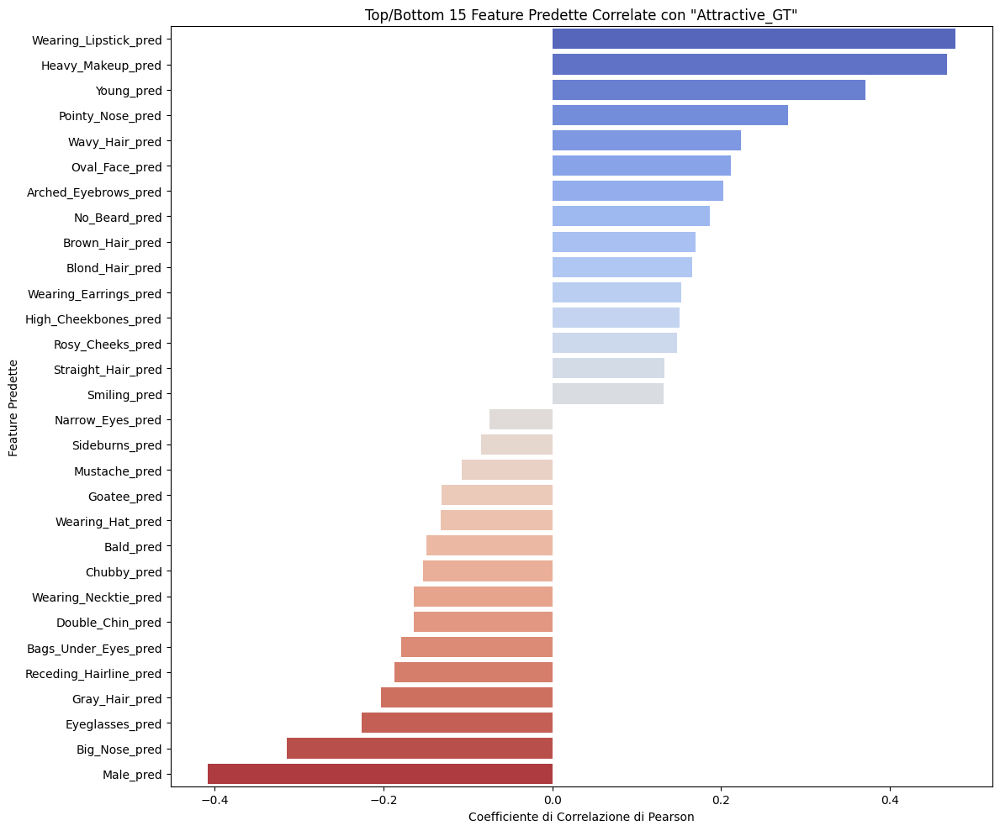

In [95]:
# 1. Crea una copia di pred_attr per non modificare l'originale
df_for_correlation = pred_attr.copy()

# 2. Aggiungi la colonna 'Attractive_GT' (ground truth) al DataFrame
df_for_correlation['Attractive_GT'] = df_for_correlation['image_id'].map(attractive_ground_truth_map)

# 3. Rimuovi righe dove il mapping 'Attractive_GT' potrebbe aver fallito
# e la colonna 'image_id' che non serve per la correlazione numerica
df_for_correlation.dropna(subset=['Attractive_GT'], inplace=True)
df_for_correlation['Attractive_GT'] = df_for_correlation['Attractive_GT'].astype(int)
df_analysis = df_for_correlation.drop(columns=['image_id'])

# 4. Calcola la matrice di correlazione
correlation_matrix = df_analysis.corr()

# 5. Estrai le correlazioni con 'Attractive_GT' e ordinale
attractive_correlations = correlation_matrix['Attractive_GT'].sort_values(ascending=False)

# Rimuovi la correlazione di 'Attractive_GT' con se stessa
attractive_correlations_only_features = attractive_correlations.drop('Attractive_GT')

print("--- Correlazione di Tutte le Feature Predette con 'Attractive_GT' (Ground Truth) ---")
print(attractive_correlations_only_features)

# 6. Visualizza le correlazioni (codice invariato dal tuo esempio)
plt.figure(figsize=(12, 10)) # Aumentato leggermente per più feature
top_bottom_n = 15
# Se il numero totale di feature è piccolo, aggiusta top_bottom_n
num_available_features = len(attractive_correlations_only_features)
if num_available_features < 2 * top_bottom_n:
    # Mostra tutte le feature se sono meno di 2*top_bottom_n
    features_to_plot_corr = attractive_correlations_only_features.sort_values(ascending=False)
    plot_title = f'Correlazione di Tutte le {num_available_features} Feature Predette con "Attractive_GT"'

else:
    features_to_plot_corr = pd.concat([attractive_correlations_only_features.head(top_bottom_n),
                                   attractive_correlations_only_features.tail(top_bottom_n)])
    # Rimuovi duplicati se top_n è grande abbastanza da far sovrapporre head e tail
    # (anche se con sort_values prima, non dovrebbe succedere se head e tail sono disgiunti)
    features_to_plot_corr = features_to_plot_corr[~features_to_plot_corr.index.duplicated(keep='first')]
    plot_title = f'Top/Bottom {top_bottom_n} Feature Predette Correlate con "Attractive_GT"'


sns.barplot(x=features_to_plot_corr.values, y=features_to_plot_corr.index, palette="coolwarm")
plt.title(plot_title)
plt.xlabel('Coefficiente di Correlazione di Pearson')
plt.ylabel('Feature Predette')
plt.tight_layout()
plt.show()

Bias su maschi considerati meno attraenti nel dataset, questo è un bias del dataset stesso e per come è stato creato

Aggiungiamo al nuovo set di feature già utilizzato le ulteriori 5 feature più correlate positivamente e negativamente in valore assoluto.

In [96]:
# --- SELEZIONE DELLE NUOVE FEATURE ---
print("\n--- Selezione Nuove Feature Basata su Correlazione ---")

# Feature già selezionate (quelle di Anzalone)
current_selected_features = set(feature_columns_anzalone)
print(f"Feature già in uso (Anzalone): {len(current_selected_features)} -> {current_selected_features}")

# Seleziona le top 5 correlate positivamente, escludendo quelle già in uso
top_positive_correlated = []
count_positive = 0
for feature, corr_value in attractive_correlations_only_features.items():
    if corr_value <= 0: # Fermati se la correlazione non è più positiva
        break
    if feature not in current_selected_features:
        top_positive_correlated.append(feature)
        count_positive += 1
    if count_positive >= 5:
        break
print(f"Ulteriori 5 feature più correlate positivamente (escluse quelle di Anzalone): {top_positive_correlated}")

bottom_negative_correlated = []
count_negative = 0
# Itera dalla fine della serie (correlazioni più negative)
for feature, corr_value in attractive_correlations_only_features.iloc[::-1].items():
    if corr_value >= 0: # Fermati se la correlazione non è più negativa
        break
    if feature not in current_selected_features and feature not in top_positive_correlated: # Evita duplicati con le positive
        bottom_negative_correlated.append(feature)
        count_negative += 1
    if count_negative >= 5:
        break
print(f"Ulteriori 5 feature più correlate negativamente (escluse quelle di Anzalone e le top positive): {bottom_negative_correlated}")


# Combina le feature di Anzalone con le nuove selezionate
new_feature_set = list(current_selected_features) + top_positive_correlated + bottom_negative_correlated
# Rimuovi eventuali duplicati se una feature di Anzalone fosse per caso tra le top/bottom (improbabile se escluse correttamente)
new_feature_set = sorted(list(set(new_feature_set))) # Ordina per consistenza

print(f"\nNuovo set combinato di feature ({len(new_feature_set)} totali):")
print(new_feature_set)


--- Selezione Nuove Feature Basata su Correlazione ---
Feature già in uso (Anzalone): 10 -> {'Blond_Hair_pred', 'Wearing_Lipstick_pred', 'Smiling_pred', 'Eyeglasses_pred', 'Wearing_Hat_pred', 'Male_pred', 'Bald_pred', 'Heavy_Makeup_pred', 'Young_pred', 'No_Beard_pred'}
Ulteriori 5 feature più correlate positivamente (escluse quelle di Anzalone): ['Pointy_Nose_pred', 'Wavy_Hair_pred', 'Oval_Face_pred', 'Arched_Eyebrows_pred', 'Brown_Hair_pred']
Ulteriori 5 feature più correlate negativamente (escluse quelle di Anzalone e le top positive): ['Big_Nose_pred', 'Gray_Hair_pred', 'Receding_Hairline_pred', 'Bags_Under_Eyes_pred', 'Double_Chin_pred']

Nuovo set combinato di feature (20 totali):
['Arched_Eyebrows_pred', 'Bags_Under_Eyes_pred', 'Bald_pred', 'Big_Nose_pred', 'Blond_Hair_pred', 'Brown_Hair_pred', 'Double_Chin_pred', 'Eyeglasses_pred', 'Gray_Hair_pred', 'Heavy_Makeup_pred', 'Male_pred', 'No_Beard_pred', 'Oval_Face_pred', 'Pointy_Nose_pred', 'Receding_Hairline_pred', 'Smiling_pred',

In [97]:
if 'new_feature_set' not in locals() or not isinstance(new_feature_set, list) or not new_feature_set:
    print("ERRORE: 'new_feature_set' non definito o vuoto. Esegui la cella di selezione feature prima.")
    # exit()
else:
    print(f"Utilizzo del nuovo set di feature: {len(new_feature_set)} feature -> {new_feature_set}")
    current_feature_columns_for_experiment = new_feature_set

print("\nVerifica dati di input fondamentali...")


required_vars_exist = True
if 'pred_attr' not in locals() or not isinstance(pred_attr, pd.DataFrame):
    print("ERRORE: DataFrame 'pred_attr' non definito.")
    required_vars_exist = False
if 'class_df' not in locals() or not isinstance(class_df, pd.DataFrame):
    print("ERRORE: DataFrame 'class_df' (con kmeans_label) non definito.")
    required_vars_exist = False
if 'attractive_ground_truth_map' not in locals() or not isinstance(attractive_ground_truth_map, dict):
    print("ERRORE: 'attractive_ground_truth_map' non definito.")
    required_vars_exist = False
if 'current_feature_columns_for_experiment' not in locals() or not isinstance(current_feature_columns_for_experiment, list):
    print("ERRORE: 'current_feature_columns_for_experiment' non definito.")
    required_vars_exist = False
if 'PROJECT_PATH' not in locals() or not PROJECT_PATH:
    print("ERRORE: 'PROJECT_PATH' non definito.")
    required_vars_exist = False

if not required_vars_exist:
    print("ERRORE CRITICO: Una o più variabili di input fondamentali mancanti. Interruzione.")

else:
    # --- COSTRUZIONE DEL DATAFRAME PER L'ESPERIMENTO ---
    print("\nCostruzione del DataFrame per l'esperimento ML...")
    # 1. Inizia con pred_attr che ha tutte le feature predette e image_id
    df_ml_experiment = pred_attr[['image_id'] + current_feature_columns_for_experiment].copy()

    # 2. Aggiungi kmeans_label da class_df (assumendo che class_df abbia image_id e kmeans_label)
    if 'kmeans_label' in class_df.columns and 'image_id' in class_df.columns:
        # Merge per aggiungere kmeans_label basato su image_id
        df_ml_experiment = pd.merge(df_ml_experiment, class_df[['image_id', 'kmeans_label']], on='image_id', how='left')
        if df_ml_experiment['kmeans_label'].isnull().any():
            print("ATTENZIONE: Alcuni image_id in pred_attr non hanno un kmeans_label corrispondente in class_df.")
            print(f"Numero di righe prima del dropna su kmeans_label: {len(df_ml_experiment)}")
            df_ml_experiment.dropna(subset=['kmeans_label'], inplace=True) # Rimuovi righe senza etichetta cluster
            df_ml_experiment['kmeans_label'] = df_ml_experiment['kmeans_label'].astype(int)
            print(f"Numero di righe dopo il dropna su kmeans_label: {len(df_ml_experiment)}")
    else:
        print("ERRORE: 'kmeans_label' o 'image_id' mancanti in 'class_df'. Impossibile aggiungere etichette cluster.")


    # 3. Verifica che tutte le feature necessarie siano presenti nel df_ml_experiment
    missing_cols_in_df_ml = [col for col in current_feature_columns_for_experiment if col not in df_ml_experiment.columns]
    if missing_cols_in_df_ml:
        print(f"ERRORE CRITICO: Le seguenti feature da 'current_feature_columns_for_experiment' "
              f"non sono state trovate in 'pred_attr' o nel df_ml_experiment risultante: {missing_cols_in_df_ml}. Interruzione.")

    elif df_ml_experiment.empty or 'kmeans_label' not in df_ml_experiment.columns : # Aggiunto controllo per kmeans_label
        print("ERRORE CRITICO: df_ml_experiment è vuoto o manca kmeans_label dopo il merge. Controlla i dati di input.")

    else:
        print("DataFrame per l'esperimento ML ('df_ml_experiment') costruito con successo.")
        print(f"Shape di df_ml_experiment: {df_ml_experiment.shape}")
        print(df_ml_experiment.head())

        num_clusters = df_ml_experiment['kmeans_label'].nunique()
        FORCE_RECALCULATE_ALL = False

        print("\n--- Preparazione Set di Training/Test con Undersampling per Cluster (usando new_feature_set) ---")
        X_train_g, y_train_g, cluster_test_sets = prepare_global_train_and_cluster_test_sets_with_undersampling(
            df_input=df_ml_experiment, # <<<< USA IL DATAFRAME APPENA COSTRUITO
            feature_cols=current_feature_columns_for_experiment,
            id_col='image_id',
            target_col_name='Attractive_GT',
            cluster_label_col='kmeans_label',
            n_clusters=num_clusters,
            test_size_cluster=TEST_SIZE_PER_CLUSTER,
            random_state=RANDOM_STATE,
            perform_undersampling=True
        )

        if X_train_g is not None and not X_train_g.empty:

            def create_dynamic_keras_model(optimizer='adam', dropout_rate=0.2, neurons=64, num_features=len(current_feature_columns_for_experiment)):
                # ... (definizione modello Keras) ...
                model = Sequential()
                model.add(Dense(neurons, input_shape=(num_features,), activation='relu'))
                model.add(Dropout(dropout_rate))
                model.add(Dense(neurons//2, activation='relu'))
                model.add(Dropout(dropout_rate/2))
                model.add(Dense(1, activation='sigmoid'))
                if optimizer == 'adam': opt = Adam()
                elif optimizer == 'rmsprop': opt = RMSprop()
                else: opt = Adam()
                model.compile(optimizer=opt, loss='binary_crossentropy', metrics=['accuracy'])
                return model

            models_to_evaluate = {
                "RandomForest_NewFeatures": {
                    "constructor": lambda: RandomForestClassifier(random_state=RANDOM_STATE, class_weight='balanced'),
                    "params": {
                        'n_estimators': [100, 200, 300], 'max_depth': [10, 20, 30, None],
                        'min_samples_leaf': [2, 4, 6], 'min_samples_split': [5, 10, 15]
                    }, "filename_prefix": "attractive_pred_new_feats"
                },
                "LogisticRegression_NewFeatures": {
                    "constructor": lambda: Pipeline([
                        ('scaler', StandardScaler()),
                        ('logreg', LogisticRegression(random_state=RANDOM_STATE, solver='liblinear', class_weight='balanced', max_iter=300))
                    ]),
                    "params": { 'logreg__C': [0.001, 0.01, 0.1, 1, 10], 'logreg__penalty': ['l1', 'l2']},
                    "filename_prefix": "attractive_pred_new_feats"
                }
            }

            all_models_performance_dfs = []
            trained_models_dict = {}

            for model_name, config in tqdm(models_to_evaluate.items(), desc="Processando Modelli con New Features"):

                print(f"\n{'='*20} Processando Modello: {model_name} {'='*20}")
                model_instance_for_grid = config["constructor"]()
                best_model = train_tune_or_load_classifier(
                    X_train_g, y_train_g, model_name, model_instance_for_grid, config["params"],
                    CV_FOLDS, RANDOM_STATE, PROJECT_PATH, config["filename_prefix"],
                    n_jobs=N_JOBS_GRIDSEARCH, force_retrain=FORCE_RECALCULATE_ALL
                )
                if best_model:
                    trained_models_dict[model_name] = best_model
                    df_perf_clusters = evaluate_model_on_clusters(
                        best_model, model_name, cluster_test_sets,
                        PROJECT_PATH, config["filename_prefix"], force_recalculate=FORCE_RECALCULATE_ALL
                    )
                    if df_perf_clusters is not None and not df_perf_clusters.empty:
                        all_models_performance_dfs.append(df_perf_clusters)

                    X_train_g_df = X_train_g if isinstance(X_train_g, pd.DataFrame) else pd.DataFrame(X_train_g, columns=current_feature_columns_for_experiment)
                    # SHAP commentato
                    '''
                    get_shap_explanations_for_clusters(
                        best_model, model_name, X_train_g_df, cluster_test_sets,
                        current_feature_columns_for_experiment,
                        PROJECT_PATH, config["filename_prefix"],
                        force_recalculate=FORCE_RECALCULATE_ALL
                    )
                    '''
                else:
                    print(f"Skipping valutazione e SHAP per {model_name} a causa di errori nel training/tuning o caricamento.")


            if len(all_models_performance_dfs) > 0:
                final_performance_df_all_models = pd.concat(all_models_performance_dfs)
                print("\n\n--- Riepilogo Performance Complessive dei Modelli sui Cluster (Finale con New Features) ---")
                try:
                    df_to_pivot = final_performance_df_all_models.copy()
                    if 'model' not in df_to_pivot.index.names:
                        if 'model' in df_to_pivot.columns:
                             print("\nMedie Performance per Modello (su tutti i cluster):")
                             print(df_to_pivot.groupby('model')[['auc', 'f1_attractive_1', 'accuracy']].mean())
                             print("\nAUC per Modello e Cluster (pivot):")
                             pivot_auc_all = df_to_pivot.pivot_table(index=df_to_pivot.index, columns='model', values='auc')
                             print(pivot_auc_all)
                        else:
                            print("Colonna 'model' non trovata per il pivot. Stampa DataFrame grezzo:")
                            print(df_to_pivot)
                    else:
                        print(final_performance_df_all_models.groupby(level='model')[['auc', 'f1_attractive_1', 'accuracy']].mean())
                except Exception as e:
                    print(f"Errore durante il pivoting delle performance: {e}")
                    print("Stampa DataFrame grezzo delle performance:")
                    print(final_performance_df_all_models)
            else:
                print("Nessun risultato di performance da aggregare.")
        else:
            print("Training globale non eseguito a causa di problemi nella preparazione dei dati (X_train_g vuoto o None).")

Utilizzo del nuovo set di feature: 20 feature -> ['Arched_Eyebrows_pred', 'Bags_Under_Eyes_pred', 'Bald_pred', 'Big_Nose_pred', 'Blond_Hair_pred', 'Brown_Hair_pred', 'Double_Chin_pred', 'Eyeglasses_pred', 'Gray_Hair_pred', 'Heavy_Makeup_pred', 'Male_pred', 'No_Beard_pred', 'Oval_Face_pred', 'Pointy_Nose_pred', 'Receding_Hairline_pred', 'Smiling_pred', 'Wavy_Hair_pred', 'Wearing_Hat_pred', 'Wearing_Lipstick_pred', 'Young_pred']

Verifica dati di input fondamentali...

Costruzione del DataFrame per l'esperimento ML...
DataFrame per l'esperimento ML ('df_ml_experiment') costruito con successo.
Shape di df_ml_experiment: (202599, 22)
     image_id  Arched_Eyebrows_pred  Bags_Under_Eyes_pred  Bald_pred  \
0  000001.jpg                     0                     0          0   
1  000002.jpg                     0                     1          0   
2  000003.jpg                     0                     0          0   
3  000004.jpg                     0                     0          0   
4 

Preparazione Dati per Cluster (Undersampling):   0%|          | 0/15 [00:00<?, ?it/s]

Dimensioni Training Globale (dopo undersampling per cluster e shuffle): X=(85893, 20), y=(85893,)
Distribuzione target nel Training Globale: 
Attractive_GT
1    0.500017
0    0.499983
Name: proportion, dtype: float64
Numero di Test Set per Cluster: 15

Riepilogo dimensioni Test Set per Cluster (dopo undersampling sul training del cluster):
  Cluster 0: Test Size = 2840, Original Cluster Size (prima di bilanciare per split) = 18005, Balanced Data Size (prima di split) = 14196
  Cluster 1: Test Size = 2400, Original Cluster Size (prima di bilanciare per split) = 33458, Balanced Data Size (prima di split) = 11996
  Cluster 2: Test Size = 2562, Original Cluster Size (prima di bilanciare per split) = 13440, Balanced Data Size (prima di split) = 12808
  Cluster 3: Test Size = 170, Original Cluster Size (prima di bilanciare per split) = 12221, Balanced Data Size (prima di split) = 848
  Cluster 4: Test Size = 2750, Original Cluster Size (prima di bilanciare per split) = 21020, Balanced Data S

Processando Modelli con New Features:   0%|          | 0/2 [00:00<?, ?it/s]


==================== Processando Modello: RandomForest_NewFeatures ====================
Caricamento modello pre-addestrato: RandomForest_NewFeatures da /content/drive/MyDrive/Data Analytics for Business/Progetto/trained_models/attractive_pred_new_feats_RandomForest_NewFeatures.joblib
Modello RandomForest_NewFeatures caricato con successo.
Caricamento risultati performance pre-calcolati per RandomForest_NewFeatures da /content/drive/MyDrive/Data Analytics for Business/Progetto/evaluation_results/attractive_pred_new_feats_RandomForest_NewFeatures_cluster_performance.csv
Risultati performance per RandomForest_NewFeatures caricati.

--- Performance di RandomForest_NewFeatures sui Test Set dei Cluster (caricate) ---
                       model  size  accuracy  f1_attractive_1  \
0   RandomForest_NewFeatures  2840  0.599296         0.575690   
1   RandomForest_NewFeatures  2400  0.708750         0.719390   
2   RandomForest_NewFeatures  2562  0.604606         0.597217   
3   RandomForest_N

Abbiamo visto che utilizzando questo nuovo set di feature le metriche di performance sono cresciute. In particolare guardiamo alla metrica AUC (Area under the ROC Curve) in quanto rappresenta una metrica più affidabile, insieme all'F1-Score, rispetto all'Accuracy, quando il dataset è sbilanciato.

In [98]:
import joblib
import os
from sklearn.pipeline import Pipeline

print("="*10 + " ESPERIMENTO 2: new_feature_set - Train/Test Bilanciati " + "="*10)

# ----- RandomForest_NewFeatures -----
model_name_rf_nf = "RandomForest_NewFeatures" # Nome chiave usato nel dizionario models_to_evaluate
filename_prefix_rf_nf = "attractive_pred_new_feats" # Prefisso usato per questo esperimento
model_path_rf_nf = os.path.join(PROJECT_PATH, MODELS_DIR, f"{filename_prefix_rf_nf}_{model_name_rf_nf}.joblib")


print(f"\n--- Modello: {model_name_rf_nf} ---")
if os.path.exists(model_path_rf_nf):
    try:
        loaded_model_rf_nf = joblib.load(model_path_rf_nf)
        print(f"Modello '{model_name_rf_nf}' caricato da: {model_path_rf_nf}")

        rf_nf_params = loaded_model_rf_nf.get_params()
        print("Iperparametri trovati:")
        print(f"  n_estimators: {rf_nf_params.get('n_estimators')}")
        print(f"  max_depth: {rf_nf_params.get('max_depth')}")
        print(f"  min_samples_leaf: {rf_nf_params.get('min_samples_leaf')}")
        print(f"  min_samples_split: {rf_nf_params.get('min_samples_split')}")
    except Exception as e:
        print(f"Errore durante il caricamento del modello {model_name_rf_nf}: {e}")
else:
    print(f"File modello non trovato per {model_name_rf_nf} in: {model_path_rf_nf}")


# ----- LogisticRegression_NewFeatures -----
model_name_lr_nf = "LogisticRegression_NewFeatures" # Nome chiave usato nel dizionario
filename_prefix_lr_nf = "attractive_pred_new_feats" # Prefisso usato
model_path_lr_nf = os.path.join(PROJECT_PATH, MODELS_DIR, f"{filename_prefix_lr_nf}_{model_name_lr_nf}.joblib")


print(f"\n--- Modello: {model_name_lr_nf} ---")
if os.path.exists(model_path_lr_nf):
    try:
        loaded_model_lr_nf = joblib.load(model_path_lr_nf)
        print(f"Modello '{model_name_lr_nf}' caricato da: {model_path_lr_nf}")

        if isinstance(loaded_model_lr_nf, Pipeline):
            logreg_nf_step_params = loaded_model_lr_nf.named_steps['logreg'].get_params()
            print("Iperparametri trovati per lo step 'logreg':")
            print(f"  C (logreg__C): {logreg_nf_step_params.get('C')}")
            print(f"  penalty (logreg__penalty): {logreg_nf_step_params.get('penalty')}")
        else:
            print("Attenzione: Il modello LogisticRegression_NewFeatures caricato non è una Pipeline come atteso.")
    except Exception as e:
        print(f"Errore durante il caricamento del modello {model_name_lr_nf}: {e}")
else:
    print(f"File modello non trovato per {model_name_lr_nf} in: {model_path_lr_nf}")

print("\n" + "="*60)

========== ESPERIMENTO 2: new_feature_set - Train/Test Bilanciati ==========

--- Modello: RandomForest_NewFeatures ---
Modello 'RandomForest_NewFeatures' caricato da: /content/drive/MyDrive/Data Analytics for Business/Progetto/trained_models/attractive_pred_new_feats_RandomForest_NewFeatures.joblib
Iperparametri trovati:
  n_estimators: 300
  max_depth: 30
  min_samples_leaf: 4
  min_samples_split: 15

--- Modello: LogisticRegression_NewFeatures ---
Modello 'LogisticRegression_NewFeatures' caricato da: /content/drive/MyDrive/Data Analytics for Business/Progetto/trained_models/attractive_pred_new_feats_LogisticRegression_NewFeatures.joblib
Iperparametri trovati per lo step 'logreg':
  C (logreg__C): 10
  penalty (logreg__penalty): l1



## Esperimento con new_feature_set e solo train set bilanciato "Robust_Sampling"

Come detto in precedenza proviamo ad effettuare un ulteriore test per valutare i modelli di machine learning effettuando un undersampling dinamico tra training e test set durante la cross-validation

In [99]:

import numpy as np
from tqdm.notebook import tqdm
from sklearn.model_selection import train_test_split



def prepare_train_test_robust_undersampling(
    df_input, # DataFrame originale (es. df_ml_experiment)
    feature_cols,
    id_col,
    target_col_name,
    cluster_label_col,
    n_clusters,
    test_size_cluster, # Proporzione per il test set del cluster (es. 0.20)
    random_state,
    perform_undersampling_on_train_split=True # Flag per attivare l'undersampling sulla porzione di training del cluster
):
    """
    Prepara un dataset di training globale e set di test specifici per ogni cluster.
    1. Esegue lo split train/test sui dati ORIGINALI di ciascun cluster.
    2. Applica UNDERSAMPLING sulla classe maggioritaria del target SOLO sulla PORZIONE DI TRAINING di quel cluster.
    3. Il TEST SET del cluster rimane ORIGINALE e sbilanciato.
    4. Concatena le porzioni di training (ora bilanciate per cluster) per formare il training set globale.
    """
    X_train_global_list = []
    y_train_global_list = []
    test_sets_per_cluster = {} # Conterrà i test set originali e sbilanciati dei cluster

    df = df_input.copy()

    # Aggiungi colonna target e pulisci
    df[target_col_name] = df[id_col].map(attractive_ground_truth_map)
    df_cleaned = df.dropna(subset=[target_col_name])
    if df_cleaned.empty:
        print(f"ERRORE: Nessun dato valido dopo il mapping del target (colonna '{target_col_name}').")
        return None, None, None
    df_cleaned[target_col_name] = df_cleaned[target_col_name].astype(int)

    print(f"Distribuzione target '{target_col_name}' nel dataset completo prima dello split: \n{df_cleaned[target_col_name].value_counts(normalize=True)}")

    for i in tqdm(range(n_clusters), desc="Preparazione Dati per Cluster (Robust Undersampling)", leave=False):
        cluster_data_original = df_cleaned[df_cleaned[cluster_label_col] == i]

        if len(cluster_data_original) < 10: # Soglia minima per considerare un cluster per lo split
            print(f"Cluster {i}: troppo piccolo ({len(cluster_data_original)} campioni) per split train/test, skipping.")
            continue

        X_c_original = cluster_data_original[feature_cols]
        y_c_original = cluster_data_original[target_col_name]

        # 1. Esegui lo split train/test sui dati ORIGINALI del cluster
        X_train_c_orig, X_test_c_orig, y_train_c_orig, y_test_c_orig = pd.DataFrame(), pd.DataFrame(), pd.Series(dtype='int'), pd.Series(dtype='int')

        if len(y_c_original.unique()) < 2 or len(y_c_original) * test_size_cluster < 1 or len(y_c_original) * (1-test_size_cluster) < 1 :
            print(f"Cluster {i}: solo una classe o troppo piccolo per split stratificato ({len(y_c_original)} campioni). Uso tutto per training (e non ci sarà test set per questo cluster).")
            X_train_c_to_balance = X_c_original.copy()
            y_train_c_to_balance = y_c_original.copy()
            # X_test_c_orig e y_test_c_orig rimangono vuoti
        else:
            try:
                X_train_c_to_balance, X_test_c_orig, y_train_c_to_balance, y_test_c_orig = train_test_split(
                    X_c_original, y_c_original,
                    test_size=test_size_cluster,
                    random_state=random_state,
                    stratify=y_c_original, # Stratifica se possibile
                    shuffle=True
                )
            except ValueError: # Fallback se stratify fallisce (es. una classe ha meno di 2 campioni)
                print(f"Cluster {i}: Impossibile stratificare, split non stratificato.")
                X_train_c_to_balance, X_test_c_orig, y_train_c_to_balance, y_test_c_orig = train_test_split(
                    X_c_original, y_c_original,
                    test_size=test_size_cluster,
                    random_state=random_state,
                    shuffle=True
                )

        # Memorizza il test set del cluster (originale e sbilanciato)
        if not X_test_c_orig.empty:
            test_sets_per_cluster[i] = {
                'X_test': X_test_c_orig,
                'y_test': y_test_c_orig,
                'original_cluster_size': len(cluster_data_original)
            }
        else:
            print(f"Cluster {i}: Nessun test set generato (probabilmente troppo piccolo).")


        # 2. Applica UNDERSAMPLING SOLO sulla PORZIONE DI TRAINING (X_train_c_to_balance, y_train_c_to_balance)
        X_train_c_balanced = X_train_c_to_balance
        y_train_c_balanced = y_train_c_to_balance

        if perform_undersampling_on_train_split and not X_train_c_to_balance.empty:
            df_train_c_to_balance = pd.concat([X_train_c_to_balance, y_train_c_to_balance.rename(target_col_name)], axis=1)
            counts_train_c = df_train_c_to_balance[target_col_name].value_counts()

            if len(counts_train_c) < 2:
                # print(f"Cluster {i} (Training Split): solo una classe target presente, no undersampling.")
                pass # Lascia X_train_c_balanced e y_train_c_balanced come sono
            else:
                minority_class_count_train_c = counts_train_c.min()
                majority_class_label_train_c = counts_train_c.idxmax()

                if counts_train_c[majority_class_label_train_c] > minority_class_count_train_c: # Se c'è sbilanciamento
                    df_majority_train_c = df_train_c_to_balance[df_train_c_to_balance[target_col_name] == majority_class_label_train_c]
                    df_minority_train_c = df_train_c_to_balance[df_train_c_to_balance[target_col_name] != majority_class_label_train_c] # Include tutte le altre (se multiclasse, ma qui è binario)

                    df_majority_undersampled_train_c = resample(df_majority_train_c,
                                                                replace=False,
                                                                n_samples=minority_class_count_train_c,
                                                                random_state=random_state)

                    df_train_c_balanced_final = pd.concat([df_majority_undersampled_train_c, df_minority_train_c])
                    X_train_c_balanced = df_train_c_balanced_final[feature_cols]
                    y_train_c_balanced = df_train_c_balanced_final[target_col_name]
                    # print(f"  Cluster {i} (Training Split): Undersampling. Da {counts_train_c[majority_class_label_train_c]} a {minority_class_count_train_c} per classe {majority_class_label_train_c}. "
                    #       f"Totale training bilanciato per cluster: {len(X_train_c_balanced)}")

        if not X_train_c_balanced.empty:
            X_train_global_list.append(X_train_c_balanced)
            y_train_global_list.append(y_train_c_balanced)

    if not X_train_global_list:
        print("ERRORE: Nessun dato di training globale generato. Controlla i cluster e le soglie.")
        return None, None, None

    X_train_global = pd.concat(X_train_global_list)
    y_train_global = pd.concat(y_train_global_list)

    # Shuffle globale del training set aggregato
    indices_shuffled = np.arange(len(X_train_global))
    np.random.seed(random_state) # Assicura riproducibilità dello shuffle
    np.random.shuffle(indices_shuffled)
    X_train_global = X_train_global.iloc[indices_shuffled].reset_index(drop=True)
    y_train_global = y_train_global.iloc[indices_shuffled].reset_index(drop=True)


    print(f"\nDimensioni Training Globale (dopo undersampling su train split per cluster e shuffle): X={X_train_global.shape}, y={y_train_global.shape}")
    if not y_train_global.empty:
        print(f"Distribuzione target nel Training Globale: \n{y_train_global.value_counts(normalize=True)}")
    print(f"Numero di Test Set per Cluster (originali, sbilanciati): {len(test_sets_per_cluster)}")

    print("\nRiepilogo dimensioni Test Set per Cluster (originali, sbilanciati):")
    for cid, data in test_sets_per_cluster.items():
        print(f"  Cluster {cid}: Test Size = {len(data['X_test'])}, (Original Cluster Size = {data['original_cluster_size']})")

    return X_train_global, y_train_global, test_sets_per_cluster

def train_tune_or_load_classifier(X_train, y_train, model_name, base_model_instance, param_grid,
                                  cv_folds, random_state, project_path, model_filename_prefix,
                                  n_jobs=-1, force_retrain=False):

    model_dir_path = os.path.join(project_path, MODELS_DIR)
    os.makedirs(model_dir_path, exist_ok=True)
    model_path = os.path.join(model_dir_path, f"{model_filename_prefix}_{model_name}.joblib")
    if os.path.exists(model_path) and not force_retrain:
        print(f"Caricamento modello pre-addestrato: {model_name} da {model_path}")
        try:
            best_model = joblib.load(model_path)
            print(f"Modello {model_name} caricato con successo.")
            return best_model
        except Exception as e:
            print(f"Errore durante il caricamento del modello {model_name}: {e}. Rieseguo il training.")
    print(f"\n--- Training e Tuning per: {model_name} (Modello non trovato o force_retrain=True) ---")
    current_model = base_model_instance
    grid_search = GridSearchCV(estimator=current_model, param_grid=param_grid, cv=cv_folds,
                               scoring='roc_auc', verbose=1, n_jobs=n_jobs, error_score='raise')
    try:
        grid_search.fit(X_train, y_train)
    except Exception as e:
        print(f"Errore FATALE durante GridSearchCV per {model_name}: {e}")
        print("Controlla la configurazione del modello e i dati.")
        return None
    if np.isnan(grid_search.best_score_):
        print(f"ATTENZIONE: Miglior AUC (CV) per {model_name} è nan.")
        print(f"Verrà usato il modello corrispondente a best_params_: {grid_search.best_params_}, ma le performance CV non sono affidabili.")
        best_model = grid_search.best_estimator_
    else:
        best_model = grid_search.best_estimator_
        print(f"Migliori iperparametri per {model_name}: {grid_search.best_params_}")
        print(f"Miglior AUC (CV) per {model_name}: {grid_search.best_score_:.4f}")
    try:
        joblib.dump(best_model, model_path)
        print(f"Modello {model_name} salvato in: {model_path}")
    except Exception as e:
        print(f"Errore durante il salvataggio del modello {model_name}: {e}")
    return best_model


def evaluate_model_on_clusters(model, model_name, test_sets_per_cluster, project_path, results_filename_prefix, force_recalculate=False):

    # L'output stampato e salvato ora descriverà performance su test set sbilanciati.
    results_dir_path = os.path.join(project_path, RESULTS_DIR)
    os.makedirs(results_dir_path, exist_ok=True)
    results_path = os.path.join(results_dir_path, f"{results_filename_prefix}_{model_name}_cluster_performance_robust_sampling.csv") # Aggiunto suffisso
    if os.path.exists(results_path) and not force_recalculate:
        print(f"Caricamento risultati performance (robust sampling) pre-calcolati per {model_name} da {results_path}")
        try:
            df_performance = pd.read_csv(results_path, index_col=0)
            print(f"Risultati performance per {model_name} caricati.")
            print(f"\n--- Performance di {model_name} sui Test Set dei Cluster (caricate - robust sampling) ---")
            print(df_performance)
            return df_performance
        except Exception as e:
            print(f"Errore caricamento risultati: {e}. Ricalcolo.")
    print(f"\n--- Calcolo Performance di {model_name} sui Test Set dei Cluster (Robust Sampling) ---")
    cluster_performance = {}
    valid_clusters_for_eval = 0
    for cluster_id, data in tqdm(test_sets_per_cluster.items(), desc=f"Valutazione {model_name} su Cluster", leave=False):
        X_test_c = data['X_test']
        y_test_c = data['y_test']
        if X_test_c.empty or len(X_test_c) < 2 :
            cluster_performance[cluster_id] = {'model': model_name, 'size': len(X_test_c), 'accuracy': np.nan, 'f1_attractive_1': np.nan, 'f1_attractive_0': np.nan, 'tpr_attractive_1': np.nan, 'fpr_attractive_1': np.nan, 'auc': np.nan}
            continue
        if len(y_test_c.unique()) < 2:
            y_pred_c = model.predict(X_test_c)
            acc = accuracy_score(y_test_c, y_pred_c)
            cluster_performance[cluster_id] = {'model': model_name, 'size': len(X_test_c), 'accuracy': acc, 'f1_attractive_1': np.nan, 'f1_attractive_0': np.nan, 'tpr_attractive_1': np.nan, 'fpr_attractive_1': np.nan, 'auc': np.nan}
            valid_clusters_for_eval +=1
            continue
        y_pred_c = model.predict(X_test_c)
        y_proba_c = model.predict_proba(X_test_c)[:, 1]
        report_dict = classification_report(y_test_c, y_pred_c, output_dict=True, zero_division=0)
        auc_c = roc_auc_score(y_test_c, y_proba_c)
        cm = confusion_matrix(y_test_c, y_pred_c)
        tn, fp, fn, tp = cm.ravel() if cm.size == 4 else (sum(y_test_c==0),0,0,sum(y_test_c==1)) if sum(y_test_c==0)>0 and sum(y_test_c==1)>0 else (0,0,0,0)
        tpr_attractive = tp / (tp + fn) if (tp + fn) > 0 else 0
        fpr_attractive = fp / (fp + tn) if (fp + tn) > 0 else 0
        cluster_performance[cluster_id] = {'model': model_name, 'size': len(X_test_c), 'accuracy': report_dict['accuracy'], 'f1_attractive_1': report_dict.get('1', {}).get('f1-score', np.nan), 'f1_attractive_0': report_dict.get('0', {}).get('f1-score', np.nan), 'tpr_attractive_1': tpr_attractive, 'fpr_attractive_1': fpr_attractive, 'auc': auc_c}
        valid_clusters_for_eval +=1
    if valid_clusters_for_eval == 0 :
        print(f"Nessun cluster aveva dati sufficienti per valutazione completa per {model_name}.")
        return pd.DataFrame()
    df_performance = pd.DataFrame.from_dict(cluster_performance, orient='index')
    print(f"\n--- Performance Calcolate di {model_name} sui Test Set dei Cluster (Robust Sampling) ---")
    print(df_performance.head())
    try:
        df_performance.to_csv(results_path)
        print(f"Risultati performance (robust sampling) per {model_name} salvati in: {results_path}")
    except Exception as e:
        print(f"Errore salvataggio risultati performance: {e}")
    return df_performance



def get_shap_explanations_for_clusters(model, model_name, X_train_global_for_explainer, test_sets_per_cluster,
                                       feature_cols, project_path, results_filename_prefix, force_recalculate=False):

    results_dir_path = os.path.join(project_path, RESULTS_DIR)
    shap_plots_path_base = os.path.join(project_path, SHAP_PLOTS_DIR, model_name)
    os.makedirs(results_dir_path, exist_ok=True)
    os.makedirs(shap_plots_path_base, exist_ok=True)
    shap_comparison_path = os.path.join(results_dir_path, f"{results_filename_prefix}_{model_name}_shap_comparison_robust_sampling.csv") # Suffisso aggiunto
    if os.path.exists(shap_comparison_path) and not force_recalculate:
        print(f"Caricamento dati SHAP (robust sampling) pre-calcolati per {model_name} da {shap_comparison_path}")
        try:
            df_shap_comparison = pd.read_csv(shap_comparison_path, index_col=0)
            print(f"Dati SHAP per {model_name} caricati.")
            if not df_shap_comparison.empty: # Visualizza solo se non vuoto
                print("\n\n--- Confronto Importanza Media Assoluta SHAP (Modello Globale) tra Cluster (caricato - robust sampling) ---")
                plt.figure(figsize=(max(10, len(feature_cols)), max(4, len(df_shap_comparison.index) * 0.6)))
                sns.heatmap(df_shap_comparison, annot=True, cmap="viridis", fmt=".3f")
                plt.title(f"Importanza Media SHAP ({model_name} Globale) per Cluster (Predizione 'Attractive')")
                plt.ylabel("Cluster ID")
                plt.show()
            return df_shap_comparison
        except Exception as e:
            print(f"Errore caricamento dati SHAP: {e}. Ricalcolo.")
    print(f"\n--- Calcolo Analisi SHAP per {model_name} (Modello Globale, Training Robusto) sui dati dei Cluster ---")
    if len(X_train_global_for_explainer) > 500:
        background_data_shap = shap.sample(X_train_global_for_explainer, 100)
    else:
        background_data_shap = X_train_global_for_explainer.copy()
    explainer = None; final_estimator_for_shap = model; scaler_for_shap = None
    if hasattr(model, 'steps'):
        final_estimator_for_shap = model.steps[-1][1]
        if 'scaler' in model.named_steps:
            scaler_for_shap = model.named_steps['scaler']
            background_data_shap = scaler_for_shap.transform(background_data_shap)
    try:
        if isinstance(final_estimator_for_shap, RandomForestClassifier): explainer = shap.TreeExplainer(final_estimator_for_shap, data=background_data_shap)
        elif isinstance(final_estimator_for_shap, LogisticRegression) or (isinstance(final_estimator_for_shap, SVC) and final_estimator_for_shap.kernel == 'linear'): explainer = shap.LinearExplainer(final_estimator_for_shap, background_data_shap)
        elif isinstance(final_estimator_for_shap, SVC) and final_estimator_for_shap.kernel == 'rbf':
             print(f"Avviso: Uso di KernelExplainer per {model_name} (SVM RBF), potrebbe essere lento.")
             explainer = shap.KernelExplainer(model.predict_proba if scaler_for_shap else final_estimator_for_shap.predict_proba, background_data_shap)
        else:
            print(f"Avviso: Tipo modello non gestito esplicitamente. Uso di KernelExplainer per {model_name}, potrebbe essere lento.")
            explainer = shap.KernelExplainer(model.predict_proba if scaler_for_shap else final_estimator_for_shap.predict_proba, background_data_shap)
    except Exception as e: print(f"Errore inizializzazione SHAP Explainer: {e}"); return pd.DataFrame()
    all_cluster_shap_means = {}
    for cluster_id, data in tqdm(test_sets_per_cluster.items(), desc=f"Analisi SHAP {model_name} su Cluster", leave=False):
        X_test_c_orig = data['X_test']
        if X_test_c_orig.empty or len(X_test_c_orig) < 2: continue
        X_test_c_for_shap = scaler_for_shap.transform(X_test_c_orig) if scaler_for_shap and not isinstance(explainer, shap.KernelExplainer) else X_test_c_orig
        try:
            shap_values_c_raw = explainer.shap_values(X_test_c_for_shap, nsamples='auto' if isinstance(explainer, shap.KernelExplainer) else None)
            shap_values_to_plot = None
            if isinstance(shap_values_c_raw, list) and len(shap_values_c_raw) == 2: shap_values_to_plot = shap_values_c_raw[1]
            elif isinstance(shap_values_c_raw, np.ndarray) and shap_values_c_raw.ndim == X_test_c_for_shap.ndim : shap_values_to_plot = shap_values_c_raw
            else: print(f"    Formato SHAP values non gestito per cluster {cluster_id}."); continue
            data_for_summary_plot = X_test_c_orig if isinstance(X_test_c_for_shap, np.ndarray) and isinstance(X_test_c_orig, pd.DataFrame) else X_test_c_for_shap
            plt.figure(); shap.summary_plot(shap_values_to_plot, data_for_summary_plot, feature_names=feature_cols, show=False, max_display=len(feature_cols))
            plt.title(f"SHAP Summary (Global {model_name}) - On Cluster {cluster_id} Data")
            plot_path = os.path.join(shap_plots_path_base, f"shap_summary_cluster_{cluster_id}_robust_sampling.png"); plt.savefig(plot_path, bbox_inches='tight'); plt.close()
            all_cluster_shap_means[cluster_id] = pd.Series(np.abs(shap_values_to_plot).mean(axis=0), index=feature_cols)
        except Exception as e_shap_c: print(f"    Errore calcolo/plotting SHAP per cluster {cluster_id} ({model_name}): {e_shap_c}")
    df_shap_comparison = pd.DataFrame()
    if all_cluster_shap_means:
        df_shap_comparison = pd.DataFrame(all_cluster_shap_means).T
        print("\n\n--- Confronto Importanza Media Assoluta SHAP (Modello Globale, Training Robusto) tra Cluster ---")
        print(df_shap_comparison.head())
        plt.figure(figsize=(max(10, len(feature_cols)), max(4, len(df_shap_comparison.index) * 0.6)))
        sns.heatmap(df_shap_comparison, annot=True, cmap="viridis", fmt=".3f")
        plt.title(f"Importanza Media SHAP ({model_name} Globale) per Cluster (Predizione 'Attractive')")
        plt.ylabel("Cluster ID")
        heatmap_path = os.path.join(shap_plots_path_base, "shap_heatmap_comparison_robust_sampling.png"); plt.savefig(heatmap_path, bbox_inches='tight'); plt.close()
        try:
            df_shap_comparison.to_csv(shap_comparison_path)
            print(f"Dati SHAP comparison (robust sampling) per {model_name} salvati in: {shap_comparison_path}")
        except Exception as e: print(f"Errore salvataggio dati SHAP comparison: {e}")
    return df_shap_comparison

In [100]:
# --- BLOCCO PRINCIPALE DI ESECUZIONE (USANDO LA NUOVA FUNZIONE DI PREPARAZIONE DATI) ---
# ... (Stessi controlli iniziali su variabili globali, class_df, new_feature_set, ecc.) ...

if 'class_df' not in locals() or 'new_feature_set' not in locals(): # Aggiungi tutti i controlli necessari
    print("ERRORE: Variabili fondamentali non definite. Esegui le celle precedenti.")
else:
    current_feature_columns_for_experiment = new_feature_set
    # ... (resto dei controlli come nel tuo ultimo blocco principale) ...
    print("\nVerifica dati di input fondamentali...")
    required_vars_exist = True
    # ... (controlli identici al tuo ultimo blocco principale) ...
    if not required_vars_exist:
        print("ERRORE CRITICO: Una o più variabili di input fondamentali mancanti. Interruzione.")
    else:
        df_ml_experiment = pred_attr[['image_id'] + current_feature_columns_for_experiment].copy()
        if 'kmeans_label' in class_df.columns and 'image_id' in class_df.columns:
            df_ml_experiment = pd.merge(df_ml_experiment, class_df[['image_id', 'kmeans_label']], on='image_id', how='left')
            if df_ml_experiment['kmeans_label'].isnull().any():
                df_ml_experiment.dropna(subset=['kmeans_label'], inplace=True)
                df_ml_experiment['kmeans_label'] = df_ml_experiment['kmeans_label'].astype(int)
        else: print("ERRORE: 'kmeans_label' o 'image_id' mancanti in 'class_df'."); # exit()

        missing_cols_in_df_ml = [col for col in current_feature_columns_for_experiment if col not in df_ml_experiment.columns]
        if missing_cols_in_df_ml: print(f"ERRORE CRITICO: Feature mancanti: {missing_cols_in_df_ml}."); # exit()
        elif df_ml_experiment.empty or 'kmeans_label' not in df_ml_experiment.columns : print("ERRORE CRITICO: df_ml_experiment vuoto o manca kmeans_label."); # exit()
        else:
            print("DataFrame per l'esperimento ML ('df_ml_experiment') costruito con successo.")
            num_clusters = df_ml_experiment['kmeans_label'].nunique()
            FORCE_RECALCULATE_ALL = False # << CAMBIA A TRUE PER IL PRIMO RUN CON QUESTA STRATEGIA

            print("\n--- Preparazione Set di Training/Test con UNDERSAMPLING ROBUSTO per Cluster ---")
            X_train_g, y_train_g, cluster_test_sets_robust = prepare_train_test_robust_undersampling(
                df_input=df_ml_experiment,
                feature_cols=current_feature_columns_for_experiment,
                id_col='image_id',
                target_col_name='Attractive_GT',
                cluster_label_col='kmeans_label',
                n_clusters=num_clusters,
                test_size_cluster=TEST_SIZE_PER_CLUSTER, # es. 0.20
                random_state=RANDOM_STATE,
                perform_undersampling_on_train_split=True # Attiva la nuova logica
            )

            if X_train_g is not None and not X_train_g.empty:
                # RIDEFINISCI create_dynamic_keras_model QUI se non è globale
                def create_dynamic_keras_model(optimizer='adam', dropout_rate=0.2, neurons=64, num_features=len(current_feature_columns_for_experiment)):
                    # ... (definizione modello Keras come prima) ...
                    model = Sequential()
                    model.add(Dense(neurons, input_shape=(num_features,), activation='relu'))
                    model.add(Dropout(dropout_rate))
                    model.add(Dense(neurons//2, activation='relu'))
                    model.add(Dropout(dropout_rate/2))
                    model.add(Dense(1, activation='sigmoid'))
                    if optimizer == 'adam': opt = Adam()
                    elif optimizer == 'rmsprop': opt = RMSprop()
                    else: opt = Adam()
                    model.compile(optimizer=opt, loss='binary_crossentropy', metrics=['accuracy'])
                    return model

                models_to_evaluate_robust = {
                    "RandomForest_RobustSamp": {
                        "constructor": lambda: RandomForestClassifier(random_state=RANDOM_STATE, class_weight='balanced'),
                        "params": { # Usa una griglia leggermente ridotta per il primo test con nuova strategia
                            'n_estimators': [100, 200], 'max_depth': [20, None],
                            'min_samples_leaf': [4, 6], 'min_samples_split': [10, 15]
                        },
                        "filename_prefix": "attractive_pred_robust_samp"
                    },
                    "LogReg_RobustSamp": { # Abbreviato nome per filename
                        "constructor": lambda: Pipeline([
                            ('scaler', StandardScaler()),
                            ('logreg', LogisticRegression(random_state=RANDOM_STATE, solver='liblinear', class_weight='balanced', max_iter=300))
                        ]),
                        "params": { 'logreg__C': [0.01, 0.1, 1, 10], 'logreg__penalty': ['l2']}, # Solo L2 per velocità
                        "filename_prefix": "attractive_pred_robust_samp"
                    },
                    # "NeuralNetworkKeras_RobustSamp": { ... } # Puoi aggiungere la NN dopo aver testato RF e LogReg
                }

                all_models_performance_dfs_robust = []
                # trained_models_dict_robust = {} # Non strettamente necessario se non riusi i modelli subito

                for model_name, config in tqdm(models_to_evaluate_robust.items(), desc="Processando Modelli (Robust Sampling)"):
                    print(f"\n{'='*20} Processando Modello: {model_name} {'='*20}")
                    model_instance_for_grid = config["constructor"]()
                    best_model = train_tune_or_load_classifier(
                        X_train_g, y_train_g, model_name, model_instance_for_grid, config["params"],
                        CV_FOLDS, RANDOM_STATE, PROJECT_PATH, config["filename_prefix"],
                        n_jobs=N_JOBS_GRIDSEARCH, force_retrain=FORCE_RECALCULATE_ALL
                    )
                    if best_model:
                        # trained_models_dict_robust[model_name] = best_model
                        df_perf_clusters_robust = evaluate_model_on_clusters(
                            best_model, model_name, cluster_test_sets_robust, # Usa i test set robusti
                            PROJECT_PATH, config["filename_prefix"], # Il suffisso _robust_sampling è già nel filename_prefix
                            force_recalculate=FORCE_RECALCULATE_ALL
                        )
                        if df_perf_clusters_robust is not None and not df_perf_clusters_robust.empty:
                            all_models_performance_dfs_robust.append(df_perf_clusters_robust)

                        X_train_g_df_robust = X_train_g if isinstance(X_train_g, pd.DataFrame) else pd.DataFrame(X_train_g, columns=current_feature_columns_for_experiment)
                        # Commentato SHAP
                        '''
                        get_shap_explanations_for_clusters(
                            best_model, model_name, X_train_g_df_robust, cluster_test_sets_robust,
                            current_feature_columns_for_experiment,
                            PROJECT_PATH, config["filename_prefix"],
                            force_recalculate=FORCE_RECALCULATE_ALL
                        )
                        '''
                    else:
                        print(f"Skipping valutazione e SHAP per {model_name} (robust) a causa di errori.")

                # ... (Codice di confronto performance finale come prima, usando all_models_performance_dfs_robust) ...
                if len(all_models_performance_dfs_robust) > 0:
                    final_performance_df_all_models_robust = pd.concat(all_models_performance_dfs_robust)
                    print("\n\n--- Riepilogo Performance (Robust Sampling) ---")
                    # ... (stampa e pivot come prima) ...
                    try:
                        df_to_pivot_robust = final_performance_df_all_models_robust.copy()
                        if 'model' in df_to_pivot_robust.columns:
                             print("\nMedie Performance per Modello (su tutti i cluster - Robust Sampling):")
                             print(df_to_pivot_robust.groupby('model')[['auc', 'f1_attractive_1', 'accuracy']].mean())
                             # ... (altri pivot se desiderato) ...
                        else: print("Colonna 'model' non trovata per il pivot (Robust)."); print(df_to_pivot_robust)
                    except Exception as e: print(f"Errore pivoting (Robust): {e}"); print(final_performance_df_all_models_robust)
                else: print("Nessun risultato di performance (Robust Sampling) da aggregare.")
            else:
                print("Training globale non eseguito a causa di problemi nella preparazione dei dati (X_train_g vuoto o None con Robust Sampling).")


Verifica dati di input fondamentali...
DataFrame per l'esperimento ML ('df_ml_experiment') costruito con successo.

--- Preparazione Set di Training/Test con UNDERSAMPLING ROBUSTO per Cluster ---
Distribuzione target 'Attractive_GT' nel dataset completo prima dello split: 
Attractive_GT
1    0.512505
0    0.487495
Name: proportion, dtype: float64


Preparazione Dati per Cluster (Robust Undersampling):   0%|          | 0/15 [00:00<?, ?it/s]


Dimensioni Training Globale (dopo undersampling su train split per cluster e shuffle): X=(85896, 20), y=(85896,)
Distribuzione target nel Training Globale: 
Attractive_GT
1    0.5
0    0.5
Name: proportion, dtype: float64
Numero di Test Set per Cluster (originali, sbilanciati): 15

Riepilogo dimensioni Test Set per Cluster (originali, sbilanciati):
  Cluster 0: Test Size = 3601, (Original Cluster Size = 18005)
  Cluster 1: Test Size = 6692, (Original Cluster Size = 33458)
  Cluster 2: Test Size = 2688, (Original Cluster Size = 13440)
  Cluster 3: Test Size = 2445, (Original Cluster Size = 12221)
  Cluster 4: Test Size = 4204, (Original Cluster Size = 21020)
  Cluster 5: Test Size = 1435, (Original Cluster Size = 7173)
  Cluster 6: Test Size = 4362, (Original Cluster Size = 21808)
  Cluster 7: Test Size = 3039, (Original Cluster Size = 15191)
  Cluster 8: Test Size = 1694, (Original Cluster Size = 8468)
  Cluster 9: Test Size = 2552, (Original Cluster Size = 12758)
  Cluster 10: Test S

Processando Modelli (Robust Sampling):   0%|          | 0/2 [00:00<?, ?it/s]


==================== Processando Modello: RandomForest_RobustSamp ====================
Caricamento modello pre-addestrato: RandomForest_RobustSamp da /content/drive/MyDrive/Data Analytics for Business/Progetto/trained_models/attractive_pred_robust_samp_RandomForest_RobustSamp.joblib
Modello RandomForest_RobustSamp caricato con successo.
Caricamento risultati performance (robust sampling) pre-calcolati per RandomForest_RobustSamp da /content/drive/MyDrive/Data Analytics for Business/Progetto/evaluation_results/attractive_pred_robust_samp_RandomForest_RobustSamp_cluster_performance_robust_sampling.csv
Risultati performance per RandomForest_RobustSamp caricati.

--- Performance di RandomForest_RobustSamp sui Test Set dei Cluster (caricate - robust sampling) ---
                      model  size  accuracy  f1_attractive_1  f1_attractive_0  \
0   RandomForest_RobustSamp  3601  0.613996         0.520028         0.677195   
1   RandomForest_RobustSamp  6692  0.740137         0.826707        

In questo caso i valori di AUC non sono migliorati sensibilmente ma possiamo considerarli come metriche più affidabili da un punto di vista statistico rispetto a quelle ottenute nell'esperimento precedente.

In [101]:
print("="*10 + " ESPERIMENTO 2: new_feature_set - Train/Test Bilanciati " + "="*10)

# ----- RandomForest_NewFeatures -----
model_name_rf_nf = "RandomForest_NewFeatures" # Nome chiave usato nel dizionario models_to_evaluate
filename_prefix_rf_nf = "attractive_pred_new_feats" # Prefisso usato per questo esperimento
model_path_rf_nf = os.path.join(PROJECT_PATH, MODELS_DIR, f"{filename_prefix_rf_nf}_{model_name_rf_nf}.joblib")
# Dall'immagine, il file effettivo sembra essere: attractive_pred_new_feats_RandomForest_NewFeatures.joblib

print(f"\n--- Modello: {model_name_rf_nf} ---")
if os.path.exists(model_path_rf_nf):
    try:
        loaded_model_rf_nf = joblib.load(model_path_rf_nf)
        print(f"Modello '{model_name_rf_nf}' caricato da: {model_path_rf_nf}")

        rf_nf_params = loaded_model_rf_nf.get_params()
        print("Iperparametri trovati:")
        print(f"  n_estimators: {rf_nf_params.get('n_estimators')}")
        print(f"  max_depth: {rf_nf_params.get('max_depth')}")
        print(f"  min_samples_leaf: {rf_nf_params.get('min_samples_leaf')}")
        print(f"  min_samples_split: {rf_nf_params.get('min_samples_split')}")
    except Exception as e:
        print(f"Errore durante il caricamento del modello {model_name_rf_nf}: {e}")
else:
    print(f"File modello non trovato per {model_name_rf_nf} in: {model_path_rf_nf}")


# ----- LogisticRegression_NewFeatures -----
model_name_lr_nf = "LogisticRegression_NewFeatures" # Nome chiave usato nel dizionario
filename_prefix_lr_nf = "attractive_pred_new_feats" # Prefisso usato
model_path_lr_nf = os.path.join(PROJECT_PATH, MODELS_DIR, f"{filename_prefix_lr_nf}_{model_name_lr_nf}.joblib")
# Dall'immagine, il file effettivo sembra essere: attractive_pred_new_feats_LogisticRegression_NewFeatures.joblib

print(f"\n--- Modello: {model_name_lr_nf} ---")
if os.path.exists(model_path_lr_nf):
    try:
        loaded_model_lr_nf = joblib.load(model_path_lr_nf)
        print(f"Modello '{model_name_lr_nf}' caricato da: {model_path_lr_nf}")

        if isinstance(loaded_model_lr_nf, Pipeline):
            logreg_nf_step_params = loaded_model_lr_nf.named_steps['logreg'].get_params()
            print("Iperparametri trovati per lo step 'logreg':")
            print(f"  C (logreg__C): {logreg_nf_step_params.get('C')}")
            print(f"  penalty (logreg__penalty): {logreg_nf_step_params.get('penalty')}")
        else:
            print("Attenzione: Il modello LogisticRegression_NewFeatures caricato non è una Pipeline come atteso.")
    except Exception as e:
        print(f"Errore durante il caricamento del modello {model_name_lr_nf}: {e}")
else:
    print(f"File modello non trovato per {model_name_lr_nf} in: {model_path_lr_nf}")

print("\n" + "="*60)

========== ESPERIMENTO 2: new_feature_set - Train/Test Bilanciati ==========

--- Modello: RandomForest_NewFeatures ---
Modello 'RandomForest_NewFeatures' caricato da: /content/drive/MyDrive/Data Analytics for Business/Progetto/trained_models/attractive_pred_new_feats_RandomForest_NewFeatures.joblib
Iperparametri trovati:
  n_estimators: 300
  max_depth: 30
  min_samples_leaf: 4
  min_samples_split: 15

--- Modello: LogisticRegression_NewFeatures ---
Modello 'LogisticRegression_NewFeatures' caricato da: /content/drive/MyDrive/Data Analytics for Business/Progetto/trained_models/attractive_pred_new_feats_LogisticRegression_NewFeatures.joblib
Iperparametri trovati per lo step 'logreg':
  C (logreg__C): 10
  penalty (logreg__penalty): l1



### Analisi SHAP

All'interno di questa sezione utilizzeremo la libreria SHAP (SHapley Additive exPlanations) che mette a disposizione un metodo di spiegazione dei modelli di apprendimento automatico che si basa sui valori Shapley, un concetto della teoria dei giochi. Questo metodo permette di capire come ogni singola caratteristica di un modello contribuisca alla previsione finale, fornendo un'interpretazione locale e globale del processo decisionale del modello

In [102]:
def get_shap_explanations_for_clusters(
    model,
    model_name,
    X_train_global_for_explainer, # DataFrame Pandas atteso per background
    test_sets_per_cluster,
    feature_cols, # Lista dei nomi delle colonne feature
    project_path,
    results_filename_prefix,
    force_recalculate=False
):
    """
    Calcola/carica e visualizza i valori SHAP. Salva/carica il DataFrame di confronto SHAP.
    Gestisce correttamente l'output di TreeExplainer per classificatori.
    """
    results_dir_path = os.path.join(project_path, RESULTS_DIR)
    shap_plots_path_base = os.path.join(project_path, SHAP_PLOTS_DIR, model_name)
    os.makedirs(results_dir_path, exist_ok=True)
    os.makedirs(shap_plots_path_base, exist_ok=True)

    sampling_suffix = "_robust_sampling" if "robust_samp" in results_filename_prefix else ""
    shap_comparison_filename = f"{results_filename_prefix}_{model_name}_shap_comparison{sampling_suffix}.csv"
    shap_comparison_path = os.path.join(results_dir_path, shap_comparison_filename)

    if os.path.exists(shap_comparison_path) and not force_recalculate:
        print(f"Caricamento dati SHAP ({model_name}{sampling_suffix}) da {shap_comparison_path}")
        try:
            df_shap_comparison = pd.read_csv(shap_comparison_path, index_col=0)
            print(f"Dati SHAP per {model_name} caricati.")
            if not df_shap_comparison.empty:
                print(f"\n\n--- Confronto Importanza Media Assoluta SHAP ({model_name} Globale) tra Cluster (caricato) ---")
                plt.figure(figsize=(max(10, len(feature_cols)), max(4, len(df_shap_comparison.index) * 0.6)))
                sns.heatmap(df_shap_comparison, annot=True, cmap="viridis", fmt=".3f")
                plt.title(f"Importanza Media SHAP ({model_name} Globale) per Cluster (Predizione 'Attractive')")
                plt.ylabel("Cluster ID")
                # Non mostrare il plot qui, verrà mostrato dopo il ciclo principale se necessario
                # Salva anche l'heatmap se caricato per consistenza
                heatmap_filename = f"shap_heatmap_comparison_loaded{sampling_suffix}.png"
                heatmap_path = os.path.join(shap_plots_path_base, heatmap_filename)
                plt.savefig(heatmap_path, bbox_inches='tight');
                plt.show() # Mostra se caricato
                plt.close()
            return df_shap_comparison
        except Exception as e:
            print(f"Errore caricamento dati SHAP per {model_name}: {e}. Ricalcolo.")

    print(f"\n--- Calcolo Analisi SHAP per {model_name} (Modello Globale) sui dati dei Cluster ---")

    if len(X_train_global_for_explainer) > 500:
        background_data_shap_df = shap.sample(X_train_global_for_explainer, 100)
    else:
        background_data_shap_df = X_train_global_for_explainer.copy()

    explainer = None
    final_estimator_for_shap = model
    scaler_for_shap = None
    background_data_for_explainer_input = background_data_shap_df # Sarà DataFrame o NumPy array

    if isinstance(model, Pipeline):
        final_estimator_for_shap = model.steps[-1][1]
        if 'scaler' in model.named_steps:
            scaler_for_shap = model.named_steps['scaler']
            # Per Linear/Tree Explainer, il background data e i dati da spiegare devono essere trasformati
            # Mantieni come DataFrame se possibile, altrimenti array NumPy
            transformed_background_np = scaler_for_shap.transform(background_data_shap_df)
            if isinstance(background_data_shap_df, pd.DataFrame):
                background_data_for_explainer_input = pd.DataFrame(transformed_background_np, columns=background_data_shap_df.columns, index=background_data_shap_df.index)
            else: # Se X_train_global_for_explainer era già NumPy
                background_data_for_explainer_input = transformed_background_np


    try:
        if isinstance(final_estimator_for_shap, RandomForestClassifier):
            explainer = shap.TreeExplainer(final_estimator_for_shap, data=background_data_for_explainer_input)
        elif isinstance(final_estimator_for_shap, LogisticRegression) or \
             (isinstance(final_estimator_for_shap, SVC) and final_estimator_for_shap.kernel == 'linear'):
            explainer = shap.LinearExplainer(final_estimator_for_shap, background_data_for_explainer_input)
        else: # Fallback per SVM RBF, KerasClassifier, o altri
            print(f"Avviso: Tipo ({type(final_estimator_for_shap)}) non ottimale per Tree/Linear. Uso KernelExplainer per {model_name} (lento).")
            explainer_background_data = background_data_shap_df # KernelExplainer con pipeline vuole dati originali
            explainer = shap.KernelExplainer(model.predict_proba, explainer_background_data)
    except Exception as e:
        print(f"Errore inizializzazione SHAP Explainer per {model_name}: {e}")
        return pd.DataFrame()

    all_cluster_shap_means = {}

    for cluster_id, data in tqdm(test_sets_per_cluster.items(), desc=f"Analisi SHAP {model_name} su Cluster", leave=False):
        X_test_c_orig_df = data['X_test'].copy().reset_index(drop=True)
        if X_test_c_orig_df.empty or len(X_test_c_orig_df) < 2:
            continue

        X_to_explain_input = X_test_c_orig_df
        if scaler_for_shap and not isinstance(explainer, shap.KernelExplainer):
            transformed_test_np = scaler_for_shap.transform(X_test_c_orig_df)
            X_to_explain_input = pd.DataFrame(transformed_test_np, columns=X_test_c_orig_df.columns, index=X_test_c_orig_df.index)

        try:
            if isinstance(explainer, shap.KernelExplainer):
                num_samples_for_kernel = min(50, len(X_to_explain_input)) if len(X_to_explain_input) > 100 else 'auto'
                shap_values_c_raw = explainer.shap_values(X_to_explain_input, nsamples=num_samples_for_kernel)
            else:
                shap_values_c_raw = explainer.shap_values(X_to_explain_input)

            shap_values_for_plot = None
            # Gestione output SHAP per classificatori (lista di array o array 3D)
            if isinstance(shap_values_c_raw, list) and len(shap_values_c_raw) == 2:
                shap_values_for_plot = np.array(shap_values_c_raw[1]) # Classe positiva
            elif isinstance(shap_values_c_raw, np.ndarray) and shap_values_c_raw.ndim == 3 and shap_values_c_raw.shape[-1] == 2:
                shap_values_for_plot = shap_values_c_raw[:, :, 1] # Classe positiva da output (n_samp, n_feat, n_class)
            elif isinstance(shap_values_c_raw, np.ndarray) and shap_values_c_raw.ndim == 2:
                shap_values_for_plot = shap_values_c_raw # Già nel formato corretto (es. LinearExplainer)
            else:
                print(f"    Formato SHAP values non gestito per cluster {cluster_id} ({model_name}). Tipo: {type(shap_values_c_raw)}")
                if isinstance(shap_values_c_raw, np.ndarray): print(f"    Shape: {shap_values_c_raw.shape}")
                continue

            # Controllo finale forma
            if shap_values_for_plot.shape != (X_to_explain_input.shape[0], len(feature_cols)):
                print(f"    Mismatch dimensioni finale per cluster {cluster_id} ({model_name}):")
                print(f"      SHAP values shape: {shap_values_for_plot.shape}, X_to_explain shape: {X_to_explain_input.shape}, Features: {len(feature_cols)}")
                continue

            # --- Plotting ---
            # Plot Bar (sempre utile per un riepilogo veloce)
            try:
                plt.figure()
                shap.summary_plot(shap_values_for_plot, X_test_c_orig_df, plot_type="bar", feature_names=feature_cols, show=False, max_display=len(feature_cols))
                plt.title(f"SHAP Bar Plot (Global {model_name}) - Cluster {cluster_id}")
                bar_plot_filename = f"shap_bar_cluster_{cluster_id}{sampling_suffix}.png"
                bar_plot_path = os.path.join(shap_plots_path_base, bar_plot_filename)
                plt.savefig(bar_plot_path, bbox_inches='tight'); plt.close()
            except Exception as e_bar:
                 print(f"    Errore con summary_plot tipo 'bar' per cluster {cluster_id} ({model_name}): {e_bar}")


            # Plot Beeswarm (default)
            try:
                plt.figure()
                shap.summary_plot(shap_values_for_plot, X_test_c_orig_df, feature_names=feature_cols, show=False, max_display=len(feature_cols))
                plt.title(f"SHAP Beeswarm (Global {model_name}) - Cluster {cluster_id}")
                beeswarm_plot_filename = f"shap_beeswarm_cluster_{cluster_id}{sampling_suffix}.png"
                beeswarm_plot_path = os.path.join(shap_plots_path_base, beeswarm_plot_filename)
                plt.savefig(beeswarm_plot_path, bbox_inches='tight'); plt.close()
            except Exception as e_beeswarm:
                 print(f"    Errore con summary_plot tipo 'beeswarm' per cluster {cluster_id} ({model_name}): {e_beeswarm}")
                 # Se il beeswarm fallisce, almeno abbiamo il bar plot e le medie

            all_cluster_shap_means[cluster_id] = pd.Series(np.abs(shap_values_for_plot).mean(axis=0), index=feature_cols)

        except Exception as e_shap_c:
            print(f"    Errore generale durante calcolo/plotting SHAP per cluster {cluster_id} ({model_name}): {e_shap_c}")
            import traceback
            print(traceback.format_exc())

    df_shap_comparison = pd.DataFrame()
    if all_cluster_shap_means:
        df_shap_comparison = pd.DataFrame(all_cluster_shap_means).T
        print(f"\n\n--- Confronto Importanza Media Assoluta SHAP ({model_name} Globale) tra Cluster ---")
        print(df_shap_comparison.head())

        plt.figure(figsize=(max(10, len(feature_cols)), max(4, len(df_shap_comparison.index) * 0.6)))
        sns.heatmap(df_shap_comparison, annot=True, cmap="viridis", fmt=".3f")
        plt.title(f"Importanza Media SHAP ({model_name} Globale) per Cluster (Predizione 'Attractive')")
        plt.ylabel("Cluster ID")
        heatmap_filename = f"shap_heatmap_comparison{sampling_suffix}.png"
        heatmap_path = os.path.join(shap_plots_path_base, heatmap_filename)
        plt.savefig(heatmap_path, bbox_inches='tight'); plt.show(); plt.close()

        try:
            df_shap_comparison.to_csv(shap_comparison_path)
            print(f"Dati SHAP comparison ({model_name}{sampling_suffix}) salvati in: {shap_comparison_path}")
        except Exception as e:
            print(f"Errore durante il salvataggio dei dati SHAP comparison per {model_name}: {e}")
    return df_shap_comparison


--- Avvio Analisi SHAP per i Modelli Caricati ---

==================== Analisi SHAP per Modello: RandomForest_RobustSamp ====================
Caricamento modello RandomForest_RobustSamp da /content/drive/MyDrive/Data Analytics for Business/Progetto/trained_models/attractive_pred_robust_samp_RandomForest_RobustSamp.joblib...
Modello RandomForest_RobustSamp caricato.
Caricamento dati SHAP (RandomForest_RobustSamp_robust_sampling) da /content/drive/MyDrive/Data Analytics for Business/Progetto/evaluation_results/attractive_pred_robust_samp_RandomForest_RobustSamp_shap_comparison_robust_sampling.csv
Dati SHAP per RandomForest_RobustSamp caricati.


--- Confronto Importanza Media Assoluta SHAP (RandomForest_RobustSamp Globale) tra Cluster (caricato) ---


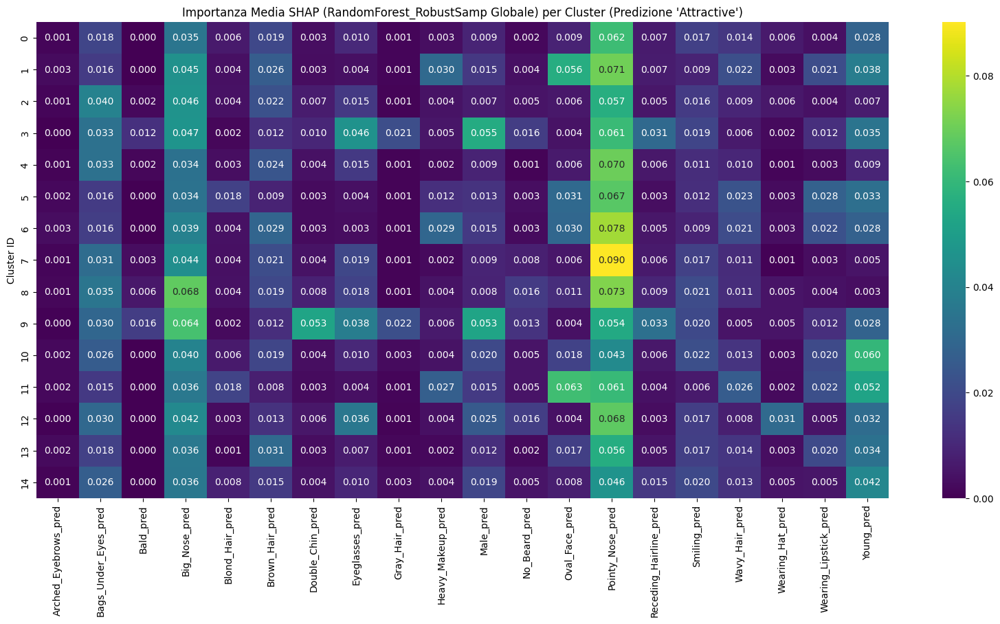

Analisi SHAP completata e/o caricata per RandomForest_RobustSamp.

==================== Analisi SHAP per Modello: LogReg_RobustSamp ====================
Caricamento modello LogReg_RobustSamp da /content/drive/MyDrive/Data Analytics for Business/Progetto/trained_models/attractive_pred_robust_samp_LogReg_RobustSamp.joblib...
Modello LogReg_RobustSamp caricato.
Caricamento dati SHAP (LogReg_RobustSamp_robust_sampling) da /content/drive/MyDrive/Data Analytics for Business/Progetto/evaluation_results/attractive_pred_robust_samp_LogReg_RobustSamp_shap_comparison_robust_sampling.csv
Dati SHAP per LogReg_RobustSamp caricati.


--- Confronto Importanza Media Assoluta SHAP (LogReg_RobustSamp Globale) tra Cluster (caricato) ---


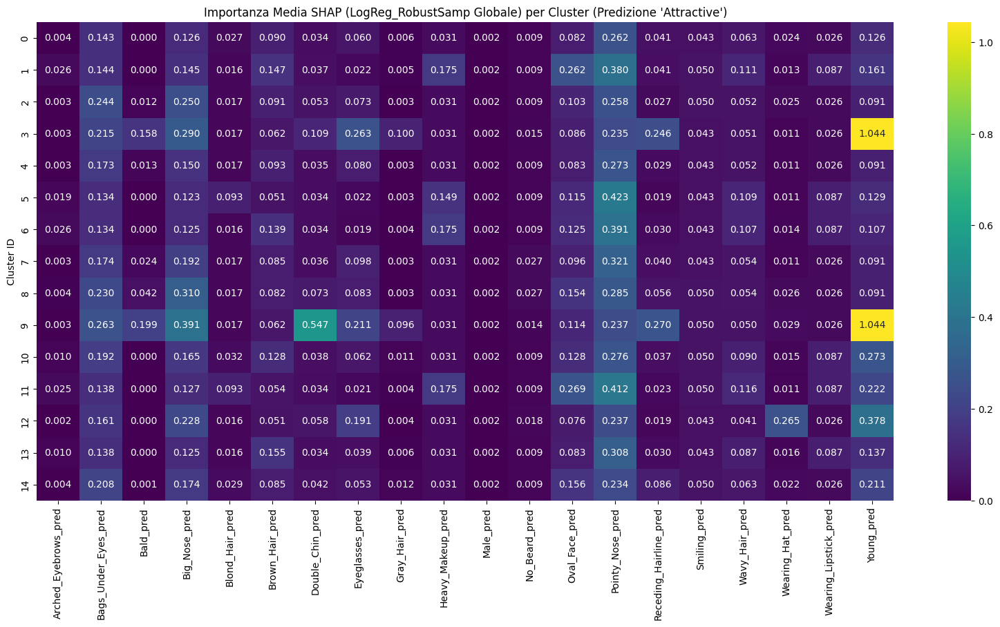

Analisi SHAP completata e/o caricata per LogReg_RobustSamp.

--- Analisi SHAP Conclusa ---


In [103]:

# --- BLOCCO PRINCIPALE DI ESECUZIONE PER SOLO SHAP ---
# Assicurati che PROJECT_PATH, MODELS_DIR, RESULTS_DIR, SHAP_PLOTS_DIR,
# cluster_test_sets_robust, X_train_g, current_feature_columns_for_experiment,
# e attractive_ground_truth_map (necessaria implicitamente da prepare_... se non già fatto)
# siano definite correttamente.

# Esempio di definizione delle variabili globali se non già presenti:
# PROJECT_PATH = "/content/drive/MyDrive/Data Analytics for Business/Progetto"
# MODELS_DIR = "trained_models"
# RESULTS_DIR = "evaluation_results"
# SHAP_PLOTS_DIR = "shap_plots"
FORCE_RECALCULATE_SHAP = False # Metti a True per forzare il ricalcolo di SHAP

os.makedirs(os.path.join(PROJECT_PATH, RESULTS_DIR), exist_ok=True)
os.makedirs(os.path.join(PROJECT_PATH, SHAP_PLOTS_DIR), exist_ok=True)
os.makedirs(os.path.join(PROJECT_PATH, MODELS_DIR), exist_ok=True)

# 1. Definisci i modelli da spiegare e i loro prefissi di file
models_to_explain_config = {
    "RandomForest_RobustSamp": {"prefix": "attractive_pred_robust_samp"},
    "LogReg_RobustSamp": {"prefix": "attractive_pred_robust_samp"},
    # "NeuralNetworkKeras_RobustSamp": {"prefix": "attractive_pred_nn_robust_samp"} # Aggiungi se hai il modello
}

# 2. Verifica prerequisiti fondamentali
if 'X_train_g' not in locals() or X_train_g is None or \
   (isinstance(X_train_g, pd.DataFrame) and X_train_g.empty) or \
   (not isinstance(X_train_g, pd.DataFrame) and X_train_g.size == 0):
    print("ERRORE CRITICO: X_train_g non disponibile o vuoto. Necessario per il background di SHAP.")
    # exit()
elif 'cluster_test_sets_robust' not in locals() or not cluster_test_sets_robust:
    print("ERRORE CRITICO: 'cluster_test_sets_robust' non disponibile o vuoto.")
    # exit()
elif 'current_feature_columns_for_experiment' not in locals() or not current_feature_columns_for_experiment:
    print("ERRORE CRITICO: 'current_feature_columns_for_experiment' non disponibile o vuoto.")
    # exit()
else:
    print("\n--- Avvio Analisi SHAP per i Modelli Caricati ---")
    if not isinstance(X_train_g, pd.DataFrame):
        X_train_g_df_for_shap = pd.DataFrame(X_train_g, columns=current_feature_columns_for_experiment)
    else:
        X_train_g_df_for_shap = X_train_g.copy()

    for model_name, config in models_to_explain_config.items():
        prefix = config["prefix"]
        model_path = os.path.join(PROJECT_PATH, MODELS_DIR, f"{prefix}_{model_name}.joblib")

        if os.path.exists(model_path):
            print(f"\n{'='*20} Analisi SHAP per Modello: {model_name} {'='*20}")
            print(f"Caricamento modello {model_name} da {model_path}...")
            try:
                model_instance = joblib.load(model_path)
                print(f"Modello {model_name} caricato.")

                df_shap_comparison = get_shap_explanations_for_clusters(
                    model=model_instance,
                    model_name=model_name,
                    X_train_global_for_explainer=X_train_g_df_for_shap,
                    test_sets_per_cluster=cluster_test_sets_robust,
                    feature_cols=current_feature_columns_for_experiment,
                    project_path=PROJECT_PATH,
                    results_filename_prefix=prefix,
                    force_recalculate=FORCE_RECALCULATE_SHAP
                )
                if df_shap_comparison is not None and not df_shap_comparison.empty:
                    print(f"Analisi SHAP completata e/o caricata per {model_name}.")
                else:
                    print(f"Analisi SHAP per {model_name} non ha prodotto risultati significativi o è stata saltata.")
            except Exception as e_load_shap:
                print(f"Errore durante il caricamento del modello {model_name} o l'esecuzione di SHAP: {e_load_shap}")
        else:
            print(f"Modello {model_name} non trovato in {model_path}. Impossibile eseguire SHAP.")
    print("\n--- Analisi SHAP Conclusa ---")


**Considerazioni finali su SHAP e metriche (modelli con Robust Sampling)**

Le heatmap SHAP evidenziano che alcune feature, come "Young_pred", hanno avuto un impatto fortemente positivo e costante nella maggior parte dei cluster. Questo indica che la giovinezza percepita è considerata un fattore determinante dai modelli per classificare un volto come attraente. Al contrario, "Male_pred" tende ad avere un’influenza negativa nelle predizioni, coerentemente con la correlazione osservata con l’attributo target.

In generale, alcune feature si sono dimostrate poco influenti, come "Bald_pred", "Wearing_Hat_pred" o "Arched_Eyebrows_pred", suggerendo che il loro contributo è stato trascurabile in molti cluster. Tuttavia, l'importanza delle feature varia sensibilmente da cluster a cluster: ad esempio, "Pointy_Nose_pred" si conferma rilevante in più cluster nella Random Forest, mentre "Heavy_Makeup_pred" e "Wearing_Lipstick_pred" risultano particolarmente significative nella Logistic Regression, ma solo in gruppi specifici. Queste differenze riflettono il diverso modo in cui i modelli apprendono le relazioni tra attributi e outcome, con la Logistic Regression che tende a produrre valori SHAP più elevati ma meno capaci di cogliere interazioni complesse rispetto alla Random Forest.

Un aspetto cruciale emerso dall’analisi riguarda la fairness. La variabilità dell’importanza delle feature tra i cluster suggerisce che i modelli non applicano criteri uniformi per valutare l’attrattività. Se i cluster identificano implicitamente sottogruppi demografici (ad esempio in base a età o genere), e se le performance o l’importanza delle feature cambiano in modo significativo tra questi gruppi, si può parlare di bias. È il caso, ad esempio, di cluster in cui le caratteristiche più influenti sono fortemente legate a stereotipi (come l’uso del trucco per le donne), rendendo il comportamento del modello potenzialmente iniquo.

Infine, nei cluster più difficili e sbilanciati, come il Cluster 3, è emerso come i modelli abbiano difficoltà a riconoscere correttamente i casi positivi ("Attractive=1"), anche dopo l’uso dell’undersampling in fase di training. Questo fenomeno, insieme alla forte influenza di feature negative (es. "Eyeglasses_pred", "Receding_Hairline_pred"), ha contribuito a un F1-score particolarmente basso per la classe positiva, nonostante una separazione complessiva accettabile (AUC ≈ 0.79). Tali risultati indicano che, pur avendo appreso segnali utili, i modelli faticano a generalizzare correttamente nei cluster con distribuzioni più sfavorevoli.

Questa analisi conferma che l’attributo "Attractive" è predetto sulla base di segnali complessi e talvolta non equamente distribuiti.